# Introduction
This contains code that is taken from the references below and added it my own comments or tweaks in my journey to understand how the transformer works and the intuition behind it.

* [Building Large Language model from scratch](https://github.com/rasbt/LLMs-from-scratch)
* https://jax-ml.github.io/scaling-book/transformers/

All the images are taken from [Building Large Language model from scratch](https://github.com/rasbt/LLMs-from-scratch)

In [1]:
%pip install torch -U
%pip install treescope
%pip install tiktoken

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [2]:
import treescope
treescope.register_as_default()
treescope.active_autovisualizer.set_globally(treescope.ArrayAutovisualizer())
## both set up Treescope as the default pretty printer and enable automatic array visualization
# treescope.basic_interactive_setup(autovisualize_arrays=True)


In [3]:
import torch

def get_device() -> str:
    if torch.mps.is_available():
        return "mps"
    if torch.cuda.is_available():
        return "cuda"
    return "cpu"

device = get_device()
print(f'using {device=}')

using device='mps'


## The link betwwen vocab size, d_model

`vocab_size` and `d_input` (more commonly called `d_model` or `embedding_dim`) are two independent hyperparameters that define the **shape of the embedding layer matrix**, which is the very first component that processes input tokens.

Let's break this down.

---

### 1. Defining the Terms

#### `vocab_size` (Vocabulary Size)
*   **What it is:** The total number of unique tokens (words, sub-words, or characters) that the model knows.
*   **How it's determined:** It's determined by the **tokenizer** which is trained on a large corpus of text. The tokenizer breaks down text into these tokens and builds a dictionary mapping each unique token to a unique integer ID.
*   **Example:** If your vocabulary is `{"<pad>": 0, "the": 1, "cat": 2, "sat": 3}`, your `vocab_size` is 4.
*   **Role:** It defines the **set of possible inputs**. A sentence like "the cat sat" is converted into a sequence of integer IDs: `[1, 2, 3]`. This sequence of integers is the actual input that goes into the model.

#### `d_input` (Input Dimension)

> **Important Clarification:** In the context of a transformer's first layer, `d_input` is almost always referred to as `d_model` or `embedding_dim`. This is the dimension of vectors *inside* the transformer. We will use `d_model` from here on as it's the standard term from the "Attention Is All You Need" paper.

*   **What it is:** The length of the dense vector used to represent each token from the vocabulary. It is the dimensionality of the model's internal working space.
*   **How it's determined:** It's a **design choice** and a key **hyperparameter** of the model. It's not determined by the data.
    *   `BERT-base`: `d_model = 768`
    *   `BERT-large`: `d_model = 1024`
    *   `GPT-3`: `d_model = 12288`
*   **Role:** It determines the **capacity** or **richness** of the token representations. A larger `d_model` allows the model to encode more nuanced semantic information into each token's vector, but it also makes the model larger and more computationally expensive.

---

### 2. The Link: The Embedding Layer

The embedding layer is the bridge that connects the world of discrete token IDs to the world of continuous, meaningful vectors.

Conceptually, the embedding layer is a simple **lookup table** or a **matrix**.

*   This matrix has a shape of: `(vocab_size, d_model)`

Here’s how it works:

1.  **Input:** The model receives a token ID, for example, the ID for "cat" which is `2`.
2.  **Lookup:** The model uses this ID as an index to look up the corresponding row in the embedding matrix. It goes to **row `2`** of the `(vocab_size, d_model)` matrix.
3.  **Output:** The output is the vector found at that row. This vector has a length of `d_model`.

So, the embedding layer performs a mapping: **`Integer ID → Dense Vector`**.



This output vector is the initial representation of the token "cat". It's this sequence of vectors (one for each token in the input sentence) that then gets passed through the rest of the transformer's layers (self-attention, feed-forward networks, etc.). The values in this embedding matrix are learned during the model's training process.

---

### 3. The Relationship: Independent but Related by Design

`vocab_size` and `d_model` do **not** determine each other, but they are critically related in model design:

*   **They are independent hyperparameters:** You choose `vocab_size` based on your language and tokenization strategy. You choose `d_model` based on your desired model capacity and computational budget.
*   **They jointly determine the size of the embedding layer:** The number of parameters in the embedding layer is `vocab_size * d_model`. This is often one of the largest parts of a transformer model in terms of parameter count.
    *   **Example:** For `BERT-base` with `vocab_size ≈ 30,000` and `d_model = 768`, the embedding layer alone has `30,000 * 768 ≈ 23 million` parameters.

### PyTorch Code Example

This makes the relationship crystal clear.


### Summary Table

| Concept | `vocab_size` | `d_model` (`d_input`) |
| :--- | :--- | :--- |
| **What it is** | Number of unique tokens in the dictionary | Dimension of the vector representing a token |
| **Determined by** | Tokenizer and training data | Model designer (hyperparameter) |
| **Represents** | *How many* things the model can recognize | *How richly* each thing can be described |
| **Typical Value** | 30,000 - 100,000+ | 512, 768, 1024, ... |
| **The "Link"** | They are the two dimensions of the **Embedding Matrix**: `(vocab_size, d_model)` |

In [4]:
import torch
import torch.nn as nn

# --- Hyperparameters ---
# 1. Determined by the tokenizer and training data
vocab_size = 30522  # A common vocab size for BERT

# 2. A model design choice (hyperparameter)
d_model = 768       # The dimensionality for BERT-base

# --- The Link: The Embedding Layer ---
# This layer is a matrix of shape (vocab_size, d_model)
embedding_layer = nn.Embedding(num_embeddings=vocab_size, embedding_dim=d_model)

print(f"Shape of the embedding layer's weight matrix: {embedding_layer.weight.shape}")
# Output: Shape of the embedding layer's weight matrix: torch.Size([30522, 768])

# --- Let's see it in action ---
# An input sentence tokenized into IDs (batch_size=1, sequence_length=5)
# e.g., "This is a sentence." -> [101, 2023, 2003, 1037, 2364]
input_ids = torch.tensor([[101, 2023, 2003, 1037, 2364]])
print(f"\nShape of input IDs: {input_ids.shape}")
# Output: Shape of input IDs: torch.Size([1, 5])

# Pass the IDs through the embedding layer
output_embeddings = embedding_layer(input_ids)
print(f"Shape of output embeddings: {output_embeddings.shape}")
# Output: Shape of output embeddings: torch.Size([1, 5, 768])
# This is (batch_size, sequence_length, d_model)


Shape of the embedding layer's weight matrix: torch.Size([30522, 768])

Shape of input IDs: torch.Size([1, 5])
Shape of output embeddings: torch.Size([1, 5, 768])


# Reminder of the Matrix Multiplications

## Part 1: "The cost of one matrix multiplication 


`(M, K) @ (K, N)` is approximately `2 * M * K * N` FLOPs.

Let's understand why this is true with a simple example.

A **FLOP** is a **FLoating-point OPeration**, like a single multiplication or a single addition.

Imagine we are multiplying a matrix **A** (shape `M x K`) by a matrix **B** (shape `K x N`) to get a result matrix **C** (shape `M x N`).

`C = A @ B`

Let's use concrete numbers: `M=2`, `K=3`, `N=4`.
*   Matrix **A** has shape `(2, 3)`
*   Matrix **B** has shape `(3, 4)`
*   The resulting matrix **C** will have shape `(2, 4)`

```
      [b11, b12, b13, b14]
      [b21, b22, b23, b24]
      [b31, b32, b33, b34]  (3x4 matrix B)
      --------------------
[a11, a12, a13]   [c11, c12, c13, c14]
[a21, a22, a23]   [c21, c22, c23, c24]
(2x3 matrix A)    (2x4 matrix C)
```

**How do we calculate just one element of the output, say `c11`?**

We take the first row of **A** and the first column of **B** and compute their dot product:
`c11 = (a11 * b11) + (a12 * b21) + (a13 * b31)`

Now, let's count the operations for this single element `c11`:
*   We have **3 multiplications** (`a11*b11`, `a12*b21`, `a13*b31`).
*   We have **2 additions** to sum them up.

In general, for a dot product of two vectors of length `K`, you perform `K` multiplications and `K-1` additions. For simplicity in complexity analysis, we approximate `K-1` additions as `K` additions.

So, for **one element** of the output matrix, we perform:
*   `K` multiplications
*   `K` additions
*   Total operations = `K + K = 2 * K` FLOPs.

**Now, how many total elements are in the output matrix C?**

The output matrix C has shape `(M, N)`, so it has `M * N` total elements.

**Putting it all together:**

*   Total FLOPs = (Number of elements in the output) × (FLOPs per output element)
*   Total FLOPs = `(M * N) * (2 * K)`
*   Total FLOPs = **`2 * M * K * N`**

This is the standard formula for the computational cost of a matrix multiplication.

---

## Part 2: Batch included

Now let's apply this formula to your `CausalAttention` code.

The line of code is `query = self.w_query(x)`.

*   `x` is your input tensor with shape `(B, T, C_in)`.
    *   `B` = `batch_size`
    *   `T` = `seq_length`
    *   `C_in` = `d_in` (input feature dimension)
*   `self.w_query` is a `nn.Linear` layer. Its internal weight matrix has a shape of `(d_out, d_in)`, which is `(C_out, C_in)`.

When you apply a linear layer in PyTorch to a 3D tensor like `(B, T, C_in)`, PyTorch is smart. It applies the same matrix multiplication to each of the `T` vectors for all `B` items in the batch.

You can think of it in two ways:

**1. The "Looping" View (Conceptual):**
Imagine you have `B` separate sequences. For just **one** sequence in the batch, the input `x` has a shape `(T, C_in)`. The linear layer `w_query` effectively multiplies this `(T, C_in)` matrix by the (transposed) weight matrix of shape `(C_in, C_out)`.

Let's match this to our `M, K, N` formula for a single sequence:
*   The first matrix has shape `(T, C_in)` -> `M=T`, `K=C_in`
*   The second matrix has shape `(C_in, C_out)` -> `K=C_in`, `N=C_out`

Using the formula `2 * M * K * N`, the cost for **one sequence** is `2 * T * C_in * C_out`.

Since you have a batch of `B` such sequences, and the operations are independent, the total cost is just `B` times the cost of one:
**Total Cost = `B * (2 * T * C_in * C_out)`**

**2. The "Batched Matrix Multiplication" View (How it's actually done):**
Modern libraries like PyTorch don't use loops. They use highly optimized batched operations. The input `x` of shape `(B, T, C_in)` is treated as a batch of `B` matrices, each of size `(T, C_in)`. This is then multiplied by the weight matrix. The result is `B` separate `(T, C_out)` matrices, stacked together into the final output shape `(B, T, C_out)`. The total number of computations is exactly the same, just performed much more efficiently on the GPU.


## The Matrix Multiplication Rule

When you perform a batched matrix multiplication (`@`) on tensors with shapes `(B, M, K)` and `(B, K, N)`, the rule is:
*   The batch dimension `B` must match.
*   The inner dimensions (`K` and `K`) must match. This dimension is "summed over" or "contracted" during the multiplication.
*   The resulting tensor's shape will be `(B, M, N)`.

## Einsum Notation
The einsum notation for that batched matrix multiplication is 'bmk,bkn->bmn'.
Here’s the breakdown of that notation:

* bmk,bkn: This part describes the input tensors.

* The first tensor has dimensions b (batch), m (rows), and k (columns).

* The second tensor has dimensions b (batch), k (rows), and n (columns).

* ->bmn: This part describes the desired output tensor.

The Logic: The dimension k appears in both input tensors but not in the output. This tells einsum to sum over (or contract) that dimension. The dimensions b, m, and n are all present in the output, so they are preserved.

In [5]:
import torch

# Define the dimensions for our tensors
B = 10  # Batch size
M = 3   # Rows of the first matrix
K = 4   # The common "inner" dimension
N = 5   # Columns of the second matrix

# Create two random tensors with the specified shapes
tensor1 = torch.randn(B, M, K)
tensor2 = torch.randn(B, K, N)

print(f"Shape of tensor 1: {tensor1.shape}") # (10, 3, 4)
print(f"Shape of tensor 2: {tensor2.shape}") # (10, 4, 5)
print("-" * 20)

# --- Using einsum ---
# 'bmk,bkn->bmn' tells einsum:
# b: batch dimension (keep)
# m: rows from tensor1 (keep)
# n: columns from tensor2 (keep)
# k: inner dimension (sum over and remove)
einsum_output = torch.einsum('bmk,bkn->bmn', tensor1, tensor2)

print(f"Output shape using einsum: {einsum_output.shape}") # (10, 3, 5)

# --- Using standard matrix multiplication for comparison ---
matmul_output = tensor1 @ tensor2 # The @ operator handles batching automatically

print(f"Output shape using @:    {matmul_output.shape}") # (10, 3, 5)

# Verify that the results are identical
print(f"\nAre the results the same? {torch.allclose(einsum_output, matmul_output)}")

Shape of tensor 1: torch.Size([10, 3, 4])
Shape of tensor 2: torch.Size([10, 4, 5])
--------------------
Output shape using einsum: torch.Size([10, 3, 5])
Output shape using @:    torch.Size([10, 3, 5])

Are the results the same? True


## Summary

The sentence combines these two ideas:
1.  It states the general formula for the cost of a single matrix multiplication (`2 * M * K * N`).
2.  It applies this formula to your specific case by identifying `M=T`, `K=C_in`, `N=C_out`, and then accounts for the batch dimension `B` by multiplying the result, leading to a final cost of `2 * B * T * C_in * C_out` for each of the Q, K, and V projections.

Let's break down the cost analysis of the `forward` method step-by-step, focusing on both **computational complexity (FLOPs)** and **memory complexity**.

# SelfAttention implementation

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch03_compressed/18.webp" style="max-width: 60%; height: auto; display: block;">

In [6]:
class SelfAttention(nn.Module):
    def __init__(self, d_in: int, d_out: int, bias: bool):
        super().__init__()
        self.wq = nn.Linear(in_features=d_in, out_features=d_out, bias=bias).to(device)
        self.wk = nn.Linear(in_features=d_in, out_features=d_out, bias=bias).to(device)
        self.wv = nn.Linear(in_features=d_in, out_features=d_out, bias=bias).to(device)

    def forward(self, x):
        keys = self.wk(x)
        queries = self.wq(x)
        values = self.wv(x)
        attn_scores = queries @ keys.T
        context_vect = torch.softmax(attn_scores / (keys.shape[-1] ** 0.5), dim=-1)
        return context_vect @ values 

## Softmax refresher 
The softmax formula converts a vector of numbers, often called logits, into a probability distribution. For a vector z with K elements, the softmax value for the i-th element is:

$ \text{Softmax}(z)_i = \frac{e^{z_i}}{\sum_{j=1}^{K} e^{z_j}} $
​

How It Works
In simpler terms, for each number in the input vector, the formula does two things:

Exponentiates it: It calculates e (Euler's number, ~2.718) raised to the power of that number. This step makes all the output values positive.

Normalizes it: It divides the result by the sum of all the exponentiated values in the vector. This ensures that all the new values add up to 1, just like a probability distribution.

The result is a new vector where larger input numbers correspond to higher probabilities, and all the output probabilities sum to 1.

In [7]:
x = torch.tensor(
  [[0.43, 0.15, 0.89], # Your     (x^1)
   [0.55, 0.87, 0.66], # journey  (x^2)
   [0.57, 0.85, 0.64], # starts   (x^3)
   [0.22, 0.58, 0.33], # with     (x^4)
   [0.77, 0.25, 0.10], # one      (x^5)
   [0.05, 0.80, 0.55]] # step     (x^6)
).to(device)
print(x.shape)
# d_in is the shape[1] of the input x here which is 3
self_attention = SelfAttention(d_in=x.shape[1], d_out=2, bias=False)
print(self_attention)
att = self_attention.forward(x)
print(att)
att

torch.Size([6, 3])
SelfAttention(
  (wq): Linear(in_features=3, out_features=2, bias=False)
  (wk): Linear(in_features=3, out_features=2, bias=False)
  (wv): Linear(in_features=3, out_features=2, bias=False)
)
tensor([[ 0.3384, -0.6828],
        [ 0.3392, -0.6838],
        [ 0.3392, -0.6838],
        [ 0.3407, -0.6849],
        [ 0.3413, -0.6844],
        [ 0.3400, -0.6847]], device='mps:0', grad_fn=<MmBackward0>)


/Users/charbelk/dev/understanding_transformer/venv/lib/python3.12/site-packages/treescope/external/torch_support.py:182: UserWarning: The .grad attribute of a Tensor that is not a leaf Tensor is being accessed. Its .grad attribute won't be populated during autograd.backward(). If you indeed want the .grad field to be populated for a non-leaf Tensor, use .retain_grad() on the non-leaf Tensor. If you access the non-leaf Tensor by mistake, make sure you access the leaf Tensor instead. See github.com/pytorch/pytorch/pull/30531 for more informations. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/build/aten/src/ATen/core/TensorBody.h:494.)
  array_grad = array.grad


tensor([[ 0.3384, -0.6828],
        [ 0.3392, -0.6838],
        [ 0.3392, -0.6838],
        [ 0.3407, -0.6849],
        [ 0.3413, -0.6844],
        [ 0.3400, -0.6847]], device='mps:0', grad_fn=<MmBackward0>)

## Masking

We want the model to only attend to the current and previous inputs in a sequence. Otherwise, we would be leaking information during training.
<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch03_compressed/19.webp" style="max-width: 80%; height: auto; display: block;">

we can mask the unnormalized attention scores above the diagonal with negative infinity before they enter the softmax function:

In [8]:
context_length = 6 
ones = torch.ones(context_length, context_length)
print("ones:\n", ones)
mask = torch.triu(ones, diagonal=1)
print("mask:\n", mask)
infinity_mask = mask.masked_fill(mask.bool(), -torch.inf)
print("infinity_mask:\n", infinity_mask)
softmax_inifinty_mask = torch.softmax(infinity_mask, dim=-1)
print("softmax_inifinty_mask:\n")

softmax_inifinty_mask

ones:
 tensor([[1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1.]])
mask:
 tensor([[0., 1., 1., 1., 1., 1.],
        [0., 0., 1., 1., 1., 1.],
        [0., 0., 0., 1., 1., 1.],
        [0., 0., 0., 0., 1., 1.],
        [0., 0., 0., 0., 0., 1.],
        [0., 0., 0., 0., 0., 0.]])
infinity_mask:
 tensor([[0., -inf, -inf, -inf, -inf, -inf],
        [0., 0., -inf, -inf, -inf, -inf],
        [0., 0., 0., -inf, -inf, -inf],
        [0., 0., 0., 0., -inf, -inf],
        [0., 0., 0., 0., 0., -inf],
        [0., 0., 0., 0., 0., 0.]])
softmax_inifinty_mask:



tensor([[1.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.5000, 0.5000, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.3333, 0.3333, 0.3333, 0.0000, 0.0000, 0.0000],
        [0.2500, 0.2500, 0.2500, 0.2500, 0.0000, 0.0000],
        [0.2000, 0.2000, 0.2000, 0.2000, 0.2000, 0.0000],
        [0.1667, 0.1667, 0.1667, 0.1667, 0.1667, 0.1667]])

In [9]:
class SelfAttentionMasking(nn.Module):
    def __init__(self, d_in: int, d_out: int, bias: bool, context_length: int):
        super().__init__()
        self.wq = nn.Linear(in_features=d_in, out_features=d_out, bias=bias)
        self.wk = nn.Linear(in_features=d_in, out_features=d_out, bias=bias)
        self.wv = nn.Linear(in_features=d_in, out_features=d_out, bias=bias)
        self.mask = torch.triu(torch.ones(context_length, context_length), diagonal=1)

    def forward(self, x):
        keys = self.wk(x)
        queries = self.wq(x)
        values = self.wv(x)
        attn_scores = queries @ keys.T
        masked_att_scores = attn_scores.masked_fill(mask.bool(), -torch.inf)
        context_vect = torch.softmax(masked_att_scores / (keys.shape[-1] ** 0.5), dim=-1)
        return context_vect @ values 

In [10]:
x = torch.tensor(
  [[0.43, 0.15, 0.89], # Your     (x^1)
   [0.55, 0.87, 0.66], # journey  (x^2)
   [0.57, 0.85, 0.64], # starts   (x^3)
   [0.22, 0.58, 0.33], # with     (x^4)
   [0.77, 0.25, 0.10], # one      (x^5)
   [0.05, 0.80, 0.55]] # step     (x^6)
)
print(x.shape)
# d_in is the shape[1] of the input x here which is 3
self_attention = SelfAttentionMasking(d_in=x.shape[1], d_out=2, bias=False, context_length=1)
print(self_attention)
att = self_attention.forward(x)
print(att)

att

torch.Size([6, 3])
SelfAttentionMasking(
  (wq): Linear(in_features=3, out_features=2, bias=False)
  (wk): Linear(in_features=3, out_features=2, bias=False)
  (wv): Linear(in_features=3, out_features=2, bias=False)
)
tensor([[0.5819, 0.1805],
        [0.3496, 0.1512],
        [0.2804, 0.1396],
        [0.2069, 0.1229],
        [0.2229, 0.0923],
        [0.1611, 0.0988]], grad_fn=<MmBackward0>)


tensor([[0.5819, 0.1805],
        [0.3496, 0.1512],
        [0.2804, 0.1396],
        [0.2069, 0.1229],
        [0.2229, 0.0923],
        [0.1611, 0.0988]], grad_fn=<MmBackward0>)

## Dropout

During Training only, we apply the dropout technique which randomly selected hidden layer units are ignored. This method helps prevent overfitting by ensuring that a model does not become overly reliant on the any specific set of hidden layer units. It is applied after calculating the attention weights or after applying the attention weights to the value vectors.

To compensate of the reduction in active elements, the values of the remaining elements in the matrix are scaled by a factor $ \frac{1}{dropout\,rate} $. Example if the dropout rate was 50%, 0.5 then the scaled factor would be $\frac{1}{0.5} = 2$

Different, random set of attention weights is dropped during each training step.



In [11]:
print("x before dropout:\n", x)
dropout = nn.Dropout(p=0.5)
dropout_x = dropout(x)
print("x after dropout and with remaining scaled:\n", dropout_x)

dropout_x

x before dropout:
 tensor([[0.4300, 0.1500, 0.8900],
        [0.5500, 0.8700, 0.6600],
        [0.5700, 0.8500, 0.6400],
        [0.2200, 0.5800, 0.3300],
        [0.7700, 0.2500, 0.1000],
        [0.0500, 0.8000, 0.5500]])
x after dropout and with remaining scaled:
 tensor([[0.8600, 0.0000, 1.7800],
        [1.1000, 0.0000, 1.3200],
        [0.0000, 1.7000, 1.2800],
        [0.4400, 0.0000, 0.6600],
        [0.0000, 0.0000, 0.0000],
        [0.0000, 1.6000, 1.1000]])


tensor([[0.8600, 0.0000, 1.7800],
        [1.1000, 0.0000, 1.3200],
        [0.0000, 1.7000, 1.2800],
        [0.4400, 0.0000, 0.6600],
        [0.0000, 0.0000, 0.0000],
        [0.0000, 1.6000, 1.1000]])

## Handle batches

We want to make sure that our code handle batches, for simplicity we will stack the inputs


In [12]:
batch = torch.stack((x, x), dim=0)
batch.shape
print(batch)
batch

tensor([[[0.4300, 0.1500, 0.8900],
         [0.5500, 0.8700, 0.6600],
         [0.5700, 0.8500, 0.6400],
         [0.2200, 0.5800, 0.3300],
         [0.7700, 0.2500, 0.1000],
         [0.0500, 0.8000, 0.5500]],

        [[0.4300, 0.1500, 0.8900],
         [0.5500, 0.8700, 0.6600],
         [0.5700, 0.8500, 0.6400],
         [0.2200, 0.5800, 0.3300],
         [0.7700, 0.2500, 0.1000],
         [0.0500, 0.8000, 0.5500]]])


tensor([[[0.4300, 0.1500, 0.8900],
         [0.5500, 0.8700, 0.6600],
         [0.5700, 0.8500, 0.6400],
         [0.2200, 0.5800, 0.3300],
         [0.7700, 0.2500, 0.1000],
         [0.0500, 0.8000, 0.5500]],

        [[0.4300, 0.1500, 0.8900],
         [0.5500, 0.8700, 0.6600],
         [0.5700, 0.8500, 0.6400],
         [0.2200, 0.5800, 0.3300],
         [0.7700, 0.2500, 0.1000],
         [0.0500, 0.8000, 0.5500]]])

## Note about transpose

In [13]:
x_t = x.T
print("x: ", x)
print("x transpose: ", x_t)
x

x:  tensor([[0.4300, 0.1500, 0.8900],
        [0.5500, 0.8700, 0.6600],
        [0.5700, 0.8500, 0.6400],
        [0.2200, 0.5800, 0.3300],
        [0.7700, 0.2500, 0.1000],
        [0.0500, 0.8000, 0.5500]])
x transpose:  tensor([[0.4300, 0.5500, 0.5700, 0.2200, 0.7700, 0.0500],
        [0.1500, 0.8700, 0.8500, 0.5800, 0.2500, 0.8000],
        [0.8900, 0.6600, 0.6400, 0.3300, 0.1000, 0.5500]])


tensor([[0.4300, 0.1500, 0.8900],
        [0.5500, 0.8700, 0.6600],
        [0.5700, 0.8500, 0.6400],
        [0.2200, 0.5800, 0.3300],
        [0.7700, 0.2500, 0.1000],
        [0.0500, 0.8000, 0.5500]])

In [14]:
x_t

tensor([[0.4300, 0.5500, 0.5700, 0.2200, 0.7700, 0.0500],
        [0.1500, 0.8700, 0.8500, 0.5800, 0.2500, 0.8000],
        [0.8900, 0.6600, 0.6400, 0.3300, 0.1000, 0.5500]])

In [15]:
print("batch: ", batch.shape)
batch_t_1_2 = batch.transpose(1, 2)
# print("batch transpose 1, 2: ", batch_t_1_2)
print("batch transpose 1, 2 shape: ", batch_t_1_2.shape)

batch:  torch.Size([2, 6, 3])
batch transpose 1, 2 shape:  torch.Size([2, 3, 6])


## CausalAttention 
putting everything together


In [16]:
class CausalAttention(nn.Module):
    def __init__(self, d_in, d_out, context_length, dropout, bias=False):
        super().__init__()
        self.d_out = d_out
        self.d_in = d_in
        self.w_query = nn.Linear(d_in, d_out, bias)
        self.w_key = nn.Linear(d_in, d_out, bias)
        self.w_value = nn.Linear(d_in, d_out, bias)
        self.dropout = nn.Dropout(dropout)
        # register buffer moves automatically to the appropriate device (cpu, gpu, or mps) along with the model. 
        self.register_buffer('mask', torch.triu(torch.ones(context_length, context_length), diagonal=1))

    def forward(self, x):
        batch_size, seq_length, d_in = x.shape
        print("W_query shape" , self.w_query.parameters)
        query = self.w_query(x)
        print("query shape" , query.shape)

        key = self.w_key(x)
        value = self.w_value(x)

        attn_scores = query @ key.transpose(1, 2) # Transpose dimensions 1,2 keeping the batch dimension at the first position 0
        attn_scores.masked_fill_(mask.bool()[:seq_length, :seq_length], -torch.inf)
        attn_weights = torch.softmax(attn_scores / key.shape[-1]**0.5, dim=-1)
        attn_weights = self.dropout(attn_weights)
        return attn_weights @ value



In [17]:
batch_size, seq_length, d_in = batch.shape
print(f'{batch_size=}')
print(f'{seq_length=}')
print(f'{d_in=}')
dropout = 0.5
d_out=2

batch_size=2
seq_length=6
d_in=3


In [18]:
ca = CausalAttention(d_in, d_out, seq_length,dropout)
result = ca.forward(batch)
print(result.shape)

W_query shape <bound method Module.parameters of Linear(in_features=3, out_features=2, bias=False)>
query shape torch.Size([2, 6, 2])
torch.Size([2, 6, 2])


## Multi Head attention
The term “multi-head” refers to dividing the attention mechanism into multiple
“heads,” each operating independently.

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch03_compressed/24.webp" style="max-width: 60%; height: auto; display: block;">

- We simply stack multiple single-head attention modules to obtain a multi-head attention module:

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch03_compressed/25.webp" style="max-width: 60%; height: auto; display: block;">

- The main idea behind multi-head attention is to run the attention mechanism multiple times (in parallel) with different, learned linear projections. This allows the model to jointly attend to information from different representation subspaces at different positions.

In [19]:
class MultiHeadAttentionWrapper(nn.Module):

    def __init__(self, d_in, d_out, context_length, dropout, num_heads, qkv_bias=False):
        super().__init__()
        self.heads = nn.ModuleList(
            [CausalAttention(d_in, d_out, context_length, dropout, qkv_bias) 
             for _ in range(num_heads)]
        )

    def forward(self, x):
        return torch.cat([head(x) for head in self.heads], dim=-1)


torch.manual_seed(123)

context_length = batch.shape[1] # This is the number of tokens
d_in, d_out = 3, 2
mha = MultiHeadAttentionWrapper(
    d_in, d_out, context_length, 0.0, num_heads=2
)

context_vecs = mha(batch)

print(context_vecs)
print("context_vecs.shape:", context_vecs.shape)

W_query shape <bound method Module.parameters of Linear(in_features=3, out_features=2, bias=False)>
query shape torch.Size([2, 6, 2])
W_query shape <bound method Module.parameters of Linear(in_features=3, out_features=2, bias=False)>
query shape torch.Size([2, 6, 2])
tensor([[[-0.4519,  0.2216,  0.4772,  0.1063],
         [-0.5874,  0.0058,  0.5891,  0.3257],
         [-0.6300, -0.0632,  0.6202,  0.3860],
         [-0.5675, -0.0843,  0.5478,  0.3589],
         [-0.5526, -0.0981,  0.5321,  0.3428],
         [-0.5299, -0.1081,  0.5077,  0.3493]],

        [[-0.4519,  0.2216,  0.4772,  0.1063],
         [-0.5874,  0.0058,  0.5891,  0.3257],
         [-0.6300, -0.0632,  0.6202,  0.3860],
         [-0.5675, -0.0843,  0.5478,  0.3589],
         [-0.5526, -0.0981,  0.5321,  0.3428],
         [-0.5299, -0.1081,  0.5077,  0.3493]]], grad_fn=<CatBackward0>)
context_vecs.shape: torch.Size([2, 6, 4])


## More efficient implementation

- While the above is an intuitive and fully functional implementation of multi-head attention (wrapping the single-head attention `CausalAttention` implementation from earlier), we can write a stand-alone class called `MultiHeadAttention` to achieve the same

- We don't concatenate single attention heads for this stand-alone `MultiHeadAttention` class
- Instead, we create single W_query, W_key, and W_value weight matrices and then split those into individual matrices for each attention head:

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch03_compressed/26.webp" style="max-width: 80%; height: auto; display: block;">

In [20]:
class MultiHeadAttention(nn.Module):
    def __init__(self, d_in, d_out, context_length, dropout, num_heads, qkv_bias=False):
        super().__init__()
        assert (d_out % num_heads == 0), \
            "d_out must be divisible by num_heads"

        self.d_out = d_out
        self.num_heads = num_heads
        self.head_dim = d_out // num_heads # Reduce the projection dim to match desired output dim

        self.W_query = nn.Linear(d_in, d_out, bias=qkv_bias)
        self.W_key = nn.Linear(d_in, d_out, bias=qkv_bias)
        self.W_value = nn.Linear(d_in, d_out, bias=qkv_bias)
        self.out_proj = nn.Linear(d_out, d_out)  # Linear layer to combine head outputs
        self.dropout = nn.Dropout(dropout)
        self.register_buffer(
            "mask",
            torch.triu(torch.ones(context_length, context_length),
                       diagonal=1)
        )

    def forward(self, x):
        b, num_tokens, d_in = x.shape
        # As in `CausalAttention`, for inputs where `num_tokens` exceeds `context_length`, 
        # this will result in errors in the mask creation further below. 
        # In practice, this is not a problem since the LLM (chapters 4-7) ensures that inputs  
        # do not exceed `context_length` before reaching this forwar

        keys = self.W_key(x) # Shape: (b, num_tokens, d_out)
        queries = self.W_query(x)
        values = self.W_value(x)

        # We implicitly split the matrix by adding a `num_heads` dimension
        # Unroll last dim: (b, num_tokens, d_out) -> (b, num_tokens, num_heads, head_dim)
        keys = keys.view(b, num_tokens, self.num_heads, self.head_dim) 
        values = values.view(b, num_tokens, self.num_heads, self.head_dim)
        queries = queries.view(b, num_tokens, self.num_heads, self.head_dim)

        # Transpose: (b, num_tokens, num_heads, head_dim) -> (b, num_heads, num_tokens, head_dim)
        keys = keys.transpose(1, 2)
        queries = queries.transpose(1, 2)
        values = values.transpose(1, 2)

        # Compute scaled dot-product attention (aka self-attention) with a causal mask
        attn_scores = queries @ keys.transpose(2, 3)  # Dot product for each head

        # Original mask truncated to the number of tokens and converted to boolean
        mask_bool = self.mask.bool()[:num_tokens, :num_tokens]

        # Use the mask to fill attention scores
        attn_scores.masked_fill_(mask_bool, -torch.inf)
        
        attn_weights = torch.softmax(attn_scores / keys.shape[-1]**0.5, dim=-1)
        attn_weights = self.dropout(attn_weights)

        # Shape: (b, num_tokens, num_heads, head_dim)
        context_vec = (attn_weights @ values).transpose(1, 2) 
        
        # Combine heads, where self.d_out = self.num_heads * self.head_dim
        context_vec = context_vec.contiguous().view(b, num_tokens, self.d_out)
        context_vec = self.out_proj(context_vec) # optional projection

        return context_vec

That transpose(1, 2) operation is done to group the attention heads with the batch dimension. This is a crucial step that allows the attention scores for all heads to be computed efficiently in parallel with a single matrix multiplication.

**The "Why"**

* The `@` operator for matrix multiplication in PyTorch works on the last two dimensions of a tensor. All the dimensions before those last two are treated as batch dimensions. The operation is then performed independently for each item in the batch.

Let's look at the shapes:

**Before Transpose:** The shape is `(b, num_tokens, num_heads, head_dim)`.

If we tried to do the matrix multiplication here, PyTorch would see `(b, num_tokens)` as the batch. This is incorrect. We don't want to perform attention within a token; we want to do it between tokens, separately for each head.

**After Transpose:** The shape becomes `(b, num_heads, num_tokens, head_dim)`.

Now, when we get to the attention calculation (`queries @ keys.transpose(2, 3))`, PyTorch sees (b, num_heads) as the batch dimensions.

This is exactly what we want! It tells the multiplication function: **"For each item in the batch, and for each head, perform an independent attention calculation on the (num_tokens, head_dim) matrices."**

In short, the transpose is a data reshaping trick to make sure the subsequent batched matrix multiplication computes the attention scores for all heads in one parallel, efficient shot.

In [21]:
torch.manual_seed(123)

batch_size, context_length, d_in = batch.shape
d_out = 2
mha = MultiHeadAttention(d_in, d_out, context_length, 0.0, num_heads=2)

context_vecs = mha(batch)

print(context_vecs)
print("context_vecs.shape:", context_vecs.shape)

tensor([[[0.3190, 0.4858],
         [0.2943, 0.3897],
         [0.2856, 0.3593],
         [0.2693, 0.3873],
         [0.2639, 0.3928],
         [0.2575, 0.4028]],

        [[0.3190, 0.4858],
         [0.2943, 0.3897],
         [0.2856, 0.3593],
         [0.2693, 0.3873],
         [0.2639, 0.3928],
         [0.2575, 0.4028]]], grad_fn=<ViewBackward0>)
context_vecs.shape: torch.Size([2, 6, 2])


* This implementation splits the input into multiple heads by reshaping the projected query, key, and value
tensors and then combines the results from these heads after computing attention.

* The splitting of the query, key, and value tensors is achieved through tensor reshaping and transposing operations using PyTorch’s .view and .transpose methods. The
input is first transformed (via linear layers for queries, keys, and values) and then
reshaped to represent multiple heads.

* The key operation is to split the d_out dimension into num_heads and head_dim,
where head_dim = d_out / num_heads. This splitting is then achieved using the .view
method: a tensor of dimensions (b, num_tokens, d_out) is reshaped to dimension
(b, num_tokens, num_heads, head_dim).

* The tensors are then transposed to bring the num_heads dimension before the num_
tokens dimension, resulting in a shape of (b, num_heads, num_tokens, head_dim). This
transposition is crucial for correctly aligning the queries, keys, and values across the
different heads and performing batched matrix multiplications efficiently.

## Cost of attention


### Notation

To make the analysis clear, let's define some variables based on the shapes in your code:

*   `B`: `batch_size`
*   `T`: `seq_length` (the context length, up to `context_length`)
*   `C_in`: `d_in` (the input embedding dimension)
*   `C_out`: `d_out` (the output dimension for Q, K, V, also known as the head dimension)

The input tensor `x` has the shape `(B, T, C_in)`.

---

### Step-by-Step Cost Analysis of `forward(self, x)`

We'll analyze each major operation within the `forward` pass.

#### 1. Projections to Q, K, V

*   **Code:**
    ```py
    query = self.w_query(x)
    key = self.w_key(x)
    value = self.w_value(x)
    ```
*   **Operation:** Three separate linear projections. A linear layer is essentially a matrix multiplication. The input `x` of shape `(B, T, C_in)` is multiplied by a weight matrix of shape `(C_out, C_in)`. PyTorch handles this efficiently for the batch.
*   **Shapes:**
    *   `x`: `(B, T, C_in)`
    *   `w_query.weight` (transposed): `(C_in, C_out)`
    *   `query`, `key`, `value`: `(B, T, C_out)`
*   **Computational Cost (FLOPs):** The cost of one matrix multiplication `(M, K) @ (K, N)` is approximately `2 * M * K * N` FLOPs. Here, for each of the `B` items in the batch, we are effectively multiplying a `(T, C_in)` matrix by `(C_in, C_out)`.
    *   Cost per projection: `B * (2 * T * C_in * C_out)`
    *   Total for Q, K, V: **`3 * (2 * B * T * C_in * C_out) = 6 * B * T * C_in * C_out`**
*   **Memory Cost:** We need to store the `query`, `key`, and `value` tensors.
    *   Total memory for Q, K, V: **`3 * B * T * C_out`**

#### 2. Attention Score Calculation

*   **Code:**
    ```py
    attn_scores = query @ key.transpose(1, 2)
    ```
*   **Operation:** This is the core of the attention mechanism: a batched matrix multiplication (BMM).
*   **Shapes:**
    *   `query`: `(B, T, C_out)`
    *   `key.transpose(1, 2)`: `(B, C_out, T)`
    *   `attn_scores`: `(B, T, T)`
*   **Computational Cost (FLOPs):** We are performing `B` independent multiplications of a `(T, C_out)` matrix by a `(C_out, T)` matrix.
    *   Cost: **`B * (2 * T * C_out * T) = 2 * B * T² * C_out`**
*   **Memory Cost:** We must create and store the `attn_scores` matrix.
    *   Memory for `attn_scores`: **`B * T²`**

**This is the most critical step.** Notice that both the computation and memory have a **quadratic dependence on the sequence length `T`**. This `T²` term is the primary bottleneck that makes standard attention expensive for long sequences.


### Memory Cost Operation

The line of code is:
`attn_scores = query @ key.transpose(1, 2)`

### The Shapes Before the Multiplication

1.  **`query` shape:** `(B, T, C_out)`
    *   `B`: Batch Size
    *   `T`: Sequence Length
    *   `C_out`: Head Dimension

2.  **`key` shape:** `(B, T, C_out)`
    *   First, we transpose the last two dimensions of the `key` tensor.
    *   **`key.transpose(1, 2)` shape:** `(B, C_out, T)`

### Applying the Matrix multiplication Rule to Our Case

Let's map our shapes to the `(B, M, K)` and `(B, K, N)` template:

*   `query` is `(B, T, C_out)`  =>  `B` is `B`, `M` is `T`, `K` is `C_out`
*   `key.transpose(1, 2)` is `(B, C_out, T)`  =>  `B` is `B`, `K` is `C_out`, `N` is `T`

The inner dimension `K` is `C_out`. This is the dimension that gets consumed by the multiplication.

The output shape, `(B, M, N)`, becomes **`(B, T, T)`**.

### The Intuitive Explanation

Think about what the `attn_scores` matrix represents. For each item in the batch, it stores a score for how much each token in the sequence should attend to every *other* token in the sequence.

*   `attn_scores[b, i, j]` is a single number that represents the similarity between the **i-th query vector** and the **j-th key vector**.

To calculate that single number, we take the dot product of the `i-th` query vector (length `C_out`) and the `j-th` key vector (length `C_out`). The `C_out` dimensions are used up to produce a single scalar value.

Since we do this for all `T` query vectors against all `T` key vectors, we end up with a `T x T` matrix of these scalar scores for each item in the batch.

The memory cost of a tensor is determined by its shape (the number of elements it contains).

*   The `attn_scores` tensor has the shape `(B, T, T)`.
*   Therefore, the total number of elements is `B * T * T = B * T²`.
*   **The `C_out` dimension is not part of the final `attn_scores` shape because it is the inner dimension that is summed over during the `query @ keyᵀ` matrix multiplication.** That is why it's "dropped" from the memory cost calculation for this specific tensor.

#### 3. Masking, Scaling, and Softmax

*   **Code:**
    ```py
    attn_scores.masked_fill_(...)
    attn_weights = torch.softmax(attn_scores / key.shape[-1]**0.5, dim=-1)
    ```
*   **Operation:** These are element-wise operations performed on the `(B, T, T)` `attn_scores` matrix.
*   **Computational Cost (FLOPs):**
    *   **Scaling:** `B * T²` divisions.
    *   **Masking:** `B * T²` comparisons/assignments (in-place).
    *   **Softmax:** Softmax involves `exp`, `sum`, and `div` for each row. The cost is proportional to the number of elements. Roughly `~3` operations per element along `dim=-1`. Total: `B * T * (c * T)`, so `O(B * T²)`.
*   **Overall Cost:** The total cost of this step is `O(B * T²)`, but with a smaller constant factor than the preceding matrix multiplication. It doesn't change the overall quadratic complexity.
*   **Memory Cost:** The `attn_weights` matrix has the same shape as `attn_scores`.
    *   Memory for `attn_weights`: **`B * T²`**

#### 4. Dropout

*   **Code:**
    ```py
    attn_weights = self.dropout(attn_weights)
    ```
*   **Operation:** Element-wise operation.
*   **Cost:** `O(B * T²)`, which is negligible compared to the matrix multiplications.

#### 5. Weighted Sum of Values

*   **Code:**
    ```py
    return attn_weights @ value
    ```
*   **Operation:** The final batched matrix multiplication.
*   **Shapes:**
    *   `attn_weights`: `(B, T, T)`
    *   `value`: `(B, T, C_out)`
    *   `output`: `(B, T, C_out)`
*   **Computational Cost (FLOPs):** We are performing `B` independent multiplications of a `(T, T)` matrix by a `(T, C_out)` matrix.
    *   Cost: **`B * (2 * T * T * C_out) = 2 * B * T² * C_out`**
*   **Memory Cost:** The final output tensor is created.
    *   Memory for output: **`B * T * C_out`**

---

### Summary Table

Let's summarize the dominant costs, assuming `C_in ≈ C_out = C` for simplicity.

| Step                     | Computational Cost (FLOPs)                    | Memory Cost (Dominant Tensor)           |
| ------------------------ | --------------------------------------------- | --------------------------------------- |
| 1. Q, K, V Projections   | `O(B * T * C²)`                               | `O(B * T * C)`                          |
| 2. Scores (`Q @ Kᵀ`)     | `O(B * T² * C)`                               | `O(B * T²)`                             |
| 3. Softmax, etc.         | `O(B * T²)`                                   | `O(B * T²)` (for `attn_weights`)         |
| 4. Output (`W @ V`)      | `O(B * T² * C)`                               | `O(B * T * C)` (final output)           |
| **Total (Dominant Term)**| **`O(B * T² * C)`**                           | **`O(B * T² + B * T * C)`**             |

### Key Takeaways and Conclusion

1.  **Quadratic Bottleneck:** The overall computational complexity is dominated by the two large matrix multiplications: `Q @ Kᵀ` and `attn_weights @ V`. Both are **`O(T²)`** with respect to the sequence length `T`. If you double the sequence length, the computation required for attention quadruples.

2.  **Memory Bottleneck:** The memory complexity is dominated by the need to store the `(B, T, T)` attention score/weight matrix. 
This is also **`O(T²)`**. For a batch size of 1, a sequence length of 64k (`65536`), and 4-byte floats, this matrix alone would require `1 * 65536 * 65536 * 4 bytes ≈ 17.2 GB` of GPU RAM, which is prohibitive for most hardware.

3.  **Linear Dependence on `C`:** The cost grows linearly with the embedding/head dimension `C`. This is much more manageable than the quadratic growth in `T`.

4.  **Why this matters:** This `O(T²)` complexity is the fundamental reason why standard Transformers struggle with very long sequences (e.g., entire books, high-resolution images, long audio clips). 
This has spurred an entire field of research into "Efficient Transformers" (e.g., Sparse Attention, Linear Attention, Longformer) and methods like **FlashAttention**, which cleverly reorder the computation to avoid ever creating and storing the full `T x T` matrix in GPU high-bandwidth memory (HBM), drastically reducing memory usage and speeding up the process.



## Do we need Multi-head attention?

The short answer is: **We need multi-head attention because a single "attention" mechanism is not powerful enough to capture the rich and varied relationships between words in a sentence.**

Think of it like having a **committee of experts** instead of just one generalist.

Let's break it down.

### 1. The Limitation of Single-Head Attention (The Generalist)

First, let's remember what attention does. It allows a model to weigh the importance of different words in a sequence when processing a specific word. For the sentence:

> "The animal didn't cross the street because **it** was too tired."

When processing the word "**it**", a single attention mechanism has to figure out which word "it" refers to. It would likely learn to put a high attention score on "animal".

But what if there are other important relationships in the sentence?
*   **Causal Relationship:** "didn't cross" is linked to "tired".
*   **Syntactic Relationship:** "The" is linked to "animal".
*   **Location Relationship:** "cross" is linked to "street".

A single attention mechanism has to learn a "one-size-fits-all" way of relating words. It has to average all these different types of relationships into a single set of attention scores. This is a huge bottleneck. It might be good at one thing (like pronoun resolution) but bad at another (like understanding causality), or it might just produce a blurry, averaged-out understanding of all of them.

---

### 2. How Multi-Head Attention Solves This (The Committee of Experts)

Multi-head attention doesn't just run the same attention process multiple times. Instead, it does something clever:

1.  **Split the Task:** It takes the original word embeddings and projects them into multiple, smaller-dimensional "subspaces." Each of these subspaces is a "head."
2.  **Assign Experts:** Each head gets its own set of Query (Q), Key (K), and Value (V) matrices. This is crucial. It means **each head can learn to focus on a different type of relationship independently and in parallel.**
3.  **Let the Experts Work:** Each head performs its own attention calculation, completely unaware of what the other heads are doing.
4.  **Combine the Insights:** The outputs from all the heads are concatenated together and passed through a final linear layer to produce the final output.

Let's revisit our sentence with an 8-head attention model:

> "The animal didn't cross the street because **it** was too tired."

When processing "**it**", the different heads might learn to focus on different things:

*   **Head 1 (Pronoun Expert):** Focuses on the relationship between "**it**" and "**animal**".
    

*   **Head 2 (Causality Expert):** Focuses on the relationship between "**tired**" and "**didn't cross**".
    

*   **Head 3 (Syntactic Expert):** Focuses on the relationship between words and their immediate neighbors or grammatical structure, like linking "too" to "tired".
    

*   **Head 4 (Verb-Object Expert):** Might link verbs to their objects, like "**cross**" to "**street**".

*   ...and so on for the other heads.

The model doesn't have to choose between understanding grammar or understanding meaning. It can do both simultaneously.

---

### Key Benefits of Multi-Head Attention

1.  **Ability to Attend to Multiple Relationships:** This is the primary benefit. The model can capture different kinds of information (syntactic, semantic, positional, etc.) from different parts of the sequence at the same time.

2.  **Richer Representations:** By combining the insights from all the "expert" heads, the final representation for each word is much richer and more nuanced. The word isn't just defined by its strongest relationship, but by a combination of its many different relationships.

3.  **Focusing on Different "Representation Subspaces":** This is the more technical way of saying it. Each head projects the words into a different learned feature space. In one space, the distance between "king" and "queen" might be small. In another, the distance between "running" and "ran" might be small. This gives the model incredible flexibility.

4.  **More Stable and Effective Learning:** Having multiple heads acts like an ensemble. If one head learns something non-useful, the others can compensate. This makes the training process more robust.

In summary, **multi-head attention is the mechanism that allows Transformers to understand the deep and complex web of connections within language, rather than just a single, dominant connection.** It's like switching from a black-and-white photo (single-head) to a full-color, high-definition image (multi-head).

### Is multihead attention more costly than single head?


**No, not necessarily.** When implemented as described in the original "Attention Is All You Need" paper, the total computational cost is designed to be **roughly the same** as for a single-head attention mechanism that uses the full model dimension.

This is a key reason why multi-head attention is so powerful—it provides huge benefits in model quality without a proportional increase in computational cost.

Here’s the clever trick that makes this possible.

### The Misconception vs. The Reality

*   **The Misconception:** You might think that if you have 8 heads, you are running the entire, full-sized attention calculation 8 times. If this were true, it would be ~8x more expensive.

*   **The Reality:** The model's total embedding dimension (let's call it `d_model`) is **split** among the heads.

Let's use the standard example from the original Transformer paper:
*   The model's dimension `d_model` = 512.
*   The number of heads `h` = 8.

Instead of each of the 8 heads working with 512-dimensional vectors, the model splits the dimension. Each head works with smaller vectors of dimension `d_k` = `d_model / h` = 512 / 8 = **64**.

### A Side-by-Side Cost Analysis

Let's look at where the computation happens. The main cost is in matrix multiplications. Let `n` be the sequence length.

---

#### Scenario 1: Single-Head Attention (Full Dimension)

1.  **Q, K, V Projections:** You multiply the input (size `n x 512`) by three large weight matrices (each `512 x 512`) to get Q, K, and V.
    *   Cost is proportional to `n * 512 * 512`.

2.  **Attention Score Calculation (Q @ Kᵀ):** You multiply Q ( `n x 512`) by the transpose of K (`512 x n`).
    *   Cost is proportional to `n * 512 * n` = **`n² * 512`**. This is often the most expensive step, especially for long sequences.

---

#### Scenario 2: Multi-Head Attention (8 Heads, Split Dimension)

1.  **Q, K, V Projections:** For *each* of the 8 heads, you multiply the input ( `n x 512`) by three smaller weight matrices (each `512 x 64`).
    *   Cost per head: `n * 512 * 64`.
    *   **Total for 8 heads:** `8 * (n * 512 * 64)` = `n * 512 * (8 * 64)` = `n * 512 * 512`.
    *   **Result:** The total cost for all projections is the same as in the single-head case!

2.  **Attention Score Calculation (Q @ Kᵀ):** This is done independently inside each of the 8 heads. Each head's Q and K are size `n x 64`.
    *   Cost per head: `n * 64 * n` = `n² * 64`.
    *   **Total for 8 heads:** `8 * (n² * 64)` = **`n² * 512`**.
    *   **Result:** The total cost for the most expensive attention calculation step is also the same!

### The Small Overhead

There is a small amount of extra computation in multi-head attention:

1.  **Concatenation:** The outputs of the 8 heads (each `n x 64`) are concatenated back together into one large matrix (`n x 512`). This is a very cheap operation.
2.  **Final Linear Projection:** This combined matrix is passed through one final linear layer (with a weight matrix of `512 x 512`) to produce the final output. This has a cost of `n * 512 * 512`, which is an additional cost compared to the single-head version.

### Conclusion

| Operation | Single-Head (Full Dimension) | Multi-Head (h heads, split dimension) |
| :--- | :--- | :--- |
| **Q, K, V Projections** | `O(n * d_model²)` | `O(n * d_model²)` (Total across heads) |
| **Attention Scores (QKᵀ)**| `O(n² * d_model)` | `O(n² * d_model)` (Total across heads) |
| **Final Output Projection**| (None) | **`O(n * d_model²)` (extra cost)** |

While there is a slight overhead from the final projection layer, the most computationally intensive part of attention (`O(n² * d_model)`) remains the same.

Therefore, **multi-head attention is computationally comparable to single-head attention**, not drastically more expensive. This elegant design allows the model to become much more powerful and expressive without a significant hit to performance, especially because the parallel nature of the heads is a perfect fit for modern GPUs.

### Are we loosing information with multihead attention?

are we loosing information when we split the inputs to different heads? now each head has only a partial view of the input ?


The short answer is: **No, the system as a whole doesn't lose information, because each head gets a *transformed view* of the *entire* input, not just a *piece* of it.**

Let's break down this common misconception about the "split."

### It's a Projection, Not a Slice

The term "split" is a bit misleading. We aren't doing this:

`d_model` (512-dim vector) = `[d1, d2, ..., d512]`

*   Head 1 gets `[d1, ..., d64]`
*   Head 2 gets `[d65, ..., d128]`
*   ...and so on.  **(THIS IS NOT WHAT HAPPENS)**

If we did this, the intuition above would be 100% correct. Each head would have a very limited, partial view, and a massive amount of information would be lost to it.

Instead, what happens is a **learned linear projection**.

For each head, we have a unique set of weight matrices (`W_q`, `W_k`, `W_v`). Let's take the Query projection for Head 1 (`W_q1`).

*   The input embedding for a word is a full `512-dim` vector.
*   This `512-dim` vector is multiplied by the `W_q1` matrix (which has a shape of `512 x 64`).
*   The result is a new `64-dim` query vector for Head 1.

Crucially, **every one of the 64 dimensions in the output is a weighted sum of *all 512 dimensions* of the original input.** Each head gets to see the *entire* original embedding, but it learns to transform it into its own unique, lower-dimensional "subspace" or "perspective."

### The Perfect Analogy: A Committee of Photographers

Imagine the `512-dim` embedding is a rich, detailed, full-color photograph of a scene. You give this same photograph to a committee of 8 expert photographers (the heads).

We don't just cut the photo into 8 pieces and give one piece to each photographer.

Instead, we give each photographer a special camera lens (their unique projection matrix):

*   **Photographer 1 (Head 1):** Uses a **black-and-white lens**. They lose all the color information but produce an image that brilliantly highlights shapes, shadows, and composition.
*   **Photographer 2 (Head 2):** Uses a **telephoto lens**. They focus on a specific long-distance relationship in the scene, blurring out the rest.
*   **Photographer 3 (Head 3):** Uses a **high-contrast filter**. Their image emphasizes the edges and boundaries between objects.
*   **Photographer 4 (Head 4):** Uses a **fisheye lens**. Their image highlights the spatial relationship of everything to the center.

**Key Points from the Analogy:**
1.  **No Partial View:** Every photographer started with the *entire, original photograph*.
2.  **Purposeful "Information Loss":** Did the black-and-white photographer "lose" color information? Yes. But this was the *point*. By discarding color, they could specialize in capturing form. The projection is a *learned transformation* designed to isolate one specific kind of signal.
3.  **Recombination:** Afterwards, you gather all 8 specialized photos. You now have a much richer understanding of the original scene than any single photo could provide. The final linear layer's job is to look at all 8 of these specialized views and combine them into one final, cohesive understanding.

### Summary


*   **Does a single head have a partial view?** No, it has a *transformed* view of the *whole* input.
*   **Is information lost within a single head's projection?** Yes, in a sense. The projection into a lower-dimensional space is inherently "lossy." But this is a **feature, not a bug**. The model learns to discard irrelevant information for that head's specific task (e.g., discard semantic meaning to focus on syntax).
*   **Is information lost for the system as a whole?** No, because the information that is de-emphasized by one head is likely the primary focus of another. The final concatenation and projection step reassembles these different perspectives, ensuring that the complete picture is retained and even enriched.

### Is there an extra memory cost?

the surprising answer is: **No, the memory cost for the projection weights is designed to be exactly the same.**

The intuition is correct in that we now have many more weight matrices. However, each of these matrices is much, much smaller. Let's do the math side-by-side.

We will focus only on the learnable parameters in the weight matrices for Q, K, and V.

Let:
*   `embed_dim` (`d_model`) = 512
*   `num_heads` (`h`) = 8
*   `head_dim` (`d_k`) = `embed_dim` / `num_heads` = 64

---

### Scenario 1: Single-Head Attention

In a single-head setup, we need to project the input (`512-dim`) to get your Q, K, and V vectors, which are also `512-dim`.

*   **Weight matrix for Query (`W_q`):**
    *   Shape: `[embed_dim, embed_dim]` = `[512, 512]`
    *   Parameters: `512 * 512` = 262,144

*   **Weight matrix for Key (`W_k`):**
    *   Shape: `[embed_dim, embed_dim]` = `[512, 512]`
    *   Parameters: `512 * 512` = 262,144

*   **Weight matrix for Value (`W_v`):**
    *   Shape: `[embed_dim, embed_dim]` = `[512, 512]`
    *   Parameters: `512 * 512` = 262,144

**Total Parameters (Q, K, V projections):** `3 * (512 * 512)` = **786,432**

---

### Scenario 2: Multi-Head Attention

Here, for each of the 8 heads, we project the full input (`512-dim`) into a smaller head-specific dimension (`64-dim`).

*   **Weight matrices for ALL Query heads:**
    *   We have `num_heads` (8) separate `W_qi` matrices.
    *   Shape of *each* `W_qi`: `[embed_dim, head_dim]` = `[512, 64]`
    *   Parameters per head: `512 * 64` = 32,768
    *   Total parameters for all 8 Query heads: `8 * (512 * 64)` = `8 * 32,768` = 262,144

*   **Weight matrices for ALL Key heads:**
    *   Total parameters for all 8 Key heads: `8 * (512 * 64)` = 262,144

*   **Weight matrices for ALL Value heads:**
    *   Total parameters for all 8 Value heads: `8 * (512 * 64)` = 262,144

**Total Parameters (Q, K, V projections):** `3 * 262,144` = **786,432**

### The Conclusion

**The memory cost is identical.**

The total number of parameters used for the Q, K, and V projections is `3 * embed_dim²` in both scenarios. Multi-head attention doesn't increase the number of parameters; it just **re-arranges them** from 3 large, dense matrices into 3 * `h` smaller, thinner matrices.

#### Connecting This to the Code

This is why the implementation above is efficient. Instead of creating `3 * num_heads` separate `nn.Linear` layers, we create one big one:

```python
self.qkv_proj = nn.Linear(embed_dim, embed_dim * 3)
```

Let's check the number of parameters in this single layer:
*   Input dimension: `embed_dim` (512)
*   Output dimension: `embed_dim * 3` (1536)
*   Weight matrix shape: `[output_dim, input_dim]` = `[1536, 512]`
*   Total parameters: `1536 * 512` = **786,432**

It's the exact same number. This single large matrix multiplication does the job of all `3 * h` smaller projections in one go, which is highly

## Grouping Attention



Group Query Attention is a crucial optimization for modern Large Language Models (LLMs) like Llama 2/3 and Mistral. 

It's a clever compromise between two other attention mechanisms: Multi-Head Attention (MHA) and Multi-Query Attention (MQA).

To understand GQA, let's first understand the problem it solves.

### The Problem: The Inference Bottleneck

During inference (when the model is generating text), the biggest bottleneck is not computation, but **memory bandwidth**. 
For each new token the model generates, it has to load the entire history of "Key" (K) and "Value" (V) tensors from the slow GPU High-Bandwidth Memory (HBM) into the fast on-chip SRAM. 
This history is called the **K/V Cache**.

Let's look at the two extremes GQA is designed to balance.

#### 1. Multi-Head Attention (MHA)

This is the standard attention mechanism from the original "Attention Is All You Need" paper.

*   **How it works:** The model has multiple "heads". If you have 32 heads, you have **32 independent sets** of Query (Q), Key (K), and Value (V) projections. Each Q-head only interacts with its corresponding K-head and V-head.
*   **Pros:** High model quality. Each head can learn to focus on different linguistic features (e.g., one head for syntax, another for semantic relationships).
*   **Cons:** Very large K/V Cache. With 32 heads, you must store 32 separate sets of K and V tensors. As the context length (`T`) grows, this cache becomes enormous, making inference slow because so much data needs to be loaded at every step.

```
MHA:
Query Heads: [Q1, Q2, Q3, ..., Q32]
Key Heads:   [K1, K2, K3, ..., K32]  <-- 32 sets of Keys
Value Heads: [V1, V2, V3, ..., V32]  <-- 32 sets of Values
```

#### 2. Multi-Query Attention (MQA)

This was an early attempt to solve the MHA memory problem.

*   **How it works:** You still have multiple Query (Q) heads (e.g., 32), but you have **only one single Key (K) and Value (V) head** that is shared across all query heads.
*   **Pros:** Drastically reduces the K/V cache size (by a factor of 32 in this example!). This makes inference much faster.
*   **Cons:** Can lead to significant quality degradation. Forcing all queries to share the same K/V representation creates a representation bottleneck and can hurt the model's performance.

```
MQA:
Query Heads: [Q1, Q2, Q3, ..., Q32]
Key Heads:   [       K_shared      ]  <-- 1 shared Key
Value Heads: [       V_shared      ]  <-- 1 shared Value
```

---

### The Solution: Grouped-Query Attention (GQA)

GQA is the elegant "best of both worlds" solution.

#### What is it?

Instead of having one K/V head per Q-head (MHA) or one K/V head for all Q-heads (MQA), GQA creates **groups**. 
The query heads are divided into groups, and **all queries within a group share a single Key and Value head.**

*   **How it works:** Let's say you have 32 Query heads and decide to use 8 groups.
    *   You will have **32 Q-heads**.
    *   You will have **8 K-heads** and **8 V-heads**.
    *   The 32 Q-heads are split into 8 groups of 4. Each group of 4 Q-heads shares one of the K/V heads.

```
GQA (with 8 groups):
Query Heads: [ (Q1,Q2,Q3,Q4), (Q5,Q6,Q7,Q8), ..., (Q29,Q30,Q31,Q32) ]
Key Heads:   [      K1      ,      K2      , ...,        K8        ]  <-- 8 sets of Keys
Value Heads: [      V1      ,      V2      , ...,        V8        ]  <-- 8 sets of Values
```

#### Why do we need it?

GQA provides a tunable knob to balance model quality and inference speed.

1.  **Massively Reduced K/V Cache:** The size of the K/V cache is determined by the number of K and V heads. 
In our example, GQA reduces the cache size by a factor of 4 (from 32 heads to 8 heads), significantly speeding up inference compared to MHA.

2.  **Maintains High Model Quality:** By still providing multiple K/V heads (more than MQA's single head), it avoids the severe representation bottleneck of MQA. 
The model can still learn diverse features across the different groups. The GQA paper showed that this approach trains faster and suffers almost no performance degradation compared to MHA.

3.  **Enables Longer Context Windows:** The primary reason GQA is so important now is the push for longer context windows (e.g., 32k, 128k, or even 1M tokens). 
Using MHA at these lengths is computationally infeasible due to the enormous K/V cache. GQA makes these long context lengths practical.


### Summary Table

| Feature              | Multi-Head (MHA)      | Multi-Query (MQA)    | Grouped-Query (GQA)                |
| -------------------- | --------------------- | -------------------- | ---------------------------------- |
| **# Query Heads**    | N                     | N                    | N                                  |
| **# Key/Value Heads**| N                     | 1                    | G (where 1 < G < N)                |
| **K/V Cache Size**   | Large                 | Smallest             | Medium (tunable)                   |
| **Inference Speed**  | Slowest               | Fastest              | Fast (near MQA speeds)             |
| **Model Quality**    | Highest (Baseline)    | Can be Degraded      | Nearly as high as MHA              |
| **Best For**         | Highest quality training | Max inference speed | **The best balance for modern LLMs** |

In short, **GQA is the key that unlocks fast inference for high-quality, long-context LLMs.** It's a pragmatic and highly effective engineering solution to one of the biggest scaling challenges in Transformers.

**Multi-Head Attention (MHA): No Sharing**
This is the standard, original approach. Every Query head has its own unique Key and Value head. It offers the highest model quality but uses the most memory.

```
Query Head 1  ────>  (Key Head 1, Value Head 1)
Query Head 2  ────>  (Key Head 2, Value Head 2)
Query Head 3  ────>  (Key Head 3, Value Head 3)
Query Head 4  ────>  (Key Head 4, Value Head 4)
...
Query Head N  ────>  (Key Head N, Value Head N)
```

**Multi-Query Attention (MQA): Total Sharing**
To save memory, all Query heads share a single Key and Value head. This is the most memory-efficient method but can sometimes lead to a slight drop in model quality
```
Query Head 1  ──┐
Query Head 2  ──┤
Query Head 3  ──┤───>  (Key Head 1, Value Head 1)
Query Head 4  ──┤
...           │
Query Head N  ──┘
```

**Grouped-Query Attention (GQA): Partial Sharing**
This is the balanced approach. Query heads are divided into groups, and the heads within each group share a single Key and Value head. It provides a compromise between the memory savings of MQA and the quality of MHA.
```
// Group 1
Query Head 1  ──┐
Query Head 2  ──┤───>  (Key Head 1, Value Head 1)

// Group 2
Query Head 3  ──┐
Query Head 4  ──┤───>  (Key Head 2, Value Head 2)
...
```

### GQA Implementation

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import math

class GroupedQueryAttention(nn.Module):
    def __init__(self, d_model, num_heads, num_groups):
        super().__init__()
        self.d_model = d_model
        self.num_heads = num_heads     # num of query heads
        self.num_groups = num_groups  # num of key/value heads
        self.group_size = num_heads // num_groups
        self.head_dim = d_model // num_heads
        
        self.q_proj = nn.Linear(d_model, self.num_heads * self.head_dim)
        self.k_proj = nn.Linear(d_model, self.num_groups * self.head_dim)
        self.v_proj = nn.Linear(d_model, self.num_groups * self.head_dim)
        self.out_proj = nn.Linear(self.num_heads * self.head_dim, d_model)

    def forward(self, x):
        batch_size = x.size(0)
        seq_length = x.size(1)
        
        # Project queries, keys, and values
        q = self.q_proj(x).view(batch_size, seq_length, self.num_heads, self.head_dim).transpose(1, 2)
        k = self.k_proj(x).view(batch_size, seq_length, self.num_groups, self.head_dim).transpose(1, 2)
        v = self.v_proj(x).view(batch_size, seq_length, self.num_groups, self.head_dim).transpose(1, 2)

        # Expand k and v to match the number of query heads
        # broadcast the Key and Value heads so they can be paired with their corresponding Query heads. 
        # This allows the attention calculation to be performed in a single, efficient batched matrix multiplication.
        # this should only be used during training as it uses more memory.
        # during inference, we should be using KV cache to get the same result without duplicating the k/v tensors.
        k = k.repeat_interleave(self.group_size, dim=1)
        v = v.repeat_interleave(self.group_size, dim=1)
        
        # Compute attention scores
        scores = torch.matmul(q, k.transpose(2, 3)) / math.sqrt(self.head_dim)
        attn_weights = F.softmax(scores, dim=-1)
        # optional: attn_weights = F.dropout(attn_weights, p=0.2)
        
        # Apply attention weights to values
        context = torch.matmul(attn_weights, v).transpose(1, 2).contiguous()
        context = context.view(batch_size, seq_length, self.d_model)
        
        return self.out_proj(context)

GQA as MHA when the num_groups is set to 1

In [23]:
torch.manual_seed(123)

d_in = 4 
batch = torch.randn(2, 6, d_in) # batch_size=2, context_length=6

batch_size, context_length, d_in = batch.shape

# Let's test GQA where it should behave like MQA (num_groups=1)
gqa = GroupedQueryAttention(d_model=d_in, num_heads=2, num_groups=1)

context_vecs = gqa(batch)

print("Output context vectors:")
print(context_vecs)
print("\ncontext_vecs.shape:", context_vecs.shape)
# Expected output shape: (2, 6, 4)

Output context vectors:
tensor([[[ 0.1420,  0.0744, -0.0615,  0.0608],
         [ 0.1453,  0.0733, -0.0581,  0.0764],
         [ 0.1073,  0.0589, -0.0457,  0.0532],
         [ 0.1342,  0.0622, -0.0125,  0.1260],
         [ 0.1533,  0.0758,  0.0018,  0.1081],
         [ 0.1426,  0.0596, -0.0086,  0.1408]],

        [[ 0.2311,  0.1499, -0.1639, -0.1426],
         [ 0.2574,  0.1669, -0.2515, -0.1966],
         [ 0.3017,  0.1829, -0.1969, -0.1397],
         [ 0.2616,  0.1667, -0.2043, -0.1658],
         [ 0.2758,  0.1655, -0.1944, -0.1300],
         [ 0.2592,  0.1620, -0.1866, -0.1439]]], grad_fn=<ViewBackward0>)

context_vecs.shape: torch.Size([2, 6, 4])


**The 4-to-1 Ratio**

* The following setup creates a 4-to-1 ratio, where four query heads share a single key/value head. `num_heads (Query Heads): 32` and `num_groups (Key/Value Heads): 8`
* This has become a popular design choice because it offers a significant reduction in memory usage and faster inference compared to standard Multi-Head Attention (MHA), while retaining most of the model quality.

You can find this exact 32-and-8 configuration in widely-used models like:

* Llama 2 (70B version)
* Mixtral 8x7B

This configuration is considered a well-tested sweet spot, providing a robust balance between performance and efficiency.

The core relationship is that the model's total dimension (d_model) is split evenly across all the attention heads:
```python
d_model = num_heads * head_dim
```

In [24]:
torch.manual_seed(123)

# Set d_in to a value that is a multiple of num_heads.
# A common head_dim is 64, so let's set d_in = num_heads * 64.
# For this example, let's use a smaller head_dim of 8 for simplicity.
num_heads = 32
head_dim = 8
d_in = num_heads * head_dim # d_in will be 256

batch = torch.randn(2, 6, d_in) # batch_size=2, context_length=6

batch_size, context_length, d_in = batch.shape

# Test GQA with valid dimensions
gqa = GroupedQueryAttention(d_model=d_in, num_heads=32, num_groups=8)

context_vecs = gqa(batch)

print("Output context vectors:")
print(context_vecs)
print("\ncontext_vecs.shape:", context_vecs.shape)
# Expected output shape: (2, 6, 256)

Output context vectors:
tensor([[[ 0.0275, -0.1799, -0.3067,  ...,  0.0163,  0.1912,  0.0045],
         [ 0.0908, -0.1552, -0.2128,  ...,  0.0322,  0.1618,  0.0442],
         [ 0.1146, -0.1578, -0.2385,  ...,  0.0254,  0.1116,  0.0680],
         [ 0.0689, -0.2161, -0.2441,  ...,  0.0533,  0.1765,  0.1061],
         [ 0.0628, -0.1428, -0.2960,  ...,  0.0592,  0.1245,  0.0020],
         [-0.0123, -0.1328, -0.1801,  ...,  0.0251,  0.0763,  0.0674]],

        [[ 0.3282, -0.1143,  0.3957,  ...,  0.1492, -0.2769,  0.2845],
         [ 0.3488, -0.1748,  0.3433,  ...,  0.0466, -0.1765,  0.2158],
         [ 0.2451, -0.2224,  0.3131,  ...,  0.0326, -0.2366,  0.2028],
         [ 0.3728, -0.1716,  0.3321,  ...,  0.0770, -0.2260,  0.1798],
         [ 0.3773, -0.1427,  0.3649,  ...,  0.0095, -0.1823,  0.2250],
         [ 0.3714, -0.1709,  0.3124,  ...,  0.1186, -0.2193,  0.2462]]],
       grad_fn=<ViewBackward0>)

context_vecs.shape: torch.Size([2, 6, 256])


## KV Cache

<img src="https://camo.githubusercontent.com/cadc39c2ad8188548f897cbedd7319b1d7dc2f50563e4e5360e50c86b0b71e3d/68747470733a2f2f73656261737469616e72617363686b612e636f6d2f696d616765732f4c4c4d732d66726f6d2d736372617463682d696d616765732f626f6e75732f6b762d63616368652f6b762d63616368652d6174746e2d322e706e673f33" style="max-width: 80%; height: auto; display: block;">

Refer to this link for more information, its well detailed no need to go through it here:
* [transformer kv caching (best visuals)](https://neptune.ai/blog/transformers-key-value-caching)
* [kv cache explained](https://medium.com/@joaolages/kv-caching-explained-276520203249)
* [coding-the-kv-cache-in-llms](https://magazine.sebastianraschka.com/p/coding-the-kv-cache-in-llms)
* [implementation](https://github.com/rasbt/LLMs-from-scratch/blob/main/ch04/03_kv-cache/gpt_with_kv_cache.py)

Why we dont cache the query?

We don't cache the Query vector because the Query always represents the present, while the Keys and Values represent the past.

In autoregressive generation, each new token you predict needs to "look back" at all the previous tokens to decide what comes next. The Query, Key, and Value vectors have distinct roles in this process:

Query (Q): Represents the current token asking a question: "Given who I am, what information should I pay attention to from the past?" Since the current token is always new at each step, its Query must be calculated fresh every time.

Keys (K) and Values (V): Represent the past tokens in the sequence. The Keys act like labels for the information, and the Values contain the information itself. Since the past doesn't change once a token has been generated, their K and V vectors are fixed and can be stored (cached) for reuse.

Think of it like this: The KV Cache is your notebook containing the entire history of a conversation. The Query is the question you are formulating right now based on the last thing that was said. You can't pre-write (or cache) your question because it depends on the immediate context. Once you've decided on the next word, it becomes part of the history, and its "notes" (its K and V vectors) are added to the notebook for future reference.

see more details in [Why the output have the same number of tokens as the input?](#why_same_number_of_tokens_input_output) section

# GPT from scratch

- We use short variable names to avoid long lines of code later
- `"vocab_size"` indicates a vocabulary size of 50,257 words, supported by the BPE tokenizer discussed in Chapter 2
- `"context_length"` represents the model's maximum input token count, as enabled by positional embeddings covered in Chapter 2
- `"emb_dim"` is the embedding size for token inputs, converting each input token into a 768-dimensional vector
- `"n_heads"` is the number of attention heads in the multi-head attention mechanism implemented in Chapter 3
- `"n_layers"` is the number of transformer blocks within the model, which we'll implement in upcoming sections
- `"drop_rate"` is the dropout mechanism's intensity, discussed in Chapter 3; 0.1 means dropping 10% of hidden units during training to mitigate overfitting
- `"qkv_bias"` decides if the `Linear` layers in the multi-head attention mechanism (from Chapter 3) should include a bias vector when computing query (Q), key (K), and value (V) tensors

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch04_compressed/04.webp?123" style="max-width: 60%; height: auto; display: block;">


<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch04_compressed/03.webp" style="max-width: 60%; height: auto; display: block;">

In [25]:
GPT_CONFIG_124M = {
    "vocab_size": 50257,    # Vocabulary size
    "context_length": 1024, # Context length
    "emb_dim": 768,         # Embedding dimension
    "n_heads": 12,          # Number of attention heads
    "n_layers": 12,         # Number of layers
    "drop_rate": 0.1,       # Dropout rate
    "qkv_bias": False,       # Query-Key-Value bias
    "debug" : True # just to print debugging message
}

Lets start with a dummy structure and we will implement it as we go:

In [26]:
import torch
import torch.nn as nn


class DummyGPTModel(nn.Module):
    def __init__(self, cfg):
        super().__init__()
        self.tok_emb = nn.Embedding(cfg["vocab_size"], cfg["emb_dim"])
        self.pos_emb = nn.Embedding(cfg["context_length"], cfg["emb_dim"])
        self.drop_emb = nn.Dropout(cfg["drop_rate"])

        # Use a placeholder for TransformerBlock
        self.trf_blocks = nn.Sequential(
            *[DummyTransformerBlock(cfg) for _ in range(cfg["n_layers"])])

        # Use a placeholder for LayerNorm
        self.final_norm = DummyLayerNorm(cfg["emb_dim"])
        self.out_head = nn.Linear(
            cfg["emb_dim"], cfg["vocab_size"], bias=False
        )

    def forward(self, in_idx, debug=False):
        batch_size, seq_len = in_idx.shape
        tok_embeds = self.tok_emb(in_idx)
        if debug: 
            print("embedding shape: ", tok_embeds.shape)
        pos_embeds = self.pos_emb(torch.arange(seq_len, device=in_idx.device))
        if debug:
            print("pos_embeds shape: ", pos_embeds.shape)
        x = tok_embeds + pos_embeds
        x = self.drop_emb(x)
        x = self.trf_blocks(x)
        if debug:
            print("output transformer block: ", x.shape)
        x = self.final_norm(x)
        if debug:
            print("final_norm: ", x.shape)
        logits = self.out_head(x)
        return logits


class DummyTransformerBlock(nn.Module):
    def __init__(self, cfg):
        super().__init__()
        # A simple placeholder

    def forward(self, x):
        # This block does nothing and just returns its input.
        return x


class DummyLayerNorm(nn.Module):
    def __init__(self, normalized_shape, eps=1e-5):
        super().__init__()
        # The parameters here are just to mimic the LayerNorm interface.

    def forward(self, x):
        # This layer does nothing and just returns its input.
        return x

In [27]:
import tiktoken
tokenizer = tiktoken.get_encoding("gpt2")

batch = []
txt1 = "Every effort moves you"
txt2 = "Every day holds a"

batch.append(torch.tensor(tokenizer.encode(txt1)))
batch.append(torch.tensor(tokenizer.encode(txt2)))

batch = torch.stack(batch, dim=0)
print(batch)
batch

tensor([[6109, 3626, 6100,  345],
        [6109, 1110, 6622,  257]])


tensor([[6109, 3626, 6100,  345],
        [6109, 1110, 6622,  257]])

In [ ]:
torch.manual_seed(123)
model = DummyGPTModel(GPT_CONFIG_124M)
print("Input shape: ", batch.shape)
drafter_logits = model(batch, debug=GPT_CONFIG_124M.get("debug"))
print("Logits shape:", drafter_logits.shape)
# print(logits)
drafter_logits

Input shape:  torch.Size([2, 4])
embedding shape:  torch.Size([2, 4, 768])
pos_embeds shape:  torch.Size([4, 768])
output transformer block:  torch.Size([2, 4, 768])
final_norm:  torch.Size([2, 4, 768])
Logits shape: torch.Size([2, 4, 50257])


/Users/charbelk/dev/understanding_transformer/venv/lib/python3.12/site-packages/treescope/external/torch_support.py:182: UserWarning: The .grad attribute of a Tensor that is not a leaf Tensor is being accessed. Its .grad attribute won't be populated during autograd.backward(). If you indeed want the .grad field to be populated for a non-leaf Tensor, use .retain_grad() on the non-leaf Tensor. If you access the non-leaf Tensor by mistake, make sure you access the leaf Tensor instead. See github.com/pytorch/pytorch/pull/30531 for more informations. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/build/aten/src/ATen/core/TensorBody.h:494.)
  array_grad = array.grad


tensor([[[-1.2034,  0.3201, -0.7130,  ..., -1.5548, -0.2390, -0.4667],
         [-0.1192,  0.4539, -0.4432,  ...,  0.2392,  1.3469,  1.2430],
         [ 0.5307,  1.6720, -0.4695,  ...,  1.1966,  0.0111,  0.5835],
         [ 0.0139,  1.6754, -0.3388,  ...,  1.1586, -0.0435, -1.0400]],

        [[-1.0908,  0.1798, -0.9484,  ..., -1.6047,  0.2439, -0.4530],
         [-0.7860,  0.5581, -0.0610,  ...,  0.4835, -0.0077,  1.6621],
         [ 0.3567,  1.2698, -0.6398,  ..., -0.0162, -0.1296,  0.3717],
         [-0.2407, -0.7349, -0.5102,  ...,  2.0057, -0.3694,  0.1814]]],
       grad_fn=<UnsafeViewBackward0>)

In [ ]:
print(drafter_logits)

tensor([[[-1.2034,  0.3201, -0.7130,  ..., -1.5548, -0.2390, -0.4667],
         [-0.1192,  0.4539, -0.4432,  ...,  0.2392,  1.3469,  1.2430],
         [ 0.5307,  1.6720, -0.4695,  ...,  1.1966,  0.0111,  0.5835],
         [ 0.0139,  1.6754, -0.3388,  ...,  1.1586, -0.0435, -1.0400]],

        [[-1.0908,  0.1798, -0.9484,  ..., -1.6047,  0.2439, -0.4530],
         [-0.7860,  0.5581, -0.0610,  ...,  0.4835, -0.0077,  1.6621],
         [ 0.3567,  1.2698, -0.6398,  ..., -0.0162, -0.1296,  0.3717],
         [-0.2407, -0.7349, -0.5102,  ...,  2.0057, -0.3694,  0.1814]]],
       grad_fn=<UnsafeViewBackward0>)


The output tensor has two rows corresponding to the two text samples.

Each text sample consists of four tokens; each token is a 50,257-dimensional vector, which matches
the size of the tokenizer’s vocabulary.

The embedding has 50,257 dimensions because each of these dimensions refers to
a unique token in the vocabulary. When we implement the postprocessing code, we
will convert these 50,257-dimensional vectors back into token IDs, which we can then
decode into words.

## Normalization

Training deep neural networks with many layers can sometimes prove challenging
due to problems like vanishing or exploding gradients. These problems lead to unstable training dynamics and make it difficult for the network to effectively adjust its
weights, which means the learning process struggles to find a set of parameters
(weights) for the neural network that minimizes the loss function. In other words, the
network has difficulty learning the underlying patterns in the data to a degree that
would allow it to make accurate predictions or decisions.

- Layer normalization, also known as LayerNorm ([Ba et al. 2016](https://arxiv.org/abs/1607.06450)), centers the activations of a neural network layer around a mean of 0 and normalizes their variance to 1
- This stabilizes training and enables faster convergence to effective weights
- Layer normalization is applied both before and after the multi-head attention module within the transformer block, which we will implement later; it's also applied before the final output layer.

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch04_compressed/05.webp" style="max-width: 60%; height: auto; display: block;">

In [30]:
torch.manual_seed(123)

# create 2 training examples with 5 dimensions (features) each
batch_example = torch.randn(2, 5)

layer = nn.Sequential(nn.Linear(5, 6), nn.ReLU())
out = layer(batch_example)
print(out.shape)
print(out)

torch.Size([2, 6])
tensor([[0.2260, 0.3470, 0.0000, 0.2216, 0.0000, 0.0000],
        [0.2133, 0.2394, 0.0000, 0.5198, 0.3297, 0.0000]],
       grad_fn=<ReluBackward0>)



Some pytorch specifities:

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch04_compressed/06.webp" style="max-width: 60%; height: auto; display: block;">

In [31]:
mean = out.mean(keepdim=True, dim=-1)
print("Mean: ", mean)
var = out.var(keepdim=True, dim=-1)
print("Var: ", var)

Mean:  tensor([[0.1324],
        [0.2170]], grad_fn=<MeanBackward1>)
Var:  tensor([[0.0231],
        [0.0398]], grad_fn=<VarBackward0>)


The normalization is subtracting the mean and dividing by the square-root of the variance (standard deviation) centers the inputs to have a mean of 0 and a variance of 1 across the column (feature) dimension:

In [32]:
out_norm = (out - mean) / torch.sqrt(var)
print("Normalized layer outputs:\n", out_norm)

mean = out_norm.mean(dim=-1, keepdim=True)
var = out_norm.var(dim=-1, keepdim=True)
print("Normalized Mean:\n", mean)
print("Normalized Variance:\n", var)

Normalized layer outputs:
 tensor([[ 0.6159,  1.4126, -0.8719,  0.5872, -0.8719, -0.8719],
        [-0.0189,  0.1121, -1.0876,  1.5173,  0.5647, -1.0876]],
       grad_fn=<DivBackward0>)
Normalized Mean:
 tensor([[-5.9605e-08],
        [ 1.9868e-08]], grad_fn=<MeanBackward1>)
Normalized Variance:
 tensor([[1.0000],
        [1.0000]], grad_fn=<VarBackward0>)


Note: that the value –5.9605e-08 in the output tensor is the scientific notation for
–5.9605 × 10-8, which is –0.000000059605 in decimal form. This value is very close to 0,
but it is not exactly 0 due to small numerical errors that can accumulate because of
the finite precision with which computers represent numbers.
 To improve readability, we can also turn off the scientific notation when printing
tensor values by setting sci_mode to False:

In [33]:
torch.set_printoptions(sci_mode=False)
print("Normalized Mean:\n", mean)
print("Normalized Variance:\n", var)

Normalized Mean:
 tensor([[    -0.0000],
        [     0.0000]], grad_fn=<MeanBackward1>)
Normalized Variance:
 tensor([[1.0000],
        [1.0000]], grad_fn=<VarBackward0>)


**Scale and shift**

- Note that in addition to performing the normalization by subtracting the mean and dividing by the variance, we added two trainable parameters, a `scale` and a `shift` parameter
- The initial `scale` (multiplying by 1) and `shift` (adding 0) values don't have any effect; however, `scale` and `shift` are trainable parameters that the LLM automatically adjusts during training if it is determined that doing so would improve the model's performance on its training task
- This allows the model to learn appropriate scaling and shifting that best suit the data it is processing
- Note that we also add a smaller value (`eps`) before computing the square root of the variance; this is to avoid division-by-zero errors if the variance is 0

**Biased variance**
- In the variance calculation above, setting `unbiased=False` means using the formula $\frac{\sum_i (x_i - \bar{x})^2}{n}$ to compute the variance where n is the sample size (here, the number of features or columns); this formula does not include Bessel's correction (which uses `n-1` in the denominator), thus providing a biased estimate of the variance
- For LLMs, where the embedding dimension `n` is very large, the difference between using n and `n-1`
 is negligible
- However, GPT-2 was trained with a biased variance in the normalization layers, which is why we also adopted this setting for compatibility reasons with the pretrained weights that we will load in later chapters

- Let's now try out `LayerNorm` in practice:

In [34]:
class LayerNorm(nn.Module):
    def __init__(self, emb_dim):
        super().__init__()
        self.eps = 1e-5
        self.scale = nn.Parameter(torch.ones(emb_dim))
        self.shift = nn.Parameter(torch.zeros(emb_dim))

    def forward(self, x):
        mean = x.mean(keepdim=True, dim=-1)
        var = x.var(keepdim=True, dim=-1, unbiased=False)
        norm_x = (x - mean)/ torch.sqrt(var + self.eps)
        return self.scale * norm_x + self.shift

In [35]:
ln = LayerNorm(emb_dim=5)
out_ln = ln(batch_example)
out_ln

tensor([[ 0.5528,  1.0693, -0.0223,  0.2656, -1.8654],
        [ 0.9087, -1.3767, -0.9564,  1.1304,  0.2940]], grad_fn=<AddBackward0>)

**Layer normalization vs. batch normalization**

batch normalization, a common and traditional normalization
method for neural networks, you may wonder how it compares to layer normalization.

Unlike batch normalization, which normalizes across the batch dimension, layer normalization normalizes across the feature dimension. LLMs often require significant computational resources, and the available hardware or the specific use case can dictate the batch size during training or inference.

Since layer normalization normalizes each input independently of the batch size, it offers more flexibility and stability in these scenarios. This is particularly beneficial for distributed training or when
deploying models in environments where resources are constrained.

## GeLU Activation
- In this section, we implement a small neural network submodule that is used as part of the transformer block in LLMs
- We start with the activation function
- In deep learning, ReLU (Rectified Linear Unit) activation functions are commonly used due to their simplicity and effectiveness in various neural network architectures
- In LLMs, various other types of activation functions are used beyond the traditional ReLU; two notable examples are GELU (Gaussian Error Linear Unit) and SwiGLU (Swish-Gated Linear Unit)
- GELU and SwiGLU are more complex, smooth activation functions incorporating Gaussian and sigmoid-gated linear units, respectively, offering better performance for deep learning models, unlike the simpler, piecewise linear function of ReLU

- GELU ([Hendrycks and Gimpel 2016](https://arxiv.org/abs/1606.08415)) can be implemented in several ways; the exact version is defined as GELU(x)=x⋅Φ(x), where Φ(x) is the cumulative distribution function of the standard Gaussian distribution.
- In practice, it's common to implement a computationally cheaper approximation: $\text{GELU}(x) \approx 0.5 \cdot x \cdot \left(1 + \tanh\left[\sqrt{\frac{2}{\pi}} \cdot \left(x + 0.044715 \cdot x^3\right)\right]\right)
$ (the original GPT-2 model was also trained with this approximation)

In [36]:
class GELU(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, x):
        return 0.5 * x * (1 + torch.tanh(
            torch.sqrt(torch.tensor(2.0 / torch.pi)) * 
            (x + 0.044715 * torch.pow(x, 3))
        ))

## Torch note: torch.tensor(2.0 / torch.pi)

**The short answer is: Using `2.0 / torch.pi` would have worked just fine.** PyTorch is smart enough to handle operations between a tensor and a standard Python number (a scalar).

However, the author's choice to wrap it in `torch.tensor(...)` reveals a certain style or intention, even if the execution isn't perfect. Let's look at the "why" and then at the "better way".

---

### Why It Works Either Way

When you have an operation like `scalar * tensor`, PyTorch automatically "promotes" the scalar to a tensor of the same shape and device as the other tensor for the element-wise operation.

```python
import torch

x = torch.randn(2, 2) # A tensor
k = 2.5                 # A Python float

# This works perfectly. PyTorch handles the promotion of k.
result1 = k * x 

# This also works. We explicitly make k a tensor first.
k_tensor = torch.tensor(k)
result2 = k_tensor * x

# The results are identical
print(torch.equal(result1, result2))
# True
```

So, since `2.0 / torch.pi` results in a single Python float, multiplying it by the tensor `x` is not a problem.

---

### The Likely Reason for `torch.tensor(...)` (Good Intentions)

The author was likely thinking about two things: **explicitness** and **device placement**.

1.  **Explicitness / Type Consistency:** The author might be following a strict philosophy of "tensors should only operate on other tensors." By converting the constant `2.0 / torch.pi` into a tensor, every single component inside the `torch.tanh` function is explicitly a `torch.Tensor`. This can sometimes make code clearer by avoiding mixing Python types and PyTorch types.

2.  **Device Placement (Most Important Reason):** In a real model, your input tensor `x` might be on a GPU (`x.device` would be `cuda:0`).
    *   The constant `2.0 / torch.pi` is a Python float, which lives on the **CPU**.
    *   When you do `cpu_scalar * gpu_tensor`, PyTorch handles the data transfer for you, but it's an implicit action.
    *   By writing `torch.tensor(2.0 / torch.pi)`, the author creates a tensor that, while still on the CPU by default, is now a "PyTorch object." The intention is often to make it part of the PyTorch ecosystem so it can be easily moved to the correct device if needed.

---

### Why the Implementation is Actually Inefficient (Bad Execution)

Here is the critical part: The line `torch.tensor(2.0 / torch.pi)` is inside the `forward` method.

**This means a brand new tensor is created from scratch every single time the model processes a batch of data.**

This is unnecessary and inefficient. Creating tensors carries a small overhead, and doing it repeatedly in a tight loop (which is what model training is) is a bad practice.

---

### The Best Practice: `register_buffer`

The correct way to handle a fixed constant like this in an `nn.Module` is to define it once in the `__init__` method and register it as a **buffer**.

A buffer has three key advantages:
1.  It's part of the module's `state_dict`, so it will be saved and loaded with your model (`torch.save`, `model.load_state_dict`).
2.  It is **automatically moved** to the correct device when you call `.to(device)` or `.cuda()` on the model. This solves the device placement problem cleanly.
3.  It is **not** considered a model parameter, so the optimizer will not try to learn or update it.

Here is how the `GELU` module should be written for maximum efficiency and correctness:

```python
import torch
import torch.nn as nn
import math # Use math.pi for clarity, or torch.pi

class GELU(nn.Module):
    def __init__(self):
        super().__init__()
        # 1. Calculate the constant *once* during initialization.
        # 2. Register it as a buffer.
        self.register_buffer('gelu_const', 
                             torch.tensor(math.sqrt(2.0 / math.pi)))

    def forward(self, x):
        # Use the pre-computed, device-aware buffer in the forward pass.
        # No new tensors are created here.
        return 0.5 * x * (1 + torch.tanh(
            self.gelu_const * (x + 0.044715 * torch.pow(x, 3))
        ))

# --- How it works ---
model = GELU()
print("Original device:", model.gelu_const.device)
# Original device: cpu

if torch.cuda.is_available():
    model.to('cuda') # Move the whole module to the GPU
    print("New device:", model.gelu_const.device)
    # New device: cuda:0
```

### Summary

| Method | Pro | Con |
| :--- | :--- | :--- |
| `2.0 / torch.pi` | Simple, fast. | Implicitly mixes Python scalars with tensors. Constant is always on CPU. |
| `torch.tensor(...)` in `forward` | Explicit that it's a tensor. | **Very inefficient.** Creates a new tensor on every forward pass. |
| `register_buffer` in `__init__` | **Best Practice.** Calculated once. Automatically moves to the right device. Part of the `state_dict`. | Slightly more verbose. |

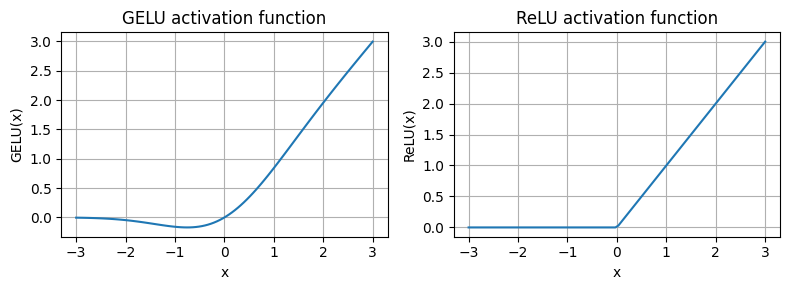

In [37]:
import matplotlib.pyplot as plt

gelu, relu = GELU(), nn.ReLU()

# Some sample data
x = torch.linspace(-3, 3, 100)
y_gelu, y_relu = gelu(x), relu(x)

plt.figure(figsize=(8, 3))
for i, (y, label) in enumerate(zip([y_gelu, y_relu], ["GELU", "ReLU"]), 1):
    plt.subplot(1, 2, i)
    plt.plot(x, y)
    plt.title(f"{label} activation function")
    plt.xlabel("x")
    plt.ylabel(f"{label}(x)")
    plt.grid(True)

plt.tight_layout()
plt.show()

The smoothness of GELU can lead to better optimization properties during training,
as it allows for more nuanced adjustments to the model’s parameters. In contrast,
ReLU has a sharp corner at zero, which can sometimes make optimization harder, especially in networks that are very deep or have complex architectures.

Moreover, unlike ReLU, which outputs zero for any negative input, GELU allows for a small, non-zero output for negative values. This characteristic means that
during the training process, neurons that receive negative input can still contribute to
the learning process, albeit to a lesser extent than positive inputs.

## MLP vs FFN


The simple answer is:
**An MLP is a *specific type* of FFN.**

Think of it like this: **All MLPs are FFNs, but not all FFNs are MLPs.**

It's the same as the relationship between a "poodle" and a "dog". A poodle is a specific breed of dog. All poodles are dogs, but not all dogs are poodles (some are Labradors, Beagles, etc.).

Let's break down the details.

---

### Feedforward Neural Network (FFN): The General Category

A **Feedforward Neural Network** is any artificial neural network where the connections between nodes **do not form a cycle**. Information moves in only one direction—from the input nodes, through any hidden layers, to the output nodes.

*   **Defining Characteristic:** One-way data flow. `Input -> Process -> Output`.
*   **What it's NOT:** It's the opposite of a Recurrent Neural Network (RNN), where connections can form cycles, allowing information to persist and flow back on itself.
*   **Scope:** This is a very broad category that includes many different architectures.

**Examples of FFNs include:**
*   **Multilayer Perceptrons (MLPs)**
*   **Convolutional Neural Networks (CNNs)** (data flows forward through convolutional, pooling, and dense layers)
*   Even a single-layer perceptron.



---

### Multilayer Perceptron (MLP): The Specific Architecture

A **Multilayer Perceptron** is a *classic* and *specific* type of feedforward network. It has a very well-defined structure:

*   **Connections:** It consists of a series of **fully-connected layers** (also called "Dense" layers). This means every neuron in one layer is connected to every neuron in the next layer.
*   **Layers:** It has at least three layers: an input layer, one or more hidden layers, and an output layer.
*   **Activation:** Non-linear activation functions (like ReLU, Sigmoid, or Tanh) are used in the hidden layers. This is crucial—without them, a multi-layer network would behave just like a single-layer linear model.

MLPs are the "vanilla" neural networks that people often learn first. They are great for problems with tabular data or as a final classification head in more complex models.

---

### Key Differences at a Glance

| Feature | Feedforward Neural Network (FFN) | Multilayer Perceptron (MLP) |
| :--- | :--- | :--- |
| **Scope** | **Broad Category.** Describes any network with one-way data flow. | **Specific Architecture.** A type of FFN. |
| **Layer Types** | Can be anything: fully-connected, convolutional, pooling, etc. | Must be **fully-connected** (Dense) layers. |
| **Connections** | Acyclical (no loops). | A specific acyclical structure where all nodes in layer `N` connect to all nodes in layer `N+1`.|
| **Examples** | MLPs, CNNs, a portion of Transformers. | A classic network for classification/regression on tabular data. |

---

### The Modern Context: The Transformer "FFN" Block

To add to the confusion, the term "FFN" has gained a very specific meaning in the context of the **Transformer architecture** (used in models like BERT and GPT).

In a Transformer, the "Feed-Forward Network" (often abbreviated as FFN) is a sub-module that appears after the self-attention mechanism. This FFN block is, ironically, **a small, two-layer MLP**.

It typically consists of:
1.  A fully-connected (Linear) layer that expands the dimension.
2.  A ReLU or GELU activation function.
3.  A second fully-connected (Linear) layer that projects the dimension back down.

It's called an FFN in this context to distinguish it from the other main component, the "Multi-Head Attention" block. So when someone is talking about Transformers and says "the FFN part", they are referring to a specific MLP-like block within the larger model.

### Conclusion

*   **Technically:** FFN is the general family of "one-way" networks, and MLP is a specific member of that family defined by its fully-connected layers.
*   **In Casual Conversation:** People often use "FFN" and "MLP" interchangeably when they're talking about simple, fully-connected networks.
*   **In the Context of Transformers:** "FFN" refers to a specific internal block which is, in fact, a small MLP.

## Feed Forward Network (FFN)

* The FeedForward module is a small neural network consisting of two
Linear layers and a GELU activation function. 
* In the 124-million-parameter GPT
model, it receives the input batches with tokens that have an embedding size of 768
each via the `GPT_CONFIG_124M` dictionary where `GPT_CONFIG_ 124M["emb_dim"] = 768`.

* The figure below shows how the embedding size is manipulated inside this small feed forward neural network when we pass it some inputs.


An overview of the connections between the layers of the
feed forward neural network. This neural network can accommodate
variable batch sizes and numbers of tokens in the input. However, the
embedding size for each token is determined and fixed when initializing
the weights.

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch04_compressed/09.webp?12" style="max-width: 50%; height: auto; display: block;">


* The FeedForward module plays a crucial role in enhancing the model’s ability to learn
from and generalize the data. 
* Although the input and output dimensions of this
module are the same, it internally expands the embedding dimension into a higherdimensional space through the first linear layer, as illustrated in the figure below. 
* This expansion is followed by a nonlinear GELU activation and then a contraction back to the original dimension with the second linear transformation. Such a design allows for the
exploration of a richer representation space.
* Moreover, the uniformity in input and output dimensions simplifies the architecture
by enabling the stacking of multiple layers, as we will do later, without the need to
adjust dimensions between them, thus making the model more scalable.

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch04_compressed/10.webp" style="max-width: 50%; height: auto; display: block;">

In [38]:
class FeedForward(nn.Module):
    def __init__(self, cfg):
        super().__init__()
        self.layers = nn.Sequential(
            nn.Linear(in_features=cfg["emb_dim"], out_features=4 * cfg["emb_dim"]),
            GELU(),
            nn.Linear(in_features=4 * cfg["emb_dim"], out_features=cfg["emb_dim"]),
        )

    def forward(self, x):
        return self.layers(x)


In [39]:
ffn = FeedForward(GPT_CONFIG_124M)
x = torch.rand(2, 3, 768)
out = ffn(x)
print(out.shape)

torch.Size([2, 3, 768])


### Expansion and contraction dimensions

The short answer is: **This 'expand-then-contract' structure gives the model a larger "thinking space" to learn more complex patterns.**

Let's break this down with an analogy.

### The Workspace Analogy

Imagine your input tensor `x` with dimension `emb_dim` is like a **highly compressed ZIP file**. It contains a lot of rich information, but it's all packed together tightly and is difficult to work with directly.

1.  **`nn.Linear(emb_dim, 4 * emb_dim)` — The Expansion**
    *   This layer acts like **decompressing the file**. It projects the information into a much larger, higher-dimensional space. We can call this the "inner" or "hidden" dimension.
    *   In this larger "workspace," the different features and concepts that were tangled together in the compact `emb_dim` representation are now spread out and have more room to interact.

2.  **`GELU()` — Working in the Workspace**
    *   This is the most critical step. The non-linear activation function (GELU) now operates in this high-dimensional space.
    *   It can sift through the "unpacked" features, deciding which are important (amplify them), which are not (suppress them), and how they should be combined. It can learn far more complex relationships and transformations in this large workspace than it could in the original, cramped `emb_dim` space.
    *   **Without this non-linearity, the two linear layers would mathematically collapse into a single, less powerful linear layer.** The GELU is what allows the "thinking" to happen.

3.  **`nn.Linear(4 * emb_dim, emb_dim)` — The Contraction**
    *   This layer acts like **re-compressing the file**. After the model has done its "work" in the larger space, this layer takes the newly transformed features and projects them back down to the original `emb_dim` size.
    *   This is necessary so the output can be used by the next component in the network (for example, another attention block), which expects an input of size `emb_dim`.

### Why Not Just `emb_dim` -> `emb_dim`?

You could create a feed-forward layer like this:
`nn.Linear(emb_dim, emb_dim)` -> `GELU()`

However, this creates an **information bottleneck**. The network is forced to learn a complex, non-linear transformation while staying within the same dimensional space. By expanding to a larger intermediate dimension, you give the model more capacity and flexibility to learn. The `4 * emb_dim` neurons in the hidden layer can each specialize in detecting different patterns, which are then intelligently combined in the final projection layer.

### Why the Number 4?

The choice of `4` is a **hyperparameter**, and it comes from the original "Attention is All You Need" paper that introduced the Transformer architecture. The authors found it worked well.
*   **Larger Multiplier (e.g., 8x):** More parameters, more computational power, potentially can learn more complex functions, but also higher risk of overfitting and slower training.
*   **Smaller Multiplier (e.g., 2x):** Fewer parameters, faster, but may not have enough capacity to learn the necessary transformations.

The 4x expansion factor has proven to be a robust and effective choice for many models, so it has become a standard convention.


### Why the contraction dimension has 4?

why not has the code as follows:
```python
def init(self, cfg):
    super().init()
    self.layers = nn.Sequential(
        nn.Linear(cfg["emb_dim"], 4 * cfg["emb_dim"]),
        GELU(),
        # 4 omitted in the in_features
        nn.Linear(cfg["emb_dim"], cfg["emb_dim"]),
```


**The input dimension of a layer must be exactly the same as the output dimension of the layer that came before it.**

The `nn.Sequential` container processes data step-by-step, passing the output of one layer directly as the input to the next.

Let's trace the shape of the data through your proposed `nn.Sequential` block.

Assume `cfg["emb_dim"]` is `512` for this example.

---

### Tracing the Data Flow

1.  **Input `x`**
    *   A tensor `x` enters the `FeedForward` block.
    *   Shape of `x`: `[batch_size, sequence_length, 512]`

2.  **Layer 1: `nn.Linear(512, 4 * 512)`**
    *   This layer takes an input of size `512`. This matches our input `x`, so it works.
    *   It produces an output of size `4 * 512 = 2048`.
    *   **Shape of the data after this layer:** `[batch_size, sequence_length, 2048]`

3.  **Layer 2: `GELU()`**
    *   `GELU` is an element-wise activation function. It changes the values inside the tensor but **does not change its shape**.
    *   **Shape of the data after this layer:** `[batch_size, sequence_length, 2048]`

4.  **Layer 3: `nn.Linear(512, 512)`** <--- **THE PROBLEM**
    *   This layer is defined to accept an input with `in_features = 512`.
    *   However, the data it is receiving from the `GELU` layer has a feature dimension of **`2048`**.
    *   **`2048 != 512`**

**CRASH!** PyTorch will stop and give you a `RuntimeError` because of this shape mismatch.

The error message would look something like this:

```
RuntimeError: mat1 and mat2 shapes cannot be multiplied (64x2048 and 512x512)
```
This error means the input tensor's feature dimension (2048) does not match the weight matrix's expected input dimension (512).


## Shortcut connections

- Next, let's talk about the concept behind shortcut connections, also called skip or residual connections
- Originally, shortcut connections were proposed in deep networks for computer vision (residual networks) to mitigate vanishing gradient problems.
- The vanishing gradient problem refers to the issue where gradients
(which guide weight updates during training) become progressively smaller as they
propagate backward through the layers, making it difficult to effectively train earlier
layers.
- A shortcut connection creates an alternative shorter path for the gradient to flow through the network
- This is achieved by adding the output of one layer to the output of a later layer, usually skipping one or more layers in between
- Let's illustrate this idea with a small example network:

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch04_compressed/12.webp?123" style="max-width: 60%; height: auto; display: block;">

In [40]:
layer_example = nn.Sequential(nn.Linear(3, 4), GELU(), nn.Linear(4,3), nn.Linear(3, 1))
sample_input = torch.tensor([[1., 0., -1.]])
print(sample_input)
print(sample_input.shape)
out = layer_example(sample_input)
print(out)
print(out.shape)

print(layer_example)

tensor([[ 1.,  0., -1.]])
torch.Size([1, 3])
tensor([[0.5826]], grad_fn=<AddmmBackward0>)
torch.Size([1, 1])
Sequential(
  (0): Linear(in_features=3, out_features=4, bias=True)
  (1): GELU()
  (2): Linear(in_features=4, out_features=3, bias=True)
  (3): Linear(in_features=3, out_features=1, bias=True)
)


- The following code implements a deep neural network with five layers, each consisting of a
Linear layer and a GELU activation function. In the forward pass, we iteratively pass the
input through the layers and optionally add the shortcut connections if the `self.use_
shortcut` attribute is set to `True`. 

- This code specifies a loss function that computes how close the model output and a
user-specified target (here, for simplicity, the value 0) are. 

- When calling `loss.backward()`, PyTorch computes the loss gradient for each layer in the model. We
can iterate through the weight parameters via `model.named_parameters()`. 

- Suppose we have a 3 × 3 weight parameter matrix for a given layer. In that case, this layer will have
3 × 3 gradient values, and we print the mean absolute gradient of these 3 × 3 gradient
values to obtain a single gradient value per layer to compare the gradients between
layers more easily.

- In short, the .backward() method is a convenient method in PyTorch that computes loss gradients, which are required during model training, without implementing the math for the gradient calculation ourselves, thereby making working with
deep neural networks much more accessible.

In [41]:
class ExampleDeepNeuralNetwork(nn.Module):
    def __init__(self, layer_sizes, use_shortcut):
        super().__init__()
        self.use_shortcut = use_shortcut
        # implements 5 layers
        self.layers = nn.ModuleList([
            nn.Sequential(nn.Linear(layer_sizes[0], layer_sizes[1]), GELU()),
            nn.Sequential(nn.Linear(layer_sizes[1], layer_sizes[2]), GELU()),
            nn.Sequential(nn.Linear(layer_sizes[2], layer_sizes[3]), GELU()),
            nn.Sequential(nn.Linear(layer_sizes[3], layer_sizes[4]), GELU()),
            nn.Sequential(nn.Linear(layer_sizes[4], layer_sizes[5]), GELU())
        ])

    def forward(self, x):
        for layer in self.layers:
            # Compute the output of the current layer
            # print(layer)
            layer_output = layer(x)
            # Check if shortcut can be applied
            if self.use_shortcut and x.shape == layer_output.shape:
                # print("adding connection on layer: ", layer)
                x = x + layer_output
            else:
                x = layer_output
        return x


def print_gradients(model, x):
    # Forward pass
    output = model(x)
    target = torch.tensor([[0.]])

    # Calculate loss based on how close the target
    # and output are
    loss = nn.MSELoss()
    loss = loss(output, target)

    # Backward pass to calculate the gradients
    loss.backward()

    for name, param in model.named_parameters():
        if 'weight' in name:
            # Print the mean absolute gradient of the weights
            print(f"{name} has gradient mean of {param.grad.abs().mean().item()}")


Let's print the gradient values first **without** shortcut connections:


In [42]:
layer_sizes = [3, 3, 3, 3, 3, 1]  

sample_input = torch.tensor([[1., 0., -1.]])

torch.manual_seed(123)
model_without_shortcut = ExampleDeepNeuralNetwork(
    layer_sizes, use_shortcut=False
)
print_gradients(model_without_shortcut, sample_input)

layers.0.0.weight has gradient mean of 0.00020173587836325169
layers.1.0.weight has gradient mean of 0.0001201116101583466
layers.2.0.weight has gradient mean of 0.0007152041071094573
layers.3.0.weight has gradient mean of 0.0013988735154271126
layers.4.0.weight has gradient mean of 0.005049645435065031


The output of the print_gradients function shows, the gradients become smaller
as we progress from the last layer (layers.4) to the first layer (layers.0), which is
a phenomenon called the _vanishing gradient_ problem.


Next, let's print the gradient values **with** shortcut connections:


In [43]:
torch.manual_seed(123)
model_with_shortcut = ExampleDeepNeuralNetwork(
    layer_sizes, use_shortcut=True
)
print_gradients(model_with_shortcut, sample_input)

layers.0.0.weight has gradient mean of 0.22169791162014008
layers.1.0.weight has gradient mean of 0.20694106817245483
layers.2.0.weight has gradient mean of 0.32896995544433594
layers.3.0.weight has gradient mean of 0.2665732204914093
layers.4.0.weight has gradient mean of 1.3258540630340576


The last layer (layers.4) still has a larger gradient than the other layers. However,
the gradient value stabilizes as we progress toward the first layer (layers.0) and
doesn’t shrink to a vanishingly small value.

In conclusion, shortcut connections are important for overcoming the limitations
posed by the vanishing gradient problem in deep neural networks. Shortcut connections are a core building block of very large models such as LLMs, and they will help facilitate more effective training by ensuring consistent gradient flow across layers when we train the GPT model.

## Transformer block


Now, let’s implement the transformer block, a fundamental building block of GPT and
other LLM architectures. This block, which is repeated a dozen times in the 124-millionparameter GPT-2 architecture, combines several concepts we have previously covered:
multi-head attention, layer normalization, dropout, feed forward layers, and GELU
activations. Later, we will connect this transformer block to the remaining parts of the
GPT architecture.

- The given code defines a TransformerBlock class in PyTorch that includes a multi-head
attention mechanism (MultiHeadAttention) and a feed forward network (FeedForward), both configured based on a provided configuration dictionary (cfg), such
as GPT_CONFIG_124M.

- Layer normalization (LayerNorm) is applied before each of these two components,
and dropout is applied after them to regularize the model and prevent overfitting. This
is also known as Pre-LayerNorm. Older architectures, such as the original transformer
model, applied layer normalization after the self-attention and feed forward networks
instead, known as Post-LayerNorm, which often leads to worse training dynamics.

- The class also implements the forward pass, where each component is followed by
a shortcut connection that adds the input of the block to its output. This critical feature helps gradients flow through the network during training and improves the
learning of deep models.

- The figure below shows a transformer block that combines several components, including the masked multi-head attention module and the FeedForward module we previously implemented. 

- When a transformer block processes an input sequence, each element in the sequence (for example, a word or subword token) is represented by a fixed-size vector (in this case, 768 dimensions). 

- The operations within the transformer block, including multi-head attention and feed forward layers, are designed to transform these vectors in a way that preserves their dimensionality.
 
- The idea is that the self-attention mechanism in the multi-head attention block identifies and analyzes relationships between elements in the input sequence. 

- In contrast, the feed forward network modifies the data individually at each position. This combination not only enables a more nuanced understanding and processing of the input but also enhances the model’s overall capacity for handling complex data patterns.

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch04_compressed/13.webp?1" style="max-width: 60%; height: auto; display: block;">

- Suppose we have 2 input samples with 6 tokens each, where each token is a 768-dimensional embedding vector; then this transformer block applies self-attention, followed by linear layers, to produce an output of similar size

### Communicate and think


Think of a team of expert researchers in a conference room, tasked with understanding a complex sentence. Their process is divided into two repeating steps: **1. Communicate** and **2. Think**.

---

#### Step 1: Self-Attention = The Group Meeting (Communication)

> *"The idea is that the self-attention mechanism in the multi-head attention block identifies and analyzes relationships between elements in the input sequence."*

This is the **Communicate** step.

Imagine each word in your sentence is one expert researcher.
`[ "The", "cat", "sat", "on", "the", "mat" ]`

The self-attention mechanism is like a big group meeting where **every researcher talks to every other researcher**.

*   The researcher for the word "cat" looks at all the other words. It figures out its relationship with them. It might find a strong connection to "sat" and "mat".
*   The researcher for the word "sat" finds strong connections to "cat" and "on".
*   Crucially, if the sentence were "The cat chased the mouse, and **it** escaped," the researcher for "**it**" would look at all other words and realize "**it**" has a very strong relationship with "mouse," not "cat".

**The key takeaway:** After this "meeting," each researcher's understanding is no longer isolated. The representation for "cat" is now enriched with context from "sat" and "mat". The representation for "it" is now enriched with the meaning of "mouse". **Information has been mixed and shared across the entire sequence.** This is a **horizontal** operation—it works *between* the elements.



---

#### Step 2: Feed-Forward Network (FFN) = Individual Deep Thinking

> *"In contrast, the feed forward network modifies the data individually at each position."*

This is the **Think** step.

After the big meeting (Attention), each researcher goes back to their own private desk to process the new information they've gathered.

*   Each word, now rich with context from the attention step, is passed through its **own identical Feed-Forward Network (FFN)**.
*   The FFN for "cat" takes the context-enriched "cat" vector and performs a complex non-linear transformation on it. This is like deep thinking, where the researcher synthesizes the new information and refines their own concept.
*   **Crucially, this happens individually.** The FFN working on "cat" does not know what the FFN for "sat" is doing. They are all working in parallel on their own updated information.

**The key takeaway:** This is a **vertical** operation. It doesn't mix information between words. Instead, it works deeply *within* each word's own feature vector to process the context it just received from the attention step. The `emb_dim -> 4*emb_dim -> emb_dim` structure gives it the "mental workspace" to perform this complex processing.



---

#### Why the Combination is So Powerful

> *"This combination not only enables a more nuanced understanding and processing of the input but also enhances the model’s overall capacity for handling complex data patterns."*

The magic of the Transformer block is that it alternates between these two complementary steps:

1.  **Attention (Communicate):** Gathers global context and figures out what's relevant. Answers the question: *"What parts of the sequence should I focus on?"*
2.  **FFN (Think):** Processes that context-rich information for each element. Answers the question: *"Now that I have this context, what does it mean and how should I transform my understanding?"*

By stacking these blocks, the model can build up an incredibly sophisticated understanding. The first block might find simple word relationships. The next block can then find relationships *between those relationships*, and so on.

The **attention** mechanism provides the model with breadth (seeing the whole sequence), while the **FFN** provides it with depth (the computational power to process what it sees). This division of labor is what gives Transformer models their remarkable capacity.

Let's implement it:

In [44]:
class TransformerBlock(nn.Module):
    def __init__(self, cfg):
        super().__init__()
        self.att = MultiHeadAttention(
            d_in=cfg["emb_dim"],
            d_out=cfg["emb_dim"],
            context_length=cfg["context_length"],
            num_heads=cfg["n_heads"],
            dropout=cfg["drop_rate"],
            qkv_bias=cfg["qkv_bias"])
        self.ff = FeedForward(cfg)
        self.norm1 = LayerNorm(cfg["emb_dim"])
        self.norm2 = LayerNorm(cfg["emb_dim"])
        self.drop_shortcut = nn.Dropout(cfg["drop_rate"])

    def forward(self, x):
        # Shortcut connection for attention block
        shortcut = x
        x = self.norm1(x)
        # print('before att: ', x.shape)
        x = self.att(x)  # Shape [batch_size, num_tokens, emb_size]
        # print('after att: ', x.shape)
        x = self.drop_shortcut(x)
        x = x + shortcut  # Add the original input back

        # Shortcut connection for feed forward block
        shortcut = x
        x = self.norm2(x)
        x = self.ff(x)
        x = self.drop_shortcut(x)
        x = x + shortcut  # Add the original input back

        return x

In [45]:
torch.manual_seed(123)

x = torch.rand(2, 4, 768)  # Shape: [batch_size, num_tokens, emb_dim]
block = TransformerBlock(GPT_CONFIG_124M)
output = block(x)

print("Input shape:", x.shape)
print("Output shape:", output.shape)
output

Input shape: torch.Size([2, 4, 768])
Output shape: torch.Size([2, 4, 768])


/Users/charbelk/dev/understanding_transformer/venv/lib/python3.12/site-packages/treescope/external/torch_support.py:182: UserWarning: The .grad attribute of a Tensor that is not a leaf Tensor is being accessed. Its .grad attribute won't be populated during autograd.backward(). If you indeed want the .grad field to be populated for a non-leaf Tensor, use .retain_grad() on the non-leaf Tensor. If you access the non-leaf Tensor by mistake, make sure you access the leaf Tensor instead. See github.com/pytorch/pytorch/pull/30531 for more informations. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/build/aten/src/ATen/core/TensorBody.h:494.)
  array_grad = array.grad


tensor([[[-0.0055,  0.0972, -0.1122,  ...,  1.2889,  0.2623,  0.6685],
         [ 0.0023, -0.2369,  0.1720,  ...,  0.5952,  0.2497,  0.7447],
         [ 0.4673,  0.4472,  0.1791,  ...,  1.2525,  0.3045,  0.7750],
         [ 0.0662,  0.7224,  0.9206,  ...,  0.4790,  0.7428,  0.7015]],

        [[ 0.3622,  1.2144,  0.5221,  ...,  0.1854,  0.0111, -0.5034],
         [-0.0225,  0.7789,  0.2770,  ...,  0.1734,  0.5419,  0.1143],
         [ 0.7425,  0.4013,  0.3211,  ...,  0.3268,  0.7523, -0.1642],
         [ 0.5745,  0.6241,  0.4410,  ...,  1.1963,  1.2650,  0.2243]]],
       grad_fn=<AddBackward0>)

## The GPT Model

- We are almost there: now let's plug in the transformer block into the architecture we coded at the very beginning of this chapter so that we obtain a usable GPT architecture
- Note that the transformer block is repeated multiple times; in the case of the smallest 124M GPT-2 model, we repeat it 12 times:

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch04_compressed/15.webp" style="max-width: 60%; height: auto; display: block;">

**Putting everything together** 

- Thanks to the TransformerBlock class, the GPTModel class is relatively small and
compact.
- The __init__ constructor of this GPTModel class initializes the token and positional embedding layers using the configurations passed in via a Python dictionary,
cfg. These embedding layers are responsible for converting input token indices into
dense vectors and adding positional information (see chapter 2).
- Next, the __init__ method creates a sequential stack of TransformerBlock modules equal to the number of layers specified in cfg. Following the transformer blocks,
a LayerNorm layer is applied, standardizing the outputs from the transformer blocks to
stabilize the learning process. Finally, a linear output head without bias is defined,
which projects the transformer’s output into the vocabulary space of the tokenizer to
generate logits for each token in the vocabulary.
- The forward method takes a batch of input token indices, computes their embeddings, applies the positional embeddings, passes the sequence through the transformer
blocks, normalizes the final output, and then computes the logits, representing the next
token’s unnormalized probabilities. 

- We will convert these logits into tokens and text
outputs in the next section. 

In [46]:
class GPTModel(nn.Module):
    def __init__(self, cfg):
        super().__init__()
        self.tok_emb = nn.Embedding(cfg["vocab_size"], cfg["emb_dim"])
        self.pos_emb = nn.Embedding(cfg["context_length"], cfg["emb_dim"])
        self.drop_emb = nn.Dropout(cfg["drop_rate"])

        self.trf_blocks = nn.Sequential(
            *[TransformerBlock(cfg) for _ in range(cfg["n_layers"])])

        self.final_norm = LayerNorm(cfg["emb_dim"])
        self.out_head = nn.Linear(
            in_features=cfg["emb_dim"], out_features=cfg["vocab_size"], bias=False
        )

    def forward(self, in_idx):
        batch_size, seq_len = in_idx.shape
        tok_embeds = self.tok_emb(in_idx) # shape [batch_size, num_tokens, emb_size]
        # print(f'{tok_embeds.shape=}')
        pos_embeds = self.pos_emb(torch.arange(seq_len, device=in_idx.device)) # shape [1, num_tokens, emb_size] broadcasting will apply here
        # print(f'{pos_embeds.shape=}')
        x = tok_embeds + pos_embeds  # Shape [batch_size, num_tokens, emb_size]
        # print(f'after embedding {x.shape=}')
        x = self.drop_emb(x)
        x = self.trf_blocks(x) # shape [batch_size, num_tokens, emb_size]
        # print(f'after trf blocks {x.shape=}')
        x = self.final_norm(x)
        logits = self.out_head(x) # shape [batch_size, num_tokens, vocab_size]
        # print(f'after out_head {logits.shape=}')
        return logits

- Using the configuration of the 124M parameter model, we can now instantiate this GPT model with random initial weights as follows:

In [47]:
torch.manual_seed(123)
model = GPTModel(GPT_CONFIG_124M)
print("Input batch: ", batch.shape)
out = model(batch)
print("Output shape:", out.shape)

Input batch:  torch.Size([2, 4])
Output shape: torch.Size([2, 4, 50257])


- As we can see, the transformer block maintains the input dimensions in its output, indicating that the transformer architecture processes sequences of data without altering
their shape throughout the network.

- The preservation of shape throughout the transformer block architecture is not
incidental but a crucial aspect of its design. 

- This design enables its effective application across a wide range of sequence-to-sequence tasks, where each output vector directly corresponds to an input vector, maintaining a one-to-one relationship. However, the output is a context vector that encapsulates information from the entire input sequence. 

- **This means that while the physical dimensions of the sequence (length and feature size) remain unchanged as it passes through the transformer block, the content of each output vector is re-encoded to integrate contextual
information from across the entire input sequence.**

### Last layer is a classification layer?
Notice the size of the inputs and outputs dont change much until the last layer.

The last Linear output Layer embeds each token vector into a `vocab_size` (50,257) dimensional embedding.
The last layer is projecting the `embed_size` to the `vocab_size`, simlpy by $\ y= x A^\intercal + b $
```py
nn.Linear(in_features=cfg["emb_dim"], out_features=cfg["vocab_size"], bias=False)
```
The goal is for these embeddings to be converted back into text such that the last row represents the word the model is supposed to generate (here the word "forward"). Its basically transformed into a classification problem where the network is outputing the logits of all the classes of the 50,257

By doing so we have now entered in the vocabulary and by selecting the highest probability after a softmax we will get the index of the token that is predicted by the model. Then its transformed to a word with the decoder.

In [48]:
last_layer = nn.Linear(in_features=GPT_CONFIG_124M["emb_dim"], out_features=GPT_CONFIG_124M["vocab_size"], bias=False)
input_x = torch.rand(2, 4, 768)
print('input_x: ', input_x.shape)
output_last_layer = last_layer(input_x)
print('output_last_layer: ', output_last_layer.shape)

input_x:  torch.Size([2, 4, 768])
output_last_layer:  torch.Size([2, 4, 50257])


### Note on Model parameters

- As we see below, this model has 163M, not 124M parameters; why?
- In the original GPT-2 paper, the researchers applied weight tying, which means that they reused the token embedding layer (`tok_emb`) as the output layer, which means setting `self.out_head.weight = self.tok_emb.weight`
- The token embedding layer projects the 50,257-dimensional one-hot encoded input tokens to a 768-dimensional embedding representation
- The output layer projects 768-dimensional embeddings back into a 50,257-dimensional representation so that we can convert these back into words (more about that in the next section)
- So, the embedding and output layer have the same number of weight parameters, as we can see based on the shape of their weight matrices
- However, a quick note about its size: we previously referred to it as a 124M parameter model; however, its more here since the GPT-2 model had weight tying, between the token embeddings layer and the output `out_head`.

In [49]:
total_params = sum(p.numel() for p in model.parameters())
print(f"Total number of parameters: {total_params:,}")

Total number of parameters: 163,009,536


- In the original GPT-2 paper, the researchers reused the token embedding matrix as an output matrix
- Correspondingly, if we subtracted the number of parameters of the output layer, we'd get a 124M parameter model:

In [50]:
print("Token embedding layer shape:", model.tok_emb.weight.shape)
print("Output layer shape:", model.out_head.weight.shape)

Token embedding layer shape: torch.Size([50257, 768])
Output layer shape: torch.Size([50257, 768])


In [51]:
total_params_gpt2 =  total_params - sum(p.numel() for p in model.out_head.parameters())
print(f"Number of trainable parameters considering weight tying: {total_params_gpt2:,}")

Number of trainable parameters considering weight tying: 124,412,160


### What is Weight Tying in GPT-2?

In simple terms, weight tying in GPT-2 is the practice of using the **exact same set of weights** for two different parts of the model:

1.  The **Input Token Embedding Layer**: This layer converts an input token ID (e.g., the number `31373` for the word "apple") into a dense vector (the embedding).
2.  The **Final Output Linear Layer**: This layer takes the final hidden state vector from the Transformer and converts it back into logits (raw scores) for every word in the vocabulary, to predict the next token.

The key technical detail is that the weight matrix of the final output layer is simply the **transpose** of the input embedding matrix.

Let's visualize this.

---

#### Before Weight Tying (The Naive Approach)

Without weight tying, you would have two completely separate, massive weight matrices:

1.  **Input Embedding Matrix (`W_E`)**
    *   **Purpose:** To look up a word's vector.
    *   **Shape:** `[vocab_size, emb_dim]`
    *   For GPT-2: `[50257, 768]`

2.  **Output Decoding Matrix (`W_D`)**
    *   **Purpose:** To score all words in the vocabulary based on the final context vector.
    *   **Shape:** `[emb_dim, vocab_size]`
    *   For GPT-2: `[768, 50257]`



These two matrices are the largest single parameter blocks in the entire model. For GPT-2 base, each one has `50,257 * 768 = ~38.6 million` parameters. Together, they are ~77.2 million parameters.

---

#### After Weight Tying (The Smart GPT-2 Approach)

With weight tying, you only have **one** matrix.

1.  **Input/Output Shared Matrix (`W_E`)**
    *   **Shape:** `[vocab_size, emb_dim]`
    *   **Usage 1 (Input):** Used directly to look up embeddings.
    *   **Usage 2 (Output):** Its **transpose** (`W_E.T`) is used as the weights for the final linear layer.



Now, instead of `38.6M + 38.6M = 77.2M` parameters, you only need **38.6M** for both jobs. You just saved nearly 40 million parameters!

---

#### Why Do This? The Benefits

This isn't just a clever hack; there are deep and practical reasons why it works so well.

##### 1. Drastic Parameter Reduction (The Obvious Reason)

As shown above, this technique almost halves the size of the largest parameter blocks in the model. This leads to:
*   **Smaller model size** on disk.
*   **Reduced memory footprint** during training and inference.
*   Faster model loading times.

##### 2. Conceptual Symmetry (The Elegant Reason)

This is the more beautiful reason. Think about what the two layers are doing:
*   **Embedding Layer:** Answers the question, "Given the word 'apple', what is its abstract meaning as a vector?"
*   **Decoding Layer:** Answers the question, "Given this abstract meaning vector, what is the probability that the word is 'apple'?"

It is intuitively logical that these two operations should be inverses (or transposes) of each other. If a specific row in the embedding matrix `W_E` defines the "meaning" of 'apple', then the corresponding column in the output matrix should be responsible for detecting that exact same "meaning".

Tying the weights forces the model to learn a single, consistent representation space for both understanding and generating words.

##### 3. Improved Model Quality (The Performance Reason)

By forcing this constraint, weight tying acts as a very strong and effective form of **regularization**. It reduces the model's total number of free parameters, preventing it from overfitting. In many cases, this leads to better performance (lower perplexity) than a model with separate, untied weights, especially when training data is limited.

In essence, weight tying is a rare "free lunch" in deep learning: it reduces model size, makes the model more conceptually elegant, and often improves its performance. It has become a standard practice for most modern language models.

### Model size



In [52]:
# Calculate the total size in bytes (assuming float32, 4 bytes per parameter)
total_size_bytes = total_params * 4

megabyte = 1024 * 1024
# Convert to megabytes
total_size_mb = total_size_bytes / megabyte

print(f"Total size of the model: {total_size_mb:.2f} MB")

Total size of the model: 621.83 MB


## Generating Text

* The process by which a GPT model goes from output tensors to generated text
involves several steps, as illustrated in the figure below. These steps include decoding the output tensors, selecting tokens based on a probability distribution, and converting these tokens into human-readable text.
* The next-token generation process detailed in the figure illustrates a single step where the GPT model generates the next token given its input.

* In each step, the model outputs a matrix with vectors representing potential next tokens. The vector corresponding to the next token is extracted and converted into a probability distribution via the softmax function. 

* Within the vector containing the resulting probability scores, the index of the highest value is located, which translates to the token ID. 

* This token ID is then decoded back into text, producing the next token in the sequence. 

* Finally, this token is appended to the previous inputs, forming a new input sequence for the subsequent iteration. This step-by-step process enables the model to generate text sequentially, building coherent phrases and sentences from the initial input context.

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch04_compressed/17.webp" style="max-width: 80%; height: auto; display: block;">

* In practice, we repeat this process over many iterations until we reach a user-specified number of generated tokens.

* In code, we can implement the token-generation process as shown in the following listing.

In [53]:
def generate_text_simple(model, idx, max_new_tokens, context_size):
    # idx is (batch, n_tokens) array of indices in the current context
    for _ in range(max_new_tokens):
        # Crop current context if it exceeds the supported context size
        # E.g., if LLM supports only 5 tokens, and the context size is 10
        # then only the last 5 tokens are used as context
        idx_cond = idx[:, -context_size:]

        # Get the predictions
        with torch.no_grad():
            logits = model(idx_cond)
            # print('logits shape: ', logits.shape)

        # Focus only on the last time step
        # (batch, n_tokens, vocab_size) becomes (batch, vocab_size)
        # the first : --> keep all the elements in the batch
        # the -1 --> keep only the last element of the tokens
        # the second : --> keep all the elements in the vocab_size
        logits = logits[:, -1, :]
        # print('logits shape with last token: ', logits.shape)


        # Apply softmax to get probabilities
        probas = torch.softmax(logits, dim=-1)  # (batch, vocab_size)
        # print('probas shape: ', probas.shape)

        # Get the idx of the vocab entry with the highest probability value
        # get the token id, dim=-1 to indicate the last dimension
        idx_next = torch.argmax(probas, dim=-1, keepdim=True)  # (batch, 1)
        # print('idx_next.shape: ', idx_next)
        # Append sampled index to the running sequence
        idx = torch.cat((idx, idx_next), dim=1)  # (batch, n_tokens+1)

    return idx

* This code demonstrates a simple implementation of a generative loop for a language model using PyTorch. It iterates for a specified number of new tokens to be generated, crops the current context to fit the model’s maximum context size, computes predictions, and then selects the next token based on the highest probability
prediction.

* To code the `generate_text_simple` function, we use a softmax function to convert the logits into a probability distribution from which we identify the position with the highest value via torch.argmax. 

* The softmax function is monotonic, meaning it preserves the order of its inputs when transformed into outputs. So, in practice, the softmax step is redundant since the position with the highest score in the softmax output tensor is the same position in the logit tensor. 

* In other words, we could apply the `torch.argmax` function to the logits tensor directly and get identical results. However, I provide the code for the conversion to illustrate the full process of transforming logits to probabilities, which can add additional intuition so that the model generates the most likely next token, which is known as **greedy decoding**.

* When we implement the GPT training code next, we will use additional sampling techniques to modify the softmax outputs such that the model doesn’t always select the most likely token. This introduces variability and creativity in the generated text.

* This process of generating one token ID at a time and appending it to the context
using the `generate_text_simple` function is further illustrated in the figure below.

* We generate the token IDs in an iterative fashion. For instance, in iteration 1, the model is provided with the tokens corresponding to “Hello, I am,” predicts the next token (with
ID 257, which is “a”), and appends it to the input. This process is repeated until the
model produces the complete sentence “Hello, I am a model ready to help” after six
iterations.

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch04_compressed/18.webp" style="max-width: 80%; height: auto; display: block;">

In [54]:
start_context = "Hello, I am"

encoded = tokenizer.encode(start_context)
print("encoded:", encoded)

encoded_tensor = torch.tensor(encoded).unsqueeze(0)
print("encoded_tensor", encoded_tensor)
print("encoded_tensor.shape:", encoded_tensor.shape)

encoded: [15496, 11, 314, 716]
encoded_tensor tensor([[15496,    11,   314,   716]])
encoded_tensor.shape: torch.Size([1, 4])


In [55]:
model.eval() # disable dropout

out = generate_text_simple(
    model=model,
    idx=encoded_tensor,
    max_new_tokens=6, # give max_new_tokens
    context_size=GPT_CONFIG_124M["context_length"]
)

print("Output:", out)
print("Output length:", len(out[0]))
out

Output: tensor([[15496,    11,   314,   716, 27018, 24086, 47843, 30961, 42348,  7267]])
Output length: 10


tensor([[15496,    11,   314,   716, 27018, 24086, 47843, 30961, 42348,  7267]])

- Remove batch dimension and convert back into text:

In [56]:
decoded_text = tokenizer.decode(out.squeeze(0).tolist())
print(decoded_text)

Hello, I am Featureiman Byeswickattribute argue


- Note that the model is untrained; hence the random output texts above
- We will train the model in the next chapter
- Lets try a batch of 2

In [57]:
batch = []

txt1 = "Every effort moves you"
txt2 = "Every day holds a"

batch.append(torch.tensor(tokenizer.encode(txt1)))
batch.append(torch.tensor(tokenizer.encode(txt2)))
batch = torch.stack(batch, dim=0)
print(batch.shape)
model.eval() # disable dropout

out = generate_text_simple(
    model=model,
    idx=batch,
    max_new_tokens=6, # give max_new_tokens
    context_size=GPT_CONFIG_124M["context_length"]
)

print("Output:", out)
print("Output length:", out.shape)

batch_size, seq_length = out.shape
for i in range(batch_size):
  decoded_text = tokenizer.decode(out[i].tolist())
  print(decoded_text)


torch.Size([2, 4])
Output: tensor([[ 6109,  3626,  6100,   345, 37532, 24086, 47843, 30961, 42348, 15635],
        [ 6109,  1110,  6622,   257, 31387, 18590,   154, 36413, 47978, 38808]])
Output length: torch.Size([2, 10])
Every effort moves you Aeiman Byeswickattributeometer
Every day holds aftime intensive� REALLY tumble Nay


<a id="#why_same_number_of_tokens_input_output"></a>
### Why the output have the same number of tokens as the input?

The reason the output shape is `[2, 4, 50257]` and not `[2, 1, 50257]` is because the model's architecture is built to be efficient for **training**, and during training, it needs to make a prediction at **every single position** in the sequence, not just the final one.

Let's break down the two different modes: Training vs. Inference.

---

#### 1. During Training: We Need All the Logits

The model learns by being shown a sequence and trying to predict the next token at *every step along the way*.

Imagine we are training the model with the sentence: `["The", "cat", "sat", "on"]`.

*   **Input:** `["The", "cat", "sat", "on"]`
*   **Target (what the model *should* predict):** `["cat", "sat", "on", "the"]`

To calculate the training loss, the model does the following in **one single forward pass**:

1.  When it sees `"The"`, it must try to predict `"cat"`.
2.  When it sees `"The", "cat"`, it must try to predict `"sat"`.
3.  When it sees `"The", "cat", "sat"`, it must try to predict `"on"`.
4.  When it sees `"The", "cat", "sat", "on"`, it must try to predict `"the"`.

To do this efficiently, the model is designed to output a full sequence of predictions. The output tensor `(batch_size, sequence_length, vocab_size)` gives us all the predictions we need at once:

*   `out[:, 0, :]` are the logits for the prediction after the 1st token.
*   `out[:, 1, :]` are the logits for the prediction after the 2nd token.
*   `out[:, 2, :]` are the logits for the prediction after the 3rd token.
*   `out[:, 3, :]` are the logits for the prediction after the 4th token.

The training algorithm then compares all these predictions to the target sequence to compute a total loss, and updates the model's weights. Returning the full sequence of logits is essential for this efficient, parallelized training.

---

#### 2. During Inference (Text Generation): We Only *Use* the Last Logit

Now, when we're done training and want to *use* the model to generate new text, our goal changes. We no longer need to check the model's work at every step. We only want to predict the **single next token**.

However, the model's architecture is fixed. It doesn't know we're in "inference mode." It will always perform the same computation it was trained to do.

So, this is the process:

1.  You give the model your input batch of shape `[2, 4]`.
2.  The model, doing what it always does, returns the full output tensor of shape `[2, 4, 50257]`. It contains the predictions for what comes after token 1, token 2, token 3, and token 4.
3.  **We, the programmers, are responsible for selecting only the part we need.** Since we want to predict the token that comes after the entire sequence (all 4 tokens), we only care about the predictions made at the very last position.
4.  This is precisely where the `[:, -1, :]` slice from your previous question comes in. We apply that slice to the model's output to grab the `[2, 50257]` tensor that contains only the relevant predictions.

#### Summary

| | **Training** | **Inference (Generation)** |
| :--- | :--- | :--- |
| **Goal** | To learn by predicting the next token at *every position* in a sequence simultaneously. | To predict only the *single next token* after the full input sequence. |
| **Model Output**| `[batch, seq_len, vocab_size]` | `[batch, seq_len, vocab_size]` (The model always does the same thing) |
| **What We Use** | We use the **entire output tensor** to compare against the entire target sequence and calculate a loss. | We **slice the output tensor** (`[:, -1, :]`) to get only the logits from the last position. |

The model is built to be a general-purpose sequence processor that is highly efficient for training. It's our job during inference to intelligently use the specific part of its output that aligns with our goal of one-by-one token generation.

### KV Cache to the rescue

This exact problem is why production-level inference for models like GPT **does not** work that way. Instead, it uses a crucial optimization called the **KV Cache**.

Let's compare the naive (wasteful) way with the efficient (KV Cache) way.

---

#### The Wasteful Way (Without KV Cache)

This is the simple loop that follows directly from the training logic.

1.  **Input:** `["The", "cat", "sat"]`
2.  **Model:** Processes all 3 tokens. Computes attention for all 3.
3.  **Output:** Predicts `"on"`.
4.  **New Input:** `["The", "cat", "sat", "on"]`
5.  **Model:** Processes all 4 tokens. **Re-computes attention for "The", "cat", and "sat" all over again**, and also for "on".
6.  **Output:** Predicts `"the"`.

The redundant work is massive. The computational complexity for generating each new token is roughly `O(N^2)` where N is the current sequence length.

---

#### The Efficient Way (With a KV Cache)

The key insight is that in the Transformer's self-attention mechanism, the **Key (K)** and **Value (V)** vectors for past tokens do not change. We can calculate them once and then reuse them.

Here's how it works:

##### Step 1: The "Prefill" or "Prompt Processing" Phase

*   The model receives the initial prompt: `["The", "cat", "sat"]`.
*   It does **one full forward pass** on these 3 tokens.
*   As it calculates the self-attention in each layer, it computes the Key (`K`) and Value (`V`) vectors for "The", "cat", and "sat".
*   Instead of throwing them away, it **saves these K and V vectors** in memory. This is the "KV Cache".
*   It uses these to predict the next token: `"on"`.

##### Step 2: The "Decoding" Phase (Generating subsequent tokens)

*   Now, to generate the *next* token, the input to the model is **only the single token we just generated**: `["on"]`.
*   The model computes the Query (`Q`), Key (`K`), and Value (`V`) for **only this one token**.
*   For the self-attention calculation, it takes the new `Q` for "on" and combines it with the **cached `K` and `V` vectors** for `["The", "cat", "sat"]`.
*   It then **appends** the new K and V for "on" to the cache. The cache now holds the K/V pairs for all 4 tokens.
*   This process repeats. The input to the model at each step is always just a single token, and the cache grows.

#### The Trade-Off: Speed vs. Memory

**Benefit: MASSIVE Speedup**
*   Without the cache, the work at each step grows quadratically with the sequence length.
*   With the cache, the work at each step only grows linearly (the new Query has to be compared against all the cached Keys).
*   This optimization is the primary reason why interacting with LLMs feels fast and responsive.

**Cost: Memory**
*   The KV cache itself needs to be stored in the GPU's memory. For very long sequences (e.g., 32k tokens) and large models, the cache can become enormous, consuming many gigabytes of VRAM.
*   This memory cost is the main limiting factor for the context length of LLMs during inference.


# Pretraining GPT


Lets start by implementing the following two functions as depicted in the figure below:
<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch05_compressed/gpt-process.webp" style="max-width: 70%; height: auto; display: block;">

In [58]:
import tiktoken

def generate_text_simple(model, idx, max_new_tokens, context_size):
    # idx is (batch, n_tokens) array of indices in the current context
    for _ in range(max_new_tokens):
        # Crop current context if it exceeds the supported context size
        # E.g., if LLM supports only 5 tokens, and the context size is 10
        # then only the last 5 tokens are used as context
        idx_cond = idx[:, -context_size:]

        # Get the predictions
        with torch.no_grad():
            logits = model(idx_cond)

        # Focus only on the last token
        # (batch, n_tokens, vocab_size) becomes (batch, vocab_size)
        # keep the batch, last token only, keep the vocab_size
        logits = logits[:, -1, :]

        # Apply softmax to get probabilities
        probas = torch.softmax(logits, dim=-1)  # (batch, vocab_size)

        # Get the idx of the vocab entry with the highest probability value
        # get the token id, dim=-1 to indicate the last dimension
        idx_next = torch.argmax(probas, dim=-1, keepdim=True)  # (batch, 1)
        # print('idx_next: ', idx_next)
        # Append sampled index to the running sequence
        idx = torch.cat((idx, idx_next), dim=1)  # (batch, n_tokens+1)

    return idx

def text_to_token_ids(text, tokenizer):
    encoded = tokenizer.encode(text, allowed_special={'<|endoftext|>'})
    encoded_tensor = torch.tensor(encoded).unsqueeze(0) # add batch dimension
    return encoded_tensor

def token_ids_to_text(token_ids, tokenizer):
    flat = token_ids.squeeze(0) # remove batch dimension
    return tokenizer.decode(flat.tolist())

start_context = "Every effort moves you"
tokenizer = tiktoken.get_encoding("gpt2")

token_ids = generate_text_simple(
    model=model.to(device),
    idx=text_to_token_ids(start_context, tokenizer).to(device),
    max_new_tokens=10,
    context_size=GPT_CONFIG_124M["context_length"],
)

print("Output text:\n", token_ids_to_text(token_ids, tokenizer))


Output text:
 Every effort moves you Aeiman Byeswickattributeometer inspector Normandy freezerigrate


Clearly, the model isn’t yet producing coherent text because it hasn’t undergone
training. To define what makes text “coherent” or “high quality,” we have to implement a numerical method to evaluate the generated content. This approach will
enable us to monitor and enhance the model’s performance throughout its training
process.
 Next, we will calculate a loss metric for the generated outputs. This loss serves as a
progress and success indicator of the training progress.

## Calculating the text generation loss: cross-entropy and perplexity

- Suppose we have an `inputs` tensor containing the token IDs for 2 training examples (rows)
- Corresponding to the `inputs`, the `targets` contain the desired token IDs that we want the model to generate
- Notice that the `targets` are the `inputs` shifted by 1 position, as explained in tokenization section in chapter 2 when the data loader was implemented.

In [59]:
inputs = torch.tensor([[16833, 3626, 6100],   # ["every effort moves",
                       [40,    1107, 588]]).to(device)   #  "I really like"]

targets = torch.tensor([[3626, 6100, 345  ],  # [" effort moves you",
                        [1107,  588, 11311]]).to(device) #  " really like chocolate"]

- Feeding the `inputs` to the model, we obtain the logits vector for the 2 input examples that consist of 3 tokens each
- Each of the tokens is a 50,257-dimensional vector corresponding to the size of the vocabulary
- Applying the softmax function, we can turn the logits tensor into a tensor of the same dimension containing probability scores

In [ ]:
print('Inputs: ', inputs.shape) # (batch_size, num_tokens)
with torch.no_grad():
    drafter_logits = model(inputs)

probas = torch.softmax(drafter_logits, dim=-1) # Probability of each token in vocabulary
print('Outputs: ', probas.shape) # Shape: (batch_size, num_tokens, vocab_size)

Inputs:  torch.Size([2, 3])
Outputs:  torch.Size([2, 3, 50257])


- The figure below, using a very small vocabulary for illustration purposes, outlines how we convert the probability scores back into text, which we discussed at the end of the previous chapter

- As discussed in the previous chapter, we can apply the `argmax` function to convert the probability scores into predicted token IDs
- The softmax function above produced a 50,257-dimensional vector for each token; the `argmax` function returns the position of the highest probability score in this vector, which is the predicted token ID for the given token

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch05_compressed/proba-to-text.webp" style="max-width: 80%; height: auto; display: block;">

- Since we have 2 input batches with 3 tokens each, we obtain 2 by 3 predicted token IDs:

In [61]:
token_ids = torch.argmax(probas, dim=-1, keepdim=True)
print("Token IDs:\n", token_ids)

Token IDs:
 tensor([[[36397],
         [39619],
         [20610]],

        [[ 8615],
         [49289],
         [47105]]], device='mps:0')


In [62]:
print(f"Targets batch 1: {token_ids_to_text(targets[0], tokenizer)}")
print(f"Generated Outputs batch 1:"
 f" {token_ids_to_text(token_ids[0].flatten(), tokenizer)}")

Targets batch 1:  effort moves you
Generated Outputs batch 1:  Gathering SerbianFriday


* The model produces random text that is different from the target text because it has
not been trained yet. We now want to evaluate the performance of the model’s generated text numerically via a loss.

* Not only is this useful for measuring the quality of the generated text, but it’s also a building block for implementing the training function, which we will use to update the model’s weight to improve the generated text.

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch05_compressed/proba-index.webp" style="max-width: 80%; height: auto; display: block;">

- The token probabilities corresponding to the target indices are as follows:

In [63]:
text_idx = 0
print('probas: ',probas.shape)
# draw a cube to understand it better (2, 3, 50257)
# there are 2 batches, 3 tokens, and 50257 vocab ID
# we know we want the target_tokens to be generated by the model by maximizing
# the proability of those IDs so that the argmax picks them up.
target_tokens = targets[text_idx]
print("Target Tokens ID: ", target_tokens)
# But we are not there yet, we want to see what are their current probabilities in the current model state/weights.
target_probas_1 = probas[
                    text_idx, # select batch 0
                    [0, 1, 2], # select the 3 tokens
                    target_tokens # the token IDs that we want the model to give us
                  ]
print("Text 1 target probas:", target_probas_1)


text_idx = 1
target_tokens = targets[text_idx]
target_probas_2 = probas[text_idx, [0, 1, 2], target_tokens]
print("Text 2 target probas:", target_probas_2)

probas:  torch.Size([2, 3, 50257])
Target Tokens ID:  tensor([3626, 6100,  345], device='mps:0')
Text 1 target probas: tensor([    0.0000,     0.0000,     0.0000], device='mps:0')
Text 2 target probas: tensor([    0.0000,     0.0000,     0.0000], device='mps:0')


- We want to maximize all these values, bringing them close to a probability of 1
- In mathematical optimization, it is easier to maximize the logarithm of the probability score than the probability score itself, see this recorded lecture with more details here: [L8.2 Logistic Regression Loss Function](https://www.youtube.com/watch?v=GxJe0DZvydM)

In [64]:
# Compute logarithm of all token probabilities
log_probas = torch.log(torch.cat((target_probas_1, target_probas_2)))
print(log_probas)

tensor([-10.6600, -10.7936, -11.3531, -10.0591, -11.0276, -11.3658],
       device='mps:0')


- Next, we compute the average log probability:

In [65]:
# Calculate the average probability for each token
avg_log_probas = torch.mean(log_probas)
print(avg_log_probas)

tensor(-10.8765, device='mps:0')


- The goal is to make this average log probability as large as possible by optimizing the model weights
- Due to the log, the largest possible value is 0, and we are currently far away from 0
- In deep learning, instead of maximizing the average log-probability, it's a standard convention to minimize the *negative* average log-probability value; in our case, instead of maximizing -10.7722 so that it approaches 0, in deep learning, we would minimize 10.7722 so that it approaches 0
- The value negative of -10.7722, i.e., 10.7722, is also called cross-entropy loss in deep learning

In [66]:
neg_avg_log_probas = avg_log_probas * -1
print(neg_avg_log_probas)

tensor(10.8765, device='mps:0')



### The Core Idea: Maximizing a Score vs. Minimizing a Loss

Imagine you are playing a game. You can frame your goal in two ways that mean the exact same thing:
1.  **"My goal is to maximize my score."** (Getting your score from -100 up to 0).
2.  **"My goal is to minimize my penalty points."** (Getting your penalty from 100 down to 0).

Both statements describe the same path to victory. Deep learning simply chooses the second framing.

---

#### Let's Use Numbers

The text is about the **log probability** of the correct next word. Let's see what that looks like.

*   Probability is always between 0 and 1.
*   The logarithm of a number between 0 and 1 is always **negative or zero**.
    *   If the model is 100% certain of the correct word: `P(correct_word) = 1.0`, then `log(1.0) = 0`. This is the perfect score.
    *   If the model is 50% certain: `P(correct_word) = 0.5`, then `log(0.5) = -0.69`.
    *   If the model is very uncertain: `P(correct_word) = 0.01`, then `log(0.01) = -4.60`.

**Goal 1: Maximize the Average Log Probability**
Your goal is to push this negative number up as close to `0` as possible. This is perfectly valid.

**Goal 2: Minimize the Negative Average Log Probability**
This is what the text describes as the common practice. Let's see what happens when we multiply by -1:

*   Perfect score: `-log(1.0) = -0 = 0`.
*   50% certain: `-log(0.5) = -(-0.69) = 0.69`.
*   Very uncertain: `-log(0.01) = -(-4.60) = 4.60`.

Now, your goal is to push this **positive number down** as close to `0` as possible.

#### The "Why": Why Flip the Sign?

Maximizing `log(P)` is mathematically identical to minimizing `-log(P)`. So why does everyone in deep learning do it the second way?

1.  **It Frames the Problem as Minimizing a "Loss" or "Error".**
    This is much more intuitive. A "loss" of 0 is perfect. A high "loss" is bad.
    *   **High Probability (Good):** leads to a **Low Loss (Good)**.
    *   **Low Probability (Bad):** leads to a **High Loss (Bad)**.
    This framing makes sense. It's less intuitive to talk about "maximizing a negative score".

2.  **Deep Learning Frameworks are Built for Minimization.**
    This is the most practical reason. All the optimization algorithms like Stochastic Gradient Descent (SGD), Adam, etc., are designed to find the **minimum** of a function. They work by going "downhill" on a "loss surface". By framing our problem as minimizing a loss, we can directly use all the powerful, standard tools provided by PyTorch, TensorFlow, and other frameworks.

3.  **It Has a Famous Name: The Cross-Entropy Loss.**
    The "average negative log probability" is not just some random function. It is the definition of one of the most important loss functions in machine learning: **Cross-Entropy Loss**. Language modeling (predicting the next word) is essentially a multi-class classification problem at each step, and cross-entropy is the standard loss function for such problems.

#### Summary Table

| | **Good Prediction** | **Bad Prediction** |
| :--- | :--- | :--- |
| **Probability of Correct Word** | `0.9` (High) | `0.01` (Low) |
| **Log Probability** | `-0.105` (Close to 0) | `-4.60` (Far from 0) |
| **Goal:** Maximize This ↑ | This is the objective. | This is the objective. |
| **Negative Log Probability (The "Loss")**| `0.105` (Low Loss) | `4.60` (High Loss) |
| **Goal:** Minimize This ↓ | This is the convention. | This is the convention. |

In short, we flip the sign for two reasons: **intuition and convention**. It's more natural to talk about minimizing an error, and all our deep learning tools are built to do exactly that.


* The goal is to get the average log probability as close to 0 as possible by updating the
model’s weights as part of the training process. However, in deep learning, the common practice isn’t to push the average log probability up to 0 but rather to bring the
negative average log probability down to 0. The negative average log probability is
simply the average log probability multiplied by –1, which corresponds to step 6 in the figure below

- PyTorch already implements a `cross_entropy` function that carries out the previous steps
<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch05_compressed/cross-entropy.webp?123" style="max-width: 80%; height: auto; display: block;">
- Before we apply the `cross_entropy` function, let's check the shape of the logits and targets

In [ ]:
# Logits have shape (batch_size, num_tokens, vocab_size)
print("Logits shape:", drafter_logits.shape)

# Targets have shape (batch_size, num_tokens)
print("Targets shape:", targets.shape)

Logits shape: torch.Size([2, 3, 50257])
Targets shape: torch.Size([2, 3])


- For the `cross_entropy` function in PyTorch, we want to flatten these tensors by combining them over the batch dimension:

In [ ]:
logits_flat = drafter_logits.flatten(0, 1)
targets_flat = targets.flatten()

print("Flattened logits:", logits_flat.shape)
print("Flattened targets:", targets_flat.shape)

Flattened logits: torch.Size([6, 50257])
Flattened targets: torch.Size([6])


- Note that the targets are the token IDs, which also represent the index positions in the logits tensors that we want to maximize
- The `cross_entropy` function in PyTorch will automatically take care of applying the softmax and log-probability computation internally over those token indices in the logits that are to be maximized

In [69]:
loss = torch.nn.functional.cross_entropy(logits_flat, targets_flat)
print(loss)

tensor(10.8765, device='mps:0')


- Remember that the targets are the token IDs we want the LLM to generate, and the
logits contain the unscaled model outputs before they enter the softmax function to
obtain the probability scores.

- Previously, we applied the softmax function, selected the probability scores corresponding to the target IDs, and computed the negative average log probabilities.

- PyTorch’s cross_entropy function will take care of all these steps for us

- A concept related to the cross-entropy loss is the perplexity of an LLM
- The perplexity is simply the exponential of the cross-entropy loss

In [70]:
perplexity = torch.exp(loss)
print(perplexity)

tensor(52918.7773, device='mps:0')


- The perplexity is often considered more interpretable because it can be understood as the effective vocabulary size that the model is uncertain about at each step (in the example above, that'd be 48,725 words or tokens)
- In other words, perplexity provides a measure of how well the probability distribution predicted by the model matches the actual distribution of the words in the dataset
- Similar to the loss, a lower perplexity indicates that the model predictions are closer to the actual distribution

### Why perplexity?

[HuggingFace perplexity explanantion](https://www.youtube.com/watch?v=NURcDHhYe98)

#### The Simple Analogy: A Guessing Game

Imagine you're playing a game where I show you the beginning of a sentence, and you have to guess the next word.

**Sentence:** "For breakfast, I had a cup of coffee and a bowl of ___"

*   **A Good Player (Low Perplexity):** You'd probably guess "cereal," "oatmeal," or "yogurt." You're confident and have a small set of likely choices. You are not "perplexed."
*   **A Bad Player (High Perplexity):** You might guess "sky," "car," "justice," or "sleep." You are very uncertain and are basically guessing from the entire dictionary. You are very "perplexed."

**Perplexity is a measurement of how "surprised" or "confused" a language model is when it sees a piece of text.**

*   **Low Perplexity:** The model was not surprised. It accurately predicted the words in the text, meaning it had assigned a high probability to the correct words. This is good!
*   **High Perplexity:** The model was very surprised. It assigned a low probability to the actual words that appeared. This is bad.

In essence, **perplexity is a more intuitive way to interpret the model's loss.**

---

#### Connecting the Code: `perplexity = torch.exp(loss)`

This line of code is the key. Let's unpack it.

1.  **The `loss`:** In language modeling, the `loss` you're using is almost always **Cross-Entropy Loss**.

2.  **What is Cross-Entropy Loss?** It measures the difference between the probability distribution the model *predicted* for the next word and the *actual* next word. It's the average number of bits needed to encode the actual outcome when you're using the distribution predicted by the model. A lower cross-entropy loss means your model's predictions are closer to reality.

3.  **The Problem with Loss:** A loss value like `3.5` or `4.2` isn't very intuitive. What does a cross-entropy loss of 4.2 *mean*? Is that good? Bad? It's hard to say without context.

4.  **The Magic of `torch.exp()`:** The mathematical formula for perplexity is **the exponential of the cross-entropy loss**.
    `Perplexity = e^(CrossEntropyLoss)`

    Taking the exponential (`e^x`) "undoes" the logarithm that's part of the cross-entropy calculation. This transforms the abstract loss value into a much more understandable number.

    **The perplexity value can be interpreted as the effective number of choices the model has for the next word.**

    *   If `loss = 4.1` -> `perplexity = exp(4.1) ≈ 60`. This means the model is, on average, as confused as if it were choosing between **60 different words** at each step.
    *   If `loss = 2.3` -> `perplexity = exp(2.3) ≈ 10`. This is much better! The model is now as confused as if it were choosing between only **10 words** at each step.
    *   If `perplexity = 1`, the model has zero confusion and is perfectly predicting the next word every time (this is practically impossible).

---

#### So, Why Do We Care About Perplexity?

We care because it's a primary metric for telling us how good a language model is at its fundamental task: **predicting language**.

1.  **Model Comparison:** It's the standard way to compare different language models. If Model A has a perplexity of 25 on a test dataset and Model B has a perplexity of 35, we can confidently say that **Model A is better at modeling the language in that dataset**.

2.  **Monitoring Training Progress:** During training, you'll watch the perplexity on a validation dataset.
    *   If perplexity is steadily decreasing, your model is learning and improving.
    *   If perplexity on the validation set starts to *increase*, your model is **overfitting**. It has memorized the training data too well and is no longer generalizing to new, unseen text.

3.  **Hyperparameter Tuning:** Should you use a larger learning rate? More layers? A different optimizer? You can train several smaller models with different settings and compare their final perplexity scores on a validation set to choose the best configuration.

4.  **Assessing Domain-Specific Performance:** A model trained on legal documents will have a very low perplexity on a test set of legal text, but a very high perplexity on a test set of medical journals. This tells you how well the model has specialized.

#### Limitations to Keep in Mind

Perplexity is powerful, but it's not everything.

*   **It doesn't measure "quality" or "creativity."** A model could generate very bland, repetitive, but predictable text (e.g., "The cat sat on the mat. The dog sat on the rug. The bird sat on the branch.") and achieve a low perplexity.
*   **It doesn't measure factual correctness.** A model can be confidently wrong, generating a perfectly grammatical and low-perplexity sentence that is complete nonsense.
*   **It's sensitive to vocabulary size.** You can't directly compare the perplexity of two models that were trained with different tokenizers or vocabularies.

**In summary: Perplexity translates the abstract "cross-entropy loss" into an intuitive number that represents the model's uncertainty, making it an essential tool for comparing models and tracking training progress.**

## Calculating the training and validation set losses

- We use a relatively small dataset for training the LLM (in fact, only one short story)
- The reasons are:
  - You can run the code examples in a few minutes on a laptop computer without a suitable GPU
  - The training finishes relatively fast (minutes instead of weeks), which is good for educational purposes
  - We use a text from the public domain, which can be included in this GitHub repository without violating any usage rights or bloating the repository size


- For example, Llama 2 7B required 184,320 GPU hours on A100 GPUs to be trained on 2 trillion tokens
  - At the time of this writing, the hourly cost of an 8xA100 cloud server at AWS is approximately \$30
  - So, via an off-the-envelope calculation, training this LLM would cost 184,320 / 8 * \$30 =  $690,000

- Below, we use the same dataset we used in chapter 2

In [71]:
import os
import requests
import ssl
file_path = "the-verdict.txt"
url = "https://raw.githubusercontent.com/rasbt/LLMs-from-scratch/main/ch02/01_main-chapter-code/the-verdict.txt"
context = ssl._create_unverified_context()
if not os.path.exists(file_path):
    response = requests.get(url)
    response.raise_for_status()
    text_data = response.text
    with open(file_path, "w", encoding="utf-8") as file:
        file.write(text_data)
else:
    with open(file_path, "r", encoding="utf-8") as file:
        text_data = file.read()

In [72]:
# Last 100 characters
print(text_data[-99:])

it for me! The Strouds stand alone, and happen once--but there's no exterminating our kind of art."


In [73]:
total_characters = len(text_data)
total_tokens = len(tokenizer.encode(text_data))

print("Characters:", total_characters)
print("Tokens:", total_tokens)

Characters: 20479
Tokens: 5145


- Next, we divide the dataset into a training and a validation set and use the data loaders from chapter 2 to prepare the batches for LLM training
- For visualization purposes, the figure below assumes a `max_length=6`, but for the training loader, we set the `max_length` equal to the context length that the LLM supports
- The figure below only shows the input tokens for simplicity
    - Since we train the LLM to predict the next word in the text, the targets look the same as these inputs, except that the targets are shifted by one position

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch05_compressed/batching.webp" style="max-width: 80%; height: auto; display: block;">

In [74]:
from torch.utils.data import Dataset, DataLoader

class GPTDatasetV1(Dataset):
    def __init__(self, txt, tokenizer, max_length, stride):
        self.tokenizer = tokenizer
        self.input_ids = []
        self.target_ids = []

        # Tokenize the entire text
        token_ids = tokenizer.encode(txt, allowed_special={"<|endoftext|>"})

        # Use a sliding window to chunk the book into overlapping sequences of max_length
        for i in range(0, len(token_ids) - max_length, stride):
            input_chunk = token_ids[i:i + max_length]
            target_chunk = token_ids[i + 1: i + max_length + 1]
            self.input_ids.append(torch.tensor(input_chunk))
            self.target_ids.append(torch.tensor(target_chunk))

    def __len__(self):
        return len(self.input_ids)

    def __getitem__(self, idx):
        return self.input_ids[idx], self.target_ids[idx]


def create_dataloader_v1(txt, batch_size=4, max_length=256,
                         stride=128, shuffle=True, drop_last=True, num_workers=0):
    # Initialize the tokenizer
    tokenizer = tiktoken.get_encoding("gpt2")

    # Create dataset
    dataset = GPTDatasetV1(txt, tokenizer, max_length, stride)

    # Create dataloader
    dataloader = DataLoader(
        dataset, batch_size=batch_size, shuffle=shuffle, drop_last=drop_last, num_workers=num_workers)

    return dataloader

In [75]:
# Train/validation ratio
train_ratio = 0.80
split_idx = int(train_ratio * len(text_data))
train_data = text_data[:split_idx]
val_data = text_data[split_idx:]


torch.manual_seed(123)

train_loader = create_dataloader_v1(
    train_data,
    batch_size=2,
    max_length=GPT_CONFIG_124M["context_length"],
    stride=GPT_CONFIG_124M["context_length"],
    drop_last=True,
    shuffle=True,
    num_workers=0
)

val_loader = create_dataloader_v1(
    val_data,
    batch_size=2,
    max_length=GPT_CONFIG_124M["context_length"],
    stride=GPT_CONFIG_124M["context_length"],
    drop_last=False,
    shuffle=False,
    num_workers=0
)

In [76]:
# Sanity check
if total_tokens * (train_ratio) < GPT_CONFIG_124M["context_length"]:
    print("Not enough tokens for the training loader. "
          "Try to lower the `GPT_CONFIG_124M['context_length']` or "
          "increase the `training_ratio`")

if total_tokens * (1-train_ratio) < GPT_CONFIG_124M["context_length"]:
    print("Not enough tokens for the validation loader. "
          "Try to lower the `GPT_CONFIG_124M['context_length']` or "
          "decrease the `training_ratio`")

- An optional check that the data was loaded correctly:

In [77]:
print("Train loader:")
for x, y in train_loader:
    print(x.shape, y.shape)

print("\nValidation loader:")
for x, y in val_loader:
    print(x.shape, y.shape)

Train loader:
torch.Size([2, 1024]) torch.Size([2, 1024])
torch.Size([2, 1024]) torch.Size([2, 1024])

Validation loader:
torch.Size([1, 1024]) torch.Size([1, 1024])


- Another optional check that the token sizes are in the expected ballpark:

In [78]:
train_tokens = 0
for input_batch, target_batch in train_loader:
    train_tokens += input_batch.numel()

val_tokens = 0
for input_batch, target_batch in val_loader:
    val_tokens += input_batch.numel()

print("Training tokens:", train_tokens)
print("Validation tokens:", val_tokens)
print("All tokens:", train_tokens + val_tokens)

Training tokens: 4096
Validation tokens: 1024
All tokens: 5120


- Next, we implement a utility function to calculate the cross-entropy loss of a given batch
- In addition, we implement a second utility function to compute the loss for a user-specified number of batches in a data loader

In [79]:
def calc_loss_batch(input_batch, target_batch, model, device):
    input_batch, target_batch = input_batch.to(device), target_batch.to(device)
    logits = model(input_batch)
    loss = torch.nn.functional.cross_entropy(logits.flatten(0, 1), target_batch.flatten())
    return loss


def calc_loss_loader(data_loader, model, device, num_batches=None):
    total_loss = 0.
    if len(data_loader) == 0:
        return float("nan")
    elif num_batches is None:
        num_batches = len(data_loader)
    else:
        # Reduce the number of batches to match the total number of batches in the data loader
        # if num_batches exceeds the number of batches in the data loader
        num_batches = min(num_batches, len(data_loader))
    for i, (input_batch, target_batch) in enumerate(data_loader):
        if i < num_batches:
            loss = calc_loss_batch(input_batch, target_batch, model, device)
            total_loss += loss.item()
        else:
            break
    return total_loss / num_batches

In [80]:
if torch.cuda.is_available():
   device = torch.device("cuda")
elif torch.backends.mps.is_available():
   device = torch.device("mps")
else:
   device = torch.device("cpu")

print(f"Using {device} device.")


model.to(device) # no assignment model = model.to(device) necessary for nn.Module classes


torch.manual_seed(123) # For reproducibility due to the shuffling in the data loader

with torch.no_grad(): # Disable gradient tracking for efficiency because we are not training, yet
    train_loss = calc_loss_loader(train_loader, model, device)
    val_loss = calc_loss_loader(val_loader, model, device)

print("Training loss:", train_loss)
print("Validation loss:", val_loss)

Using mps device.
Training loss: 10.999299049377441
Validation loss: 11.034719467163086


## Training an LLM 

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch05_compressed/train-steps.webp" style="max-width: 60%; height: auto; display: block;">

In [ ]:
def train_model_simple(model, train_loader, val_loader, optimizer, device, num_epochs,
                       eval_freq, eval_iter, start_context, tokenizer):
    # Initialize lists to track losses and tokens seen
    train_losses, val_losses, track_tokens_seen = [], [], []
    tokens_seen, global_step = 0, -1

    # Main training loop
    for epoch in range(num_epochs):
        model.train()  # Set model to training mode

        for input_batch, target_batch in train_loader:
            optimizer.zero_grad() # Reset loss gradients from previous batch iteration
            loss = calc_loss_batch(input_batch, target_batch, model, device)
            loss.backward() # Calculate loss gradients
            optimizer.step() # Update model weights using loss gradients
            tokens_seen += input_batch.numel()
            global_step += 1

            # Optional evaluation step
            if global_step % eval_freq == 0:
                train_loss, val_loss = evaluate_model(
                    model, train_loader, val_loader, device, eval_iter)
                train_losses.append(train_loss)
                val_losses.append(val_loss)
                track_tokens_seen.append(tokens_seen)
                print(f"Ep {epoch+1} (Step {global_step:06d}): "
                      f"Train loss {train_loss:.3f}, Val loss {val_loss:.3f}")

        # Print a sample text after each epoch
        generate_and_print_sample(
            model, tokenizer, device, start_context
        )

    return train_losses, val_losses, track_tokens_seen


def evaluate_model(model, train_loader, val_loader, device, eval_iter):
    model.to(device)
    model.eval()
    with torch.no_grad():
        train_loss = calc_loss_loader(train_loader, model, device, num_batches=eval_iter)
        val_loss = calc_loss_loader(val_loader, model, device, num_batches=eval_iter)
    model.train()
    return train_loss, val_loss


def generate_and_print_sample(model, tokenizer, device, start_context):
    model.eval()
    context_size = model.pos_emb.weight.shape[0]
    encoded = text_to_token_ids(start_context, tokenizer).to(device)
    with torch.no_grad():
        token_ids = generate_text_simple(
            model=model, idx=encoded,
            max_new_tokens=50, context_size=context_size
        )
    decoded_text = token_ids_to_text(token_ids, tokenizer)
    print(decoded_text.replace("\n", " "))  # Compact print format
    model.train()

- The evaluate_model function corresponds to step 7 in the figure above. 
- It prints the training and validation set losses after each model update so we can evaluate whether
the training improves the model. 

- More specifically, the evaluate_model function calculates the loss over the training and validation set while ensuring the model is in evaluation mode with gradient tracking and dropout disabled when calculating the loss
over the training and validation sets.

- Similar to evaluate_model, the generate_and_print_sample function is a convenience
function that we use to track whether the model improves during the training. 

- In particular, the generate_and_print_sample function takes a text snippet (start_context) as
input, converts it into token IDs, and feeds it to the LLM to generate a text sample
using the generate_text_simple function we used earlier



In [84]:
# Note:
# Uncomment the following code to calculate the execution time
import time
start_time = time.time()

torch.manual_seed(123)
model = GPTModel(GPT_CONFIG_124M)
model.to(device)
optimizer = torch.optim.AdamW(model.parameters(), lr=0.0005, weight_decay=0.1)

num_epochs = 45
train_losses, val_losses, tokens_seen = train_model_simple(
    model, train_loader, val_loader, optimizer, device,
    num_epochs=num_epochs, eval_freq=5, eval_iter=5,
    start_context="Every effort moves you", tokenizer=tokenizer
)

# Note:
# Uncomment the following code to show the execution time
end_time = time.time()
execution_time_minutes = (end_time - start_time) / 60
print(f"Training completed in {execution_time_minutes:.2f} minutes.")

Ep 1 (Step 000000): Train loss 9.510, Val loss 9.945
Every effort moves you, the, the, the, the, the,, the,, the.                                 
Every effort moves you, the                                                
Ep 3 (Step 000005): Train loss 6.909, Val loss 7.790
Every effort moves you, the, the, the, the, the, the, the, the.                                 
Every effort moves you, and, the, and, and, and, and, and, and, and           ".           " to the.    
Every effort moves you the the " the the. Gisburn--, the of the the the. "--, and the. "--, the the. Gisburn, I had the the. Gisburn, I had been the the the
Ep 6 (Step 000010): Train loss 4.996, Val loss 6.885
Every effort moves you, and in the of the, and, and, and in the of the of the ", and, and in the ", and in the of the ", and, and I had been. "", and I had been
Every effort moves you a a was a of the, and in the of the of the of the of the                                
Ep 8 (Step 000015): Train loss 3.869, V

NameError: name 'time' is not defined

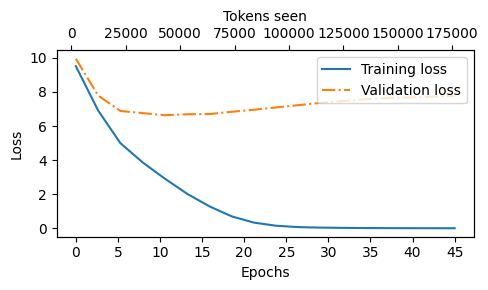

In [85]:
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator


def plot_losses(epochs_seen, tokens_seen, train_losses, val_losses):
    fig, ax1 = plt.subplots(figsize=(5, 3))

    # Plot training and validation loss against epochs
    ax1.plot(epochs_seen, train_losses, label="Training loss")
    ax1.plot(epochs_seen, val_losses, linestyle="-.", label="Validation loss")
    ax1.set_xlabel("Epochs")
    ax1.set_ylabel("Loss")
    ax1.legend(loc="upper right")
    ax1.xaxis.set_major_locator(MaxNLocator(integer=True))  # only show integer labels on x-axis

    # Create a second x-axis for tokens seen
    ax2 = ax1.twiny()  # Create a second x-axis that shares the same y-axis
    ax2.plot(tokens_seen, train_losses, alpha=0)  # Invisible plot for aligning ticks
    ax2.set_xlabel("Tokens seen")

    fig.tight_layout()  # Adjust layout to make room
    plt.show()

epochs_tensor = torch.linspace(0, num_epochs, len(train_losses))
plot_losses(epochs_tensor, tokens_seen, train_losses, val_losses)

- Looking at the results above, we can see that the model starts out generating incomprehensible strings of words, whereas towards the end, it's able to produce grammatically more or less correct sentences
- However, based on the training and validation set losses, we can see that the model starts overfitting
- If we were to check a few passages it writes towards the end, we would find that they are contained in the training set verbatim -- it simply memorizes the training data
- Later, we will cover decoding strategies that can mitigate this memorization by a certain degree
- Note that the overfitting here occurs because we have a very, very small training set, and we iterate over it so many times
  - The LLM training here primarily serves educational purposes; we mainly want to see that the model can learn to produce coherent text
  - Instead of spending weeks or months on training this model on vast amounts of expensive hardware, we load pretrained weights later

## Decoding Strategies

### Greedy Decoding
- Inference is relatively cheap with a relatively small LLM as the GPT model we trained above, so there's no need to use a GPU for it in case you used a GPU for training it above
- Using the `generate_text_simple` function (from the previous chapter) that we used earlier inside the simple training function, we can generate new text one word (or token) at a time

- Greedy will always select the largest probability score among all tokens in the vocabulary: `idx_next = torch.argmax(probas, dim=-1, keepdim=True)`

- Even if we execute the `generate_text_simple` function above multiple times, the LLM will always generate the same outputs
- We now introduce two concepts, so-called decoding strategies, to modify the `generate_text_simple`: *temperature scaling* and *top-k* sampling
- These will allow the model to control the randomness and diversity of the generated text

In [86]:
model.to(device)
model.eval()

tokenizer = tiktoken.get_encoding("gpt2")

token_ids = generate_text_simple(
    model=model,
    idx=text_to_token_ids("Every effort moves you", tokenizer).to(device),
    max_new_tokens=25,
    context_size=GPT_CONFIG_124M["context_length"]
)

print("Output text:\n", token_ids_to_text(token_ids, tokenizer))

Output text:
 Every effort moves you know," was one of the axioms he laid down across the Sevres and silver of an exquisitely appointed lun


### Temperature scaling
Let’s now look at temperature scaling, a technique that adds a probabilistic selection
process to the next-token generation task. Previously, inside the generate_text_simple
function, we always sampled the token with the highest probability as the next token
using torch.argmax, also known as greedy decoding. To generate text with more variety,
we can replace argmax with a function that samples from a probability distribution
(here, the probability scores the LLM generates for each vocabulary entry at each
token generation step).
 To illustrate the probabilistic sampling with a concrete example, let’s briefly discuss the next-token generation process using a very small vocabulary for illustration
purposes:


In [88]:
vocab = {
    "closer": 0,
    "every": 1,
    "effort": 2,
    "forward": 3,
    "inches": 4,
    "moves": 5,
    "pizza": 6,
    "toward": 7,
    "you": 8,
}

inverse_vocab = {v: k for k, v in vocab.items()}

# Suppose input is "every effort moves you", and the LLM
# returns the following logits for the next token:
next_token_logits = torch.tensor(
    [4.51, 0.89, -1.90, 6.75, 1.63, -1.62, -1.89, 6.28, 1.79]
)

probas = torch.softmax(next_token_logits, dim=0)
print('probas: ', probas)
# this is greedy decoding
next_token_id = torch.argmax(probas).item()
print('argmax (greedy decoding) next_token_id: ', next_token_id)
# The next generated token is then as follows:
print(f"looking up next_token_id {next_token_id} in inverse_vocab[next_token_id]: ", inverse_vocab[next_token_id])

probas:  tensor([    0.0609,     0.0016,     0.0001,     0.5721,     0.0034,     0.0001,
            0.0001,     0.3576,     0.0040])
argmax (greedy decoding) next_token_id:  3
looking up next_token_id 3 in inverse_vocab[next_token_id]:  forward


 To implement a probabilistic sampling process, we can now replace argmax with
the multinomial function in PyTorch:

In [89]:
torch.manual_seed(123)
# Get the tensor of three sampled IDs, but don't call .item()
next_token_ids = torch.multinomial(probas, num_samples=3)

print('Tensor of next_token_ids: ', next_token_ids)

for token_id in next_token_ids:
    # Here, token_id is a 0-dimensional tensor (e.g., tensor(42)), so .item() is correct
    print(f" - ID: {token_id.item()}, Token: {inverse_vocab[token_id.item()]}")

Tensor of next_token_ids:  tensor([3, 7, 0])
 - ID: 3, Token: forward
 - ID: 7, Token: toward
 - ID: 0, Token: closer


The printed output is "forward" just like before. 

What happened? The multinomial
function samples the next token proportional to its probability score. In other words,
"forward" is still the most likely token and will be selected by multinomial most of
the time but not all the time. To illustrate this, let’s implement a function that repeats
this sampling 1,000 times:

In [90]:
def print_sampled_tokens(probas):
    torch.manual_seed(123) # Manual seed for reproducibility
    sample = [torch.multinomial(probas, num_samples=1).item() for i in range(1_000)]
    # Count the frequency of each value in an array of non-negative ints.
    sampled_ids = torch.bincount(torch.tensor(sample))
    for i, freq in enumerate(sampled_ids):
        print(f"{freq} x {inverse_vocab[i]}")

print_sampled_tokens(probas)

73 x closer
0 x every
0 x effort
582 x forward
2 x inches
0 x moves
0 x pizza
343 x toward


- As we can see, the word forward is sampled most of the time (582 out of 1,000 times),
but other tokens such as closer, inches, and toward will also be sampled some of
the time. 

- This means that if we replaced the argmax function with the multinomial
function inside the generate_and_print_sample function, the LLM would sometimes generate texts such as every effort moves you toward, every effort moves
you inches, and every effort moves you closer instead of every effort moves you
forward.

- We can further control the distribution and selection process via a concept called
temperature scaling. Temperature scaling is just a fancy description for dividing the logits
by a number greater than 0:

In [91]:
def softmax_with_temperature(logits, temperature):
    scaled_logits = logits / temperature
    return torch.softmax(scaled_logits, dim=0)

# Temperature values
temperatures = [1, 0.1, 5]  # Original, higher confidence, and lower confidence

# Calculate scaled probabilities
scaled_probas = [softmax_with_temperature(next_token_logits, T) for T in temperatures]
scaled_probas

[tensor([    0.0609,     0.0016,     0.0001,     0.5721,     0.0034,     0.0001,
             0.0001,     0.3576,     0.0040]),
 tensor([    0.0000,     0.0000,     0.0000,     0.9910,     0.0000,     0.0000,
             0.0000,     0.0090,     0.0000]),
 tensor([0.1546, 0.0750, 0.0429, 0.2421, 0.0869, 0.0454, 0.0430, 0.2203, 0.0898])]

- Temperatures greater than 1 result in more uniformly distributed token probabilities
- Temperatures smaller than 1 will result in more confident (sharper or more peaky) distributions. 

Let’s illustrate this by plotting the original probabilities alongside probabilities scaled with different temperature values:

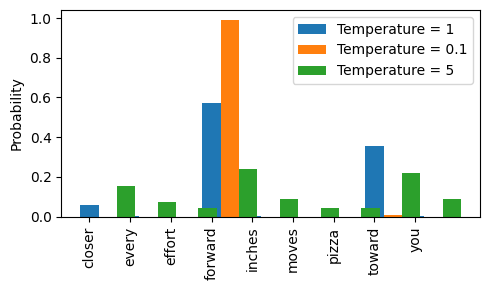

In [92]:
# Plotting
x = torch.arange(len(vocab))
bar_width = 0.45

fig, ax = plt.subplots(figsize=(5, 3))
for i, T in enumerate(temperatures):
    rects = ax.bar(x + i * bar_width, scaled_probas[i], bar_width, label=f'Temperature = {T}')

ax.set_ylabel('Probability')
ax.set_xticks(x)
ax.set_xticklabels(vocab.keys(), rotation=90)
ax.legend()

plt.tight_layout()
plt.show()

- A temperature of 1 divides the logits by 1 before passing them to the softmax function to compute the probability scores. In other words, using a temperature of 1 is the
same as not using any temperature scaling. In this case, the tokens are selected with a
probability equal to the original softmax probability scores via the multinomial sampling function in PyTorch. For example, for the temperature setting 1, the token corresponding to “forward” would be selected about 60% of the time.

- Applying very small temperatures, such as 0.1, will result in sharper distributions such that the behavior of the multinomial function selects the most likely token (here, "forward") almost 100% of the time, approaching the behavior of the argmax function. 

- Likewise, a temperature of 5 results in a more uniform distribution where other tokens are selected more often. This can add more variety to the generated texts but also more often results in nonsensical text. For example, using the temperature of 5 results in texts such as every effort moves you pizza about 4% of the time.

### Top-K sampling

- We’ve now implemented a probabilistic sampling approach coupled with temperature scaling to increase the diversity of the outputs. We saw that higher temperature values result in more uniformly distributed next-token probabilities, which result in more diverse outputs as it reduces the likelihood of the model repeatedly selecting the most
probable token. 

- This method allows for the exploring of less likely but potentially more interesting and creative paths in the generation process. However, one downside of this approach is that it sometimes leads to grammatically incorrect or completely nonsensical outputs such as `every effort moves you pizza`.

- Top-k sampling, when combined with probabilistic sampling and temperature scaling, can improve the text generation results. In top-k sampling, we can restrict the
sampled tokens to the top-k most likely tokens and exclude all other tokens from the
selection process by masking their probability scores, as illustrated in the figure below

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch05_compressed/topk.webp" style="max-width: 60%; height: auto; display: block;">

- The top-k approach replaces all nonselected logits with negative infinity value (-inf),
such that when computing the softmax values, the probability scores of the non-top-k tokens are 0, and the remaining probabilities sum up to 1. (Careful readers may
remember this masking trick from the causal attention module we implemented in the Causal attention part)

Top-K can be implemented as following:

In [93]:
top_k = 3
top_logits, top_pos = torch.topk(next_token_logits, top_k)
print("Top logits:", top_logits)
print("Top positions:", top_pos)

Top logits: tensor([6.7500, 6.2800, 4.5100])
Top positions: tensor([3, 7, 0])


- The logits values and token IDs of the top three tokens, in descending order, are shown above.

- Subsequently, we apply PyTorch’s where function to set the logit values of tokens that are
below the lowest logit value within our top-three selection to negative infinity (-inf): 

In [94]:
new_logits = torch.where(
 condition=next_token_logits < top_logits[-1], #Identifies logits less than the minimum in the top 3
 input=torch.tensor(float('-inf')), # Assigns –inf to these lower logits
 other=next_token_logits # Retains the original logits for all other tokens
)
print(f'{new_logits=}')
topk_probas = torch.softmax(new_logits, dim=0)
print(f'{topk_probas=}')

new_logits=tensor([4.5100,   -inf,   -inf, 6.7500,   -inf,   -inf,   -inf, 6.2800,   -inf])
topk_probas=tensor([0.0615, 0.0000, 0.0000, 0.5775, 0.0000, 0.0000, 0.0000, 0.3610, 0.0000])


> NOTE:  
>
>  An alternative, slightly more efficient implementation of the previous code cell is the following:
>
> ```python
> new_logits = torch.full_like( # create tensor containing -inf values
>    next_token_logits, -torch.inf
>)   
> new_logits[top_pos] = next_token_logits[top_pos] # copy top k values into the -inf tensor
> ```
> <br>
> For more details, see https://github.com/rasbt/LLMs-from-scratch/discussions/326

We can apply the temperature scaling and multinomial function for probabilistic
sampling to select the next token among these three non-zero probability scores to
generate the next token. 

Now, let’s combine temperature scaling and top-k sampling to modify the generate_
text_simple function we used to generate text via the LLM earlier, creating a new
generate function

In [95]:
def generate(model, idx, max_new_tokens, context_size, temperature=0.0, top_k=None, eos_id=None, device="mps"):

    # For-loop is the same as before: Get logits, and only focus on last time step
    for _ in range(max_new_tokens):
        idx_cond = idx[:, -context_size:]
        with torch.no_grad():
            logits = model(idx_cond)
        logits = logits[:, -1, :]

        # New: Filter logits with top_k sampling
        if top_k is not None:
            # Keep only top_k values
            top_logits, _ = torch.topk(logits, top_k)
            min_val = top_logits[:, -1]
            logits = torch.where(logits < min_val, torch.tensor(float("-inf")).to(logits.device), logits)

        # New: Apply temperature scaling
        if temperature > 0.0:
            logits = logits / temperature

            # Apply softmax to get probabilities
            probs = torch.softmax(logits, dim=-1)  # (batch_size, context_len)

            # Sample from the distribution
            idx_next = torch.multinomial(probs, num_samples=1)  # (batch_size, 1)

        # Otherwise same as before: get idx of the vocab entry with the highest logits value
        else:
            idx_next = torch.argmax(logits, dim=-1, keepdim=True)  # (batch_size, 1)

        if idx_next == eos_id:  # Stop generating early if end-of-sequence token is encountered and eos_id is specified
            break

        # Same as before: append sampled index to the running sequence
        idx = torch.cat((idx, idx_next), dim=1)  # (batch_size, num_tokens+1)

    return idx

In [97]:
torch.manual_seed(123)
model.to(device)
model.eval()

token_ids = generate(
    model=model,
    idx=text_to_token_ids("Every effort moves you", tokenizer).to(device),
    max_new_tokens=15,
    context_size=GPT_CONFIG_124M["context_length"],
    top_k=25,
    temperature=1.4
)

print("Output text:\n", token_ids_to_text(token_ids, tokenizer))

Output text:
 Every effort moves you know," was one of the axioms he laid down across the Sev


As we can see, the generated text is very different from the one we previously generated via the generate_simple function in section 5.3 ("Every effort moves you know,"
was one of the axioms he laid...! ), which was a memorized passage from the training set

### Top-P sampling
* Top-k sampling restricts the model’s choices to the top k most probable tokens at each step, introducing controlled randomness.
* For example, setting k=10 means the model will only consider the 10 most likely tokens. Nucleus sampling, or top-p sampling, takes a more dynamic approach by selecting tokens whose cumulative probability exceeds a threshold p (e.g., 0.9). T
* his allows for flexible candidate sets based on context, promoting both diversity and coherence in generated text.

### Speculative Decoding

Imagine you have a brilliant but very slow expert (the **Large Language Model** or **LLM**) who needs to write a long report. To speed things up, you hire a fast but less accurate intern (a much **smaller, faster model**).

Here's the workflow:

1.  **The Intern Drafts:** The intern quickly writes a short paragraph (a few words or tokens).
2.  **The Expert Reviews:** The expert, instead of writing one word at a time, reads the intern's entire paragraph at once.
3.  **The Expert Checks:** As the expert reads, they check the intern's work.
    *   "This word is correct... this one too... and this one." They approve a chunk of correct words all at once.
    *   "Whoa, this fourth word is wrong." The expert stops, throws away the wrong word and everything after it, and writes the *correct* fourth word themself.
4.  **Repeat:** The process starts over. The intern takes the corrected text and quickly drafts the next few words.

This is the essence of speculative decoding. It's much faster because the slow, powerful "expert" model gets to approve multiple words in a single step, instead of generating them one by one.

---

#### The Technical Explanation

Speculative decoding is a technique used to **speed up the generation of text from Large Language Models (LLMs)** without changing their output quality. It tackles the primary bottleneck of LLMs: **latency**.

##### The Problem: Standard (Autoregressive) Decoding

Normally, LLMs generate text one token (a word or part of a word) at a time. This process is called **autoregressive decoding**.

*   To generate Token #5, the model needs to know Tokens #1, #2, #3, and #4.
*   To generate Token #6, it needs to know Tokens #1 through #5.

This is a fundamentally **serial** process. The model has to complete a full, computationally expensive "forward pass" to generate each new token. This is slow, especially for real-time applications like chatbots.

##### The Solution: Speculative Decoding

Speculative decoding introduces a second, smaller "draft model" to work alongside the main "target model."

**The Players:**
*   **Target Model:** The large, powerful, and accurate LLM you want to use (e.g., GPT-4, Llama 3 70B). This is our "expert."
*   **Draft Model:** A much smaller, faster, but less accurate model (e.g., a 1-billion-parameter model). This is our "intern."

**The Step-by-Step Process:**

1.  **Drafting (Speculation):** The small, fast draft model generates a sequence of *k* candidate tokens (e.g., 5 tokens). This is the "speculation" or the draft.
    > Example: `The quick brown fox jumps` -> (draft model guesses) -> `over the lazy dog.`

2.  **Verification (in Parallel):** The large target model takes the original input *plus the entire draft sequence* and performs a **single forward pass**. In this one pass, it calculates the probability of what the *next* token should be at each position in the draft.
    > Example: The target model evaluates:
    > *   After `...jumps`, is `over` the right token?
    > *   After `...jumps over`, is `the` the right token?
    > *   After `...jumps over the`, is `lazy` the right token?
    > *   ...and so on.

3.  **Checking and Accepting:** The system compares the draft model's guesses with the target model's calculations.
    *   If the draft model's first token (`over`) matches the target model's top choice, it's accepted.
    *   If the second token (`the`) also matches, it's accepted.
    *   This continues until a mismatch is found. Let's say the draft model guessed `dog.`, but the target model's top choice was `cat.`.

4.  **Correcting and Moving On:**
    *   All tokens up to the mismatch (`over the lazy`) are accepted and added to the final output.
    *   The draft model's incorrect guess (`dog.`) and anything after it are discarded.
    *   The target model's correct token (`cat.`) is added to the output.
    *   The process repeats from this new point.

#### Why is this Faster?

The speed-up comes from **parallelism**. While the draft model's work is serial, the expensive target model gets to **verify multiple tokens in a single forward pass**.

The bottleneck in LLMs is often not the computation itself, but loading the massive model weights from memory.
*   **Standard Decoding:** Load weights -> generate 1 token. Load weights -> generate 1 token.
*   **Speculative Decoding:** Load weights -> verify **N** tokens.

If the draft model is decent and gets 4 tokens right on average, you get a **~4x speed-up** because you generated 4 tokens with the cost of one pass from the large model.

#### Summary Table

| Characteristic | Standard (Autoregressive) Decoding | Speculative Decoding |
| :--- | :--- | :--- |
| **Models Used** | One (the large target model) | Two (a large target model and a small draft model) |
| **Process** | Serial: Generates one token per pass. | Parallel Verification: Drafts a chunk, then verifies all at once. |
| **Speed / Latency** | Slow, limited by single-token generation. | **Much faster** (typically 2-4x), depending on draft model accuracy. |
| **Output Quality** | Determined by the target model. | **Identical to the target model.** It's a "lossless" acceleration. |
| **Memory Usage** | Lower (only one model in memory). | Higher (requires holding two models in memory). |
| **Best For** | Scenarios where latency is not the primary concern. | Real-time applications like chatbots, co-pilots, and interactive tools. |

In short, **speculative decoding is a clever trick to get the speed of a small model with the quality of a large model.**



#### The High-Level Goal of Verification

The goal is to answer this question as efficiently as possible:

> "How many of the intern's (draft model's) guessed tokens would the expert (target model) have written in the exact same order?"

The magic is that we can answer this for a whole chunk of tokens at once, instead of asking one by one.

##### The Key Insight: Parallel Processing with a Single "Forward Pass"

The verification process hinges on a key feature of the Transformer architecture (which powers most LLMs). It can process a whole sequence of tokens in parallel.

When we give the target model the combined text (original prompt + draft), it doesn't just predict the single next token at the very end. In one single computation (a "forward pass"), it calculates the probability distribution for the next token *at every single position in the sequence*.

Let's walk through it with a concrete example.

---

##### Step-by-Step Mechanism of Verification

**Players:**
*   **Prompt (P):** `"The dog chased the"`
*   **Draft Model (D):** Our small, fast model.
*   **Target Model (T):** Our large, accurate model.

---

**Step 1: The Draft Model Guesses (Speculation)**

The draft model `D` takes the prompt `P` and quickly generates a few candidate tokens. Let's say it generates a draft of 4 tokens:

*   **Draft (d1, d2, d3, d4):** `ball`, `across`, `the`, `park`

---

**Step 2: The Target Model's Single Forward Pass (Verification)**

Now, we give the **target model `T`** the entire combined sequence as input:

*   **Input to T:** `"The dog chased the ball across the park"`

The target model `T` processes this entire sequence at once. The output is a set of probability distributions for what token *should have come next* at each position.

*   After `...chased the`: **T calculates `Probabilities_1`** (what should `d1` be?)
*   After `...the ball`: **T calculates `Probabilities_2`** (what should `d2` be?)
*   After `...ball across`: **T calculates `Probabilities_3`** (what should `d3` be?)
*   After `...across the`: **T calculates `Probabilities_4`** (what should `d4` be?)

Let's imagine the results of these calculations:

| Position | Draft Model's Guess | Target Model's Top Choice (from its calculated probabilities) | Match? |
| :--- | :--- | :--- | :--- |
| **d1** | `ball` | `ball` (98% probability) | **Yes** |
| **d2** | `across` | `across` (95% probability) | **Yes** |
| **d3** | `the` | `the` (99% probability) | **Yes** |
| **d4** | `park` | `field` (60% probability) | **No** |

---

**Step 3: The Comparison Loop (The "Check")**

The system now simply walks through the draft and compares it to the target model's choices, token by token.

1.  **Check `d1`:** Is `ball` the top choice in `Probabilities_1`? **Yes.**
    *   **Action:** Accept `ball`.

2.  **Check `d2`:** Is `across` the top choice in `Probabilities_2`? **Yes.**
    *   **Action:** Accept `across`.

3.  **Check `d3`:** Is `the` the top choice in `Probabilities_3`? **Yes.**
    *   **Action:** Accept `the`.

4.  **Check `d4`:** Is `park` the top choice in `Probabilities_4`? **No.** The target model preferred `field`.
    *   **Action:** **STOP.** The speculation has failed at this point.

---

**Step 4: The Final Output for this Cycle**

1.  **Accept the Prefix:** The tokens that matched (`ball`, `across`, `the`) are accepted and become part of the final output.
2.  **Discard the Rest:** The incorrect guess (`park`) and any subsequent draft tokens are thrown away.
3.  **Apply the Correction:** The system now needs to generate one token. Instead of running another pass, it simply takes the token the target model already calculated as the correct one at the point of the mismatch. In our example, this is `field`.
4.  **The new text is:** `"The dog chased the ball across the field"`

The entire process now repeats, starting from this new, longer text.

##### Summary of the Verification Flow

1.  **Draft:** Small model generates `k` tokens.
2.  **Parallel Pass:** Large model takes the prompt + all `k` draft tokens and computes `k` next-token probability distributions in one go.
3.  **Iterative Check:** Loop from `i=1` to `k`. If draft token `i` matches the large model's top choice for position `i`, continue.
4.  **On Mismatch:** Stop the loop. Accept all tokens before the mismatch. Generate the one correct token from the large model's pre-computed probabilities.
5.  **Restart:** Begin a new speculation cycle from the newly generated text.

This method is so effective because the most expensive operation—the forward pass of the large model—is used to validate (and potentially accept) **multiple tokens**, dramatically reducing the number of passes needed to generate a long sequence of text.

#### Implementation Details


**Start of Loop Iteration**
*   **Initial State:** The loop begins with the current sequence of generated text, `idx`.



**Step A: Drafting**
*   **Input:** The current `idx`.
*   **Process:** The `⏩ Draft Model` autoregressively generates `k` new tokens.
*   **Output ->** A sequence of `draft_tokens`.



**Step B: Verification**
*   **Process:**
    1.  The original `idx` is concatenated with the new `draft_tokens`.
    2.  This creates a single, longer sequence: `verification_idx`.
*   **Input ->** `verification_idx` is fed into the `🧠 Target Model`.
*   **Process:** The Target Model performs **one single forward pass** on the entire sequence.
*   **Output ->** A tensor of `target_logits` (predictions for each token position).


**Step C: Compare & Accept**
*   **Input:** `draft_tokens` and `target_logits`.
*   **Process:** A loop runs up to `k` times, comparing the draft with the target's predictions:
    *   `draft_token[i]` is compared with `argmax(target_prediction_for_token_i)`.
    *   The loop breaks at the first mismatch.
*   **Output ->** A number, `n_accepted`, counting the correctly guessed tokens.


**Step D: Correct & Append**
*   **Input:** `n_accepted` and `target_logits`.
*   **Process:**
    1.  The first `n_accepted` tokens from the draft are appended to the main text `idx`.
    2.  The single "correction" token (which the Target Model predicted at the point of the first mismatch) is also appended to `idx`.
*   **Output ->** The new, updated `idx`.


**Loop Continuation**
*   The new `idx` becomes the starting point for the next iteration.
*   The entire process repeats from **Step A** until the `max_new_tokens` limit is reached.

In [108]:
def generate_text_speculative(
    target_model,   # The large, accurate model
    draft_model,    # The small, fast model
    idx,
    max_new_tokens,
    context_size,
    k: int           # The number of tokens to speculate
):
    """
    Generates text using speculative decoding. (Corrected Version)
    """
    # Generate until the total length (initial + new) is reached
    final_len = idx.shape[1] + max_new_tokens
    
    while idx.shape[1] < final_len:
        
        # --- STEP A: DRAFTING ---
        print("Drafting: ")
        drafter_idx = idx
        # Ensure we don't draft more tokens than needed
        current_k = min(k, final_len - idx.shape[1])
        if current_k == 0: break

        for _ in range(current_k):
            idx_cond = drafter_idx[:, -context_size:]
            with torch.no_grad():
                drafter_logits = draft_model(idx_cond)
            drafter_logits = drafter_logits[:, -1, :]
            probas = torch.softmax(drafter_logits, dim=-1)
            idx_next = torch.argmax(probas, dim=-1, keepdim=True)
            drafter_idx = torch.cat((drafter_idx, idx_next), dim=1)

        # (B, idx + k)
        #  `-current_k:` means start at the token k positions from the end, and give me everything from that point to the very end.
        # give me the last current_k tokens
        drafter_tokens = drafter_idx[:, -current_k:]
        # print(f"Draft Tokens shape: {draft_tokens.shape}")
        
        # --- STEP B: VERIFICATION ---
        verification_idx = torch.cat((idx, drafter_tokens), dim=1)
        print(f" - Verification Tokens shape: {verification_idx.shape}")
        with torch.no_grad():
            target_logits = target_model(verification_idx[:, -context_size:])
            print(f" - Target Logits shape: {target_logits.shape}")

        # --- STEP C: COMPARE & ACCEPT ---
        n_accepted = 0
        for i in range(current_k):
            # Use negative indexing. It's robust to cropping.
            # The logit that PREDICTS the i-th draft token is at index: -current_k - 1 + i
            # give me the drafted logits for token i
            logit_for_draft_i = target_logits[:, -current_k - 1 + i, :]
            print(" - Logit_for_draft_i shape: ", logit_for_draft_i.shape)
            # apply the same decoding strategy
            # softmax was skipped here since its greedy, its redundant since argmax will find the index with the highest logit or proba
            target_pred_i = torch.argmax(logit_for_draft_i, dim=-1)
            draft_token_i = drafter_tokens[:, i]
            print(f" - Draft token_i:  {draft_token_i.item()} , Target_pred_i logit: {target_pred_i.item()}")
            # check we have the same token id
            if target_pred_i == draft_token_i:
                n_accepted += 1
            else:
                break
        
        print(f" - Speculative step: Accepted {n_accepted}/{current_k} tokens.")

        # --- STEP D: CORRECT & APPEND ---
        # Append all the verified tokens from the draft
        accepted_tokens = drafter_tokens[:, :n_accepted]
        idx = torch.cat((idx, accepted_tokens), dim=1)

        if idx.shape[1] >= final_len:
            break

        # The token to append is the one PREDICTED by the target model at the first point of failure.
        # This single line of logic correctly handles both cases (mismatch or all accepted).
        # The position of this logit is -current_k - 1 + n_accepted
        correction_logit = target_logits[:, -current_k - 1 + n_accepted, :]
        correction_token = torch.argmax(correction_logit, dim=-1, keepdim=True)
        idx = torch.cat((idx, correction_token), dim=1)
        
    # Final trim to ensure exact length
    return idx[:, :final_len]

In [109]:
import torch
import torch.nn as nn
import time
import random

# --- Mock Models for Demonstration ---
class SimpleModel(nn.Module):
    def __init__(self, vocab_size, embed_size, context_size):
        super().__init__()
        self.token_embedding_table = nn.Embedding(vocab_size, embed_size)
        self.position_embedding_table = nn.Embedding(context_size, embed_size)
        self.lm_head = nn.Linear(embed_size, vocab_size)
    
    def forward(self, idx):
        B, T = idx.shape
        tok_emb = self.token_embedding_table(idx)
        # In a real model, there would be transformer blocks here
        logits = self.lm_head(tok_emb)
        return logits

# Since the models are not trained, this is the worst scenario where the distributions are completely off
# so we need a 50% acceptance rate
class SimulatedDraftModel(nn.Module):
    """
    A wrapper model to simulate an imperfect draft model.
    """
    def __init__(self, base_draft_model, target_model, success_rate=0.5):
        super().__init__()
        self.base_draft_model = base_draft_model # The small, random model
        self.target_model = target_model         # The large, correct model
        self.success_rate = success_rate

    def forward(self, idx):
        # This is the "coin flip"
        if random.random() < self.success_rate:
            # On success, it "cheats" and returns the target model's output,
            # guaranteing its prediction will match the target's.
            return self.target_model(idx)
        else:
            # On failure, it returns its own random output,
            # which will almost certainly not match the target's.
            return self.base_draft_model(idx)

# --- Setup ---
VOCAB_SIZE = 1000
CONTEXT_SIZE = 20
MAX_NEW_TOKENS = 50

# The target model is "larger" (larger embedding size)
target_model = SimpleModel(vocab_size=VOCAB_SIZE, embed_size=128, context_size=CONTEXT_SIZE)
# The draft model is "smaller"
draft_model = SimpleModel(vocab_size=VOCAB_SIZE, embed_size=32, context_size=CONTEXT_SIZE)

# 2. Create our simulated 50% success-rate draft model
# Since the models are not trained, this is the worst scenario where the distributions are completely off
# so we need a 50% acceptance rate
draft_model = SimulatedDraftModel(
    base_draft_model=draft_model,
    target_model=target_model,
    success_rate=0.65 # change this to simulate and check the speed
)

# Starting context (a single "start" token for a batch size of 1)
idx = torch.zeros((1, 1), dtype=torch.long)

# --- Run Standard Generation ---
print("--- Running Standard (Autoregressive) Generation ---")
start_time = time.time()
simple_result = generate_text_simple(target_model, idx, MAX_NEW_TOKENS, CONTEXT_SIZE)
end_time = time.time()
print(f"Generated sequence length: {simple_result.shape[1]}")
print(f"Time taken: {end_time - start_time:.4f} seconds\n")


# --- Run Speculative Decoding ---
print("--- Running Speculative Decoding ---")
# Let's speculate 4 tokens at a time
K = 4
start_time = time.time()
speculative_result = generate_text_speculative(target_model, draft_model, idx, MAX_NEW_TOKENS, CONTEXT_SIZE, k=K)
end_time = time.time()
print(f"\nGenerated sequence length: {speculative_result.shape[1]}")
print(f"Time taken: {end_time - start_time:.4f} seconds")

# In a real-world scenario with a large model and GPU, the speculative version
# would be significantly faster because it reduces the number of expensive forward passes.
# The speedup is proportional to the average number of accepted tokens.

--- Running Standard (Autoregressive) Generation ---
Generated sequence length: 51
Time taken: 0.0044 seconds

--- Running Speculative Decoding ---
Drafting: 
 - Verification Tokens shape: torch.Size([1, 5])
 - Target Logits shape: torch.Size([1, 5, 1000])
 - Logit_for_draft_i shape:  torch.Size([1, 1000])
 - Draft token_i:  827 , Target_pred_i logit: 827
 - Logit_for_draft_i shape:  torch.Size([1, 1000])
 - Draft token_i:  244 , Target_pred_i logit: 244
 - Logit_for_draft_i shape:  torch.Size([1, 1000])
 - Draft token_i:  894 , Target_pred_i logit: 894
 - Logit_for_draft_i shape:  torch.Size([1, 1000])
 - Draft token_i:  614 , Target_pred_i logit: 614
 - Speculative step: Accepted 4/4 tokens.
Drafting: 
 - Verification Tokens shape: torch.Size([1, 10])
 - Target Logits shape: torch.Size([1, 10, 1000])
 - Logit_for_draft_i shape:  torch.Size([1, 1000])
 - Draft token_i:  342 , Target_pred_i logit: 342
 - Logit_for_draft_i shape:  torch.Size([1, 1000])
 - Draft token_i:  404 , Target_pr

**Implementation choice of `-current_k - 1**

The Golden Rule of Autoregressive Models:


First, we must remember the fundamental rule of how models like this work:

> **The output (logit) at position `i` is the model's prediction for the token at position `i+1`.**

There is an "off-by-one" relationship. The model looks at all tokens *up to and including* token `A` to predict token `B`.

```
Input Tokens: [  Token_A,   Token_B,   Token_C  ]
              |          |          |
              v          v          v
Output Logits: [ Logit(B),  Logit(C),  Logit(D) ]
```
So, `logits[0]` predicts `Token_B`, `logits[1]` predicts `Token_C`, and so on.

**Visualizing Our Tensors**


Now, let's visualize the `target_logits` tensor during one step of our loop. Imagine `current_k = 4`. The input to the target model was `(context + 4 draft tokens)`. The output `target_logits` has predictions for each of those positions.

Let's focus only on the end of the `target_logits` tensor, which is what we care about.

```
--------------------------------------------------------------------------------------------
| ... other logits ... | Logit for D_0 | Logit for D_1 | Logit for D_2 | Logit for D_3 | Logit for token AFTER D_3 |
--------------------------------------------------------------------------------------------
^                                                                                          ^
Start of tensor                                                                    End of tensor
(Index 0)                                                                         (Index -1)
```

Where `D_0`, `D_1`, `D_2`, `D_3` are the four draft tokens.

**Applying Negative Indexing:**


Negative indexing in Python and PyTorch counts backward from the end of the tensor. Let's label our diagram with negative indices:

```
Index: ... |    -5     |     -4      |     -3      |     -2      |             -1              |
--------------------------------------------------------------------------------------------
Content:   | L(for D_0)| L(for D_1)  | L(for D_2)  | L(for D_3)  | L(for token AFTER D_3)      |
--------------------------------------------------------------------------------------------
```

This diagram reveals the whole pattern:
*   The logit for the token **AFTER** the draft is at index **-1**.
*   The logit for the **last** draft token (`D_3`) is at index **-2**.
*   The logit for the **second-to-last** draft token (`D_2`) is at index **-3**.
*   ...and so on.
*   The logit for the **first** draft token (`D_0`) is at index **-5**.

**Deriving the Formula:**

Now, how do we get from `k=4` to the starting index `-5`?

**The formula is `-k - 1`**.

If `k=4`, then `-k - 1` is `-4 - 1 = -5`. This correctly gives us the index of the logit that predicts the **very first draft token**.

This is our anchor point. `-current_k - 1` is the starting index for the block of logits that corresponds to our draft.

Now, to get the logit for the `i`-th draft token (where `i` goes from 0 to 3), we just add `i` to our starting point:

`logit_index = -current_k - 1 + i`

Let's test it:
*   For the **1st** draft token (`i=0`): index is `-4 - 1 + 0 = -5`. **Correct.**
*   For the **2nd** draft token (`i=1`): index is `-4 - 1 + 1 = -4`. **Correct.**
*   For the **3rd** draft token (`i=2`): index is `-4 - 1 + 2 = -3`. **Correct.**
*   For the **4th** draft token (`i=3`): index is `-4 - 1 + 3 = -2`. **Correct.**

This is why the line `logit_for_draft_i = target_logits[:, -current_k - 1 + i, :]` works perfectly to iterate through the predictions for each of the draft tokens.

And as we saw before, this same formula `...-current_k - 1 + n_accepted` also magically gives us the correct token for the correction step, whether it's a mismatch or the token after a full successful draft.

## Loading and Saving Model Weights

- The recommended way in PyTorch is to save the model weights, the so-called `state_dict` via by applying the `torch.save` function to the `.state_dict()` method

- "model.pth" is the filename where the state_dict is saved. 

- The .pth extension is a convention for PyTorch files, though we could technically use any file extension.

- Then, after saving the model weights via the state_dict, we can load the model weights into a new GPTModel model instance

In [110]:
torch.save(model.state_dict(), "model.pth")

In [111]:
model = GPTModel(GPT_CONFIG_124M)
model.load_state_dict(torch.load("model.pth", map_location=device))
model.eval()

GPTModel(
  (tok_emb): Embedding(50257, 768)
  (pos_emb): Embedding(1024, 768)
  (drop_emb): Dropout(p=0.1, inplace=False)
  (trf_blocks): Sequential(
    (0): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=False)
        (W_key): Linear(in_features=768, out_features=768, bias=False)
        (W_value): Linear(in_features=768, out_features=768, bias=False)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.1, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.1, inplace=False)
    )
    (1): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=False)
        (W_key): Linear(in_features=768, out_features=768, bias=False)
        (W_value): Linear(in_features=768, out_features=768, bias=False)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.1, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.1, inplace=False)
    )
    (2): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=False)
        (W_key): Linear(in_features=768, out_features=768, bias=False)
        (W_value): Linear(in_features=768, out_features=768, bias=False)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.1, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.1, inplace=False)
    )
    (3): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=False)
        (W_key): Linear(in_features=768, out_features=768, bias=False)
        (W_value): Linear(in_features=768, out_features=768, bias=False)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.1, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.1, inplace=False)
    )
    (4): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=False)
        (W_key): Linear(in_features=768, out_features=768, bias=False)
        (W_value): Linear(in_features=768, out_features=768, bias=False)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.1, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.1, inplace=False)
    )
    (5): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linea

- As discussed previously dropout helps prevent the model from overfitting to the training data by randomly “dropping out” of a layer’s neurons during training. However, during inference, we don’t want to randomly drop out any of the information the network has learned. 

- Using model.eval() switches the model to evaluation mode for inference, disabling the dropout layers of the model. 

- If we plan to continue pretraining a model later—for example, using the train_model_simple function we defined earlier in this chapter—saving the optimizer state is also recommended.

- Adaptive optimizers such as AdamW store additional parameters for each model weight. AdamW uses historical data to adjust learning rates for each model parameter dynamically. Without it, the optimizer resets, and the model may learn suboptimally or even fail to converge properly, which means it will lose the ability to generate coherent text. 

- Using torch.save, we can save both the model and optimizer state_dict contents:

In [112]:
torch.save({
 "model_state_dict": model.state_dict(),
 "optimizer_state_dict": optimizer.state_dict(),
 },
 "model_and_optimizer.pth"
)

In [113]:
checkpoint = torch.load("model_and_optimizer.pth", map_location=device)
model = GPTModel(GPT_CONFIG_124M)
model.load_state_dict(checkpoint["model_state_dict"])
optimizer = torch.optim.AdamW(model.parameters(), lr=5e-4, weight_decay=0.1)
optimizer.load_state_dict(checkpoint["optimizer_state_dict"])
model.train();

# Loading weights from OpenAI


In [114]:
%pip install transformers

Note: you may need to restart the kernel to use updated packages.


In [115]:
from transformers import GPT2Model


# allowed model names
model_names = {
    "gpt2-small (124M)": "openai-community/gpt2",
    "gpt2-medium (355M)": "openai-community/gpt2-medium",
    "gpt2-large (774M)": "openai-community/gpt2-large",
    "gpt2-xl (1558M)": "openai-community/gpt2-xl"
}

CHOOSE_MODEL = "gpt2-small (124M)"

gpt_hf = GPT2Model.from_pretrained(model_names[CHOOSE_MODEL], cache_dir="checkpoints")
gpt_hf.eval()



/Users/charbelk/dev/understanding_transformer/venv/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


GPT2Model(
  (wte): Embedding(50257, 768)
  (wpe): Embedding(1024, 768)
  (drop): Dropout(p=0.1, inplace=False)
  (h): ModuleList(
    (0-11): 12 x GPT2Block(
      (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
      (attn): GPT2Attention(
        (c_attn): Conv1D(nf=2304, nx=768)
        (c_proj): Conv1D(nf=768, nx=768)
        (attn_dropout): Dropout(p=0.1, inplace=False)
        (resid_dropout): Dropout(p=0.1, inplace=False)
      )
      (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
      (mlp): GPT2MLP(
        (c_fc): Conv1D(nf=3072, nx=768)
        (c_proj): Conv1D(nf=768, nx=3072)
        (act): NewGELUActivation()
        (dropout): Dropout(p=0.1, inplace=False)
      )
    )
  )
  (ln_f): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
)

By default, the GPTModel instance is initialized with random weights for pretraining.
The last step to using OpenAI’s model weights is to override these random weights
with the weights we loaded into the params dictionary. For this, we will first define a
small assign utility function that checks whether two tensors or arrays (left and
right) have the same dimensions or shape and returns the right tensor as trainable
PyTorch parameters:

In [116]:
def assign_check(left, right):
    if left.shape != right.shape:
        raise ValueError(f"Shape mismatch. Left: {left.shape}, Right: {right.shape}")
    return torch.nn.Parameter(right.clone().detach())

In [117]:
BASE_CONFIG = {
    "vocab_size": 50257,    # Vocabulary size
    "context_length": 1024, # Context length
    "drop_rate": 0.0,       # Dropout rate
    "qkv_bias": True        # Query-key-value bias
}

model_configs = {
    "gpt2-small (124M)": {"emb_dim": 768, "n_layers": 12, "n_heads": 12},
    "gpt2-medium (355M)": {"emb_dim": 1024, "n_layers": 24, "n_heads": 16},
    "gpt2-large (774M)": {"emb_dim": 1280, "n_layers": 36, "n_heads": 20},
    "gpt2-xl (1558M)": {"emb_dim": 1600, "n_layers": 48, "n_heads": 25},
}


BASE_CONFIG.update(model_configs[CHOOSE_MODEL])

* we define a load_weights_into_gpt function that loads the weights from the params dictionary into a GPTModel instance gpt.
* In the load_weights_into_gpt function, we carefully match the weights from OpenAI’s implementation with our GPTModel implementation. To pick a specific example, OpenAI stored the weight tensor for the output projection layer for the first transformer block as params["blocks"][0]["attn"]["c_proj"]["w"]. In our implementation, this weight tensor corresponds to gpt.trf_blocks[b].att.out_proj.weight, where gpt is a GPTModel instance.
* Developing the load_weights_into_gpt function took a lot of guesswork since OpenAI used a slightly different naming convention from ours. However, the assign function would alert us if we try to match two tensors with different dimensions. 
* if we made a mistake in this function, we would notice this, as the resulting GPT model would be unable to produce coherent text.

In [118]:
import numpy as np


def load_weights(gpt, gpt_hf):

    d = gpt_hf.state_dict()

    gpt.pos_emb.weight = assign_check(gpt.pos_emb.weight, d["wpe.weight"])
    gpt.tok_emb.weight = assign_check(gpt.tok_emb.weight, d["wte.weight"])
    
    for b in range(BASE_CONFIG["n_layers"]):
        q_w, k_w, v_w = np.split(d[f"h.{b}.attn.c_attn.weight"], 3, axis=-1)
        gpt.trf_blocks[b].att.W_query.weight = assign_check(gpt.trf_blocks[b].att.W_query.weight, q_w.T)
        gpt.trf_blocks[b].att.W_key.weight = assign_check(gpt.trf_blocks[b].att.W_key.weight, k_w.T)
        gpt.trf_blocks[b].att.W_value.weight = assign_check(gpt.trf_blocks[b].att.W_value.weight, v_w.T)
    
        q_b, k_b, v_b = np.split(d[f"h.{b}.attn.c_attn.bias"], 3, axis=-1)
        gpt.trf_blocks[b].att.W_query.bias = assign_check(gpt.trf_blocks[b].att.W_query.bias, q_b)
        gpt.trf_blocks[b].att.W_key.bias = assign_check(gpt.trf_blocks[b].att.W_key.bias, k_b)
        gpt.trf_blocks[b].att.W_value.bias = assign_check(gpt.trf_blocks[b].att.W_value.bias, v_b)
    
    
        gpt.trf_blocks[b].att.out_proj.weight = assign_check(gpt.trf_blocks[b].att.out_proj.weight, d[f"h.{b}.attn.c_proj.weight"].T)
        gpt.trf_blocks[b].att.out_proj.bias = assign_check(gpt.trf_blocks[b].att.out_proj.bias, d[f"h.{b}.attn.c_proj.bias"])
    
        gpt.trf_blocks[b].ff.layers[0].weight = assign_check(gpt.trf_blocks[b].ff.layers[0].weight, d[f"h.{b}.mlp.c_fc.weight"].T)
        gpt.trf_blocks[b].ff.layers[0].bias = assign_check(gpt.trf_blocks[b].ff.layers[0].bias, d[f"h.{b}.mlp.c_fc.bias"])
        gpt.trf_blocks[b].ff.layers[2].weight = assign_check(gpt.trf_blocks[b].ff.layers[2].weight, d[f"h.{b}.mlp.c_proj.weight"].T)
        gpt.trf_blocks[b].ff.layers[2].bias = assign_check(gpt.trf_blocks[b].ff.layers[2].bias, d[f"h.{b}.mlp.c_proj.bias"])
    
        gpt.trf_blocks[b].norm1.scale = assign_check(gpt.trf_blocks[b].norm1.scale, d[f"h.{b}.ln_1.weight"])
        gpt.trf_blocks[b].norm1.shift = assign_check(gpt.trf_blocks[b].norm1.shift, d[f"h.{b}.ln_1.bias"])
        gpt.trf_blocks[b].norm2.scale = assign_check(gpt.trf_blocks[b].norm2.scale, d[f"h.{b}.ln_2.weight"])
        gpt.trf_blocks[b].norm2.shift = assign_check(gpt.trf_blocks[b].norm2.shift, d[f"h.{b}.ln_2.bias"])
    
        gpt.final_norm.scale = assign_check(gpt.final_norm.scale, d["ln_f.weight"])
        gpt.final_norm.shift = assign_check(gpt.final_norm.shift, d["ln_f.bias"])
        gpt.out_head.weight = assign_check(gpt.out_head.weight, d["wte.weight"])

In [119]:
gpt = GPTModel(BASE_CONFIG)
load_weights(gpt, gpt_hf)

In [120]:
token_ids = generate(
    model=gpt.to(device),
    idx=text_to_token_ids("Every effort moves", tokenizer).to(device),
    max_new_tokens=30,
    context_size=BASE_CONFIG["context_length"],
    top_k=1,
    temperature=1.0
)

print("Output text:\n", token_ids_to_text(token_ids, tokenizer))

Output text:
 Every effort moves �weenizo Growth Latinhardtarettesweenainaeneggerhopsamonginianinianinianinianinianinianinianinianinianinianinianinianinianinianinianinianinianinian


# Distillation

- Model distillation is a technique where a smaller, simpler model (student) is trained to replicate the behavior of a larger, more complex model (teacher). 
- In the context of LLMs, the student model learns from the teacher’s soft predictions rather than hard labels, capturing nuanced knowledge. 
- This approach reduces computational requirements and memory usage while maintaining similar performance, making it ideal for deploying LLMs on resource constrained devices.

## Soft Labels

**soft labels are the full probability distributions** predicted by the teacher model.

They are "soft" because they are not a single, definite "hard" answer but rather a nuanced set of probabilities that reveal how the teacher model "thinks" and what it considers to be alternative, plausible answers.

---

### Analogy: Classifying an Animal

Imagine you have a powerful "teacher" model that classifies images. You show it a picture of a **cat**.

*   **Hard Label:** The ground-truth data says the image is a "cat". If the possible classes are `[cat, dog, fox]`, the hard label is `[1, 0, 0]`. It's absolute. There is one correct answer, and everything else is 100% wrong.

*   **Soft Label (from the Teacher Model):** The large, sophisticated teacher model analyzes the image and outputs its confidence scores (probabilities) for each class. It might produce something like this:
    *   `cat`: 0.90 (90% confidence)
    *   `dog`: 0.06 (6% confidence)
    *   `fox`: 0.04 (4% confidence)

This probability distribution `[0.90, 0.06, 0.04]` is the **soft label**.

**What does this soft label teach the student model?**
It teaches much more than the hard label:
1.  The primary answer is overwhelmingly "cat".
2.  However, it also teaches that this particular cat has some features (perhaps pointy ears or a slender face) that are slightly reminiscent of a dog or a fox.
3.  It teaches the relationship between the classes: this image is more "dog-like" than it is "fox-like".

This extra information about the relationship between incorrect answers is often called **"dark knowledge."** The student learns not just *what* the right answer is, but *why* other answers are wrong and *how* wrong they are.

---

### Soft Labels in Large Language Models (LLMs)

Now, let's apply this to an LLM. An LLM's task is often to predict the next word (or token) in a sequence. Its "classes" are all the possible words in its vocabulary (e.g., 50,000+ words).

**Scenario:** You ask the teacher LLM to complete the sentence:
`"The best way to start the day is with a hot cup of ___"`

*   **Hard Label:** If this were a traditional training dataset, the single correct answer might be "coffee". The hard label would be a `1` for the token "coffee" and a `0` for all 49,999+ other words. This is very sparse information.

*   **Soft Label (from the Teacher LLM):** The large teacher model will calculate a probability for *every single word* in its vocabulary. The output (the soft label) might look like this:
    *   `coffee`: 0.75
    *   `tea`: 0.18
    *   `chocolate`: 0.05
    *   `water`: 0.01
    *   `soup`: 0.0001
    *   `...and tiny probabilities for thousands of other words.`

**What does this soft label teach the student LLM?**
By training on this full probability distribution, the student learns:
*   **The Most Likely Answer:** "coffee" is the best completion.
*   **Semantic Similarity:** "tea" is a very strong and plausible alternative. The concepts of coffee and tea are closely related in this context.
*   **Contextual Plausibility:** "chocolate" is also a possible hot drink, making it a reasonable but less common answer.
*   **Contextual Unlikelihood:** "water" is less likely (usually not hot), and "soup" is a very poor fit for this sentence structure.

The student model learns these rich semantic relationships and contextual nuances directly from the teacher's probability distribution, something it could never learn from a hard label that just says "the answer is coffee."

### Summary: Hard Labels vs. Soft Labels

| Feature | Hard Labels | Soft Labels (from a Teacher Model) |
| :--- | :--- | :--- |
| **Definition** | A single, correct answer (e.g., a class index or one-hot vector). | The full probability distribution over all possible outputs. |
| **Information** | Low-density. Tells you *what* is right. | High-density. Tells you *what* is right, what is wrong, and the *relative relationships* between them. |
| **Example** | `[0, 1, 0, 0]` | `[0.05, 0.85, 0.08, 0.02]` |
| **Purpose** | Used for standard supervised training on a dataset. | Used in distillation to transfer the nuanced "dark knowledge" from a teacher to a student. |

By using soft labels, the student model gets a much richer and more efficient training signal in every single step, allowing it to achieve performance close to the giant teacher model but in a much smaller package.

## Logits and Soft Labels

### 1. Logits: The Raw Scores

**Logits** are the raw, unnormalized numerical scores that a model's final layer outputs for each possible class (or word, in an LLM's case).

*   They can be any real number (positive, negative, or zero).
*   They do **not** sum to 1.
*   A higher logit value means the model has higher confidence in that class, but it isn't a probability.

**Example (continuing the LLM sentence completion):**
`"The best way to start the day is with a hot cup of ___"`

The final layer of the teacher model might output these logits:
*   `coffee`: **4.1**
*   `tea`: **2.7**
*   `chocolate`: **1.4**
*   `water`: **-0.2**
*   `soup`: **-5.8**

These raw numbers are the logits.

### 2. Softmax: The Conversion Function

To turn these raw logits into a usable probability distribution (the soft labels), we apply the **softmax function**.

The softmax function takes the vector of logits and does two things:
1.  Exponentiates them to make them all positive.
2.  Normalizes them so that they all sum up to 1.

### 3. Soft Labels: The Final Probabilities

**Soft labels** are the probabilities that result from applying the softmax function to the logits. These are what the student model is actually trained on.

**Flow:**
`Logits` -> `Apply Softmax Function` -> `Soft Labels (Probabilities)`

Using our example:
*   **Logits:** `[4.1, 2.7, 1.4, ...]`
*   **Apply Softmax:** `softmax([4.1, 2.7, 1.4, ...])`
*   **Soft Labels (Probabilities):** `[0.75, 0.18, 0.05, ...]`

### The Crucial Role of "Temperature" in Distillation

Here is where the relationship gets even more interesting in the context of distillation. When creating soft labels, a **temperature (T)** parameter is often introduced into the softmax function.

The formula becomes: **`softmax(logits / T)`**

*   **When T = 1:** This is the standard softmax, giving the model's true probabilities.
*   **When T > 1 (e.g., T=2 or T=5):** This is called "softening" the distribution. Dividing the logits by a larger number makes them closer to each other. This results in a *softer* probability distribution where the probabilities of less likely classes are increased. This is done to emphasize the "dark knowledge" and force the student to learn the relationships between classes, not just the single best answer.
*   **When T < 1:** This "hardens" the distribution, making it more "spiky" and closer to a hard label. This is rarely used in distillation.

So, you can think of the process like this: The teacher model produces **logits**, and the distillation process uses a temperature-controlled **softmax** to convert those logits into the **soft labels** used for training the student.

### Summary Table

| Feature | Logits | Soft Labels (Probabilities) |
| :--- | :--- | :--- |
| **Definition** | Raw, unnormalized scores from the model's final layer. | Normalized probabilities that sum to 1. |
| **Range** | `(-∞, +∞)` | `[0, 1]` |
| **Sum** | No constraint. | Must sum to 1. |
| **How to Get It** | Direct output of the network before the final activation function. | Apply the **softmax** function to the logits. |
| **Role in Distillation**| The raw material. | The final target that the student model learns to replicate. |

**In short: Logits are the ingredients, and soft labels are the final dish prepared using the softmax recipe.**


# Classification

- Classification finetuning, the topic of this chapter, is a procedure you may already be familiar with if you have a background in machine learning -- it's similar to training a convolutional network to classify handwritten digits, for example
- In classification finetuning, we have a specific number of class labels (for example, "spam" and "not spam") that the model can output
- A classification finetuned model can only predict classes it has seen during training (for example, "spam" or "not spam"), whereas an instruction-finetuned model can usually perform many tasks
- We can think of a classification-finetuned model as a very specialized model; in practice, it is much easier to create a specialized model than a generalist model that performs well on many different tasks

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch06_compressed/spam-non-spam.webp"  style="max-width: 50%; height: auto; display: block;">

## Download and prepare the dataset

In [121]:
import urllib.request
import zipfile
import os
from pathlib import Path

url = "https://archive.ics.uci.edu/static/public/228/sms+spam+collection.zip"
zip_path = "sms_spam_collection.zip"
extracted_path = "sms_spam_collection"
data_file_path = Path(extracted_path) / "SMSSpamCollection.tsv"

def download_and_unzip_spam_data(url, zip_path, extracted_path, data_file_path):
    if data_file_path.exists():
        print(f"{data_file_path} already exists. Skipping download and extraction.")
        return
    
    context = ssl._create_unverified_context()
    # Downloading the file
    with urllib.request.urlopen(url, context=context) as response:
        with open(zip_path, "wb") as out_file:
            out_file.write(response.read())

    # Unzipping the file
    with zipfile.ZipFile(zip_path, "r") as zip_ref:
        zip_ref.extractall(extracted_path)

    # Add .tsv file extension
    original_file_path = Path(extracted_path) / "SMSSpamCollection"
    os.rename(original_file_path, data_file_path)
    print(f"File downloaded and saved as {data_file_path}")

download_and_unzip_spam_data(url, zip_path, extracted_path, data_file_path)

sms_spam_collection/SMSSpamCollection.tsv already exists. Skipping download and extraction.


In [122]:
%pip install pandas

Note: you may need to restart the kernel to use updated packages.


In [123]:
import pandas as pd

df = pd.read_csv(data_file_path, sep="\t", header=None, names=["Label", "Text"])
df

,Label,Text
0,ham,"Go until jurong point, crazy.. Available only ..."
1,ham,Ok lar... Joking wif u oni...
2,spam,Free entry in 2 a wkly comp to win FA Cup fina...
3,ham,U dun say so early hor... U c already then say...
4,ham,"Nah I don't think he goes to usf, he lives aro..."
...,...,...
5567,spam,This is the 2nd time we have tried 2 contact u...
5568,ham,Will ü b going to esplanade fr home?
5569,ham,"Pity, * was in mood for that. So...any other s..."
5570,ham,The guy did some bitching but I acted like i'd...


In [124]:
print(df["Label"].value_counts())

Label
ham     4825
spam     747
Name: count, dtype: int64


- For simplicity, and because we prefer a small dataset for educational purposes anyway (it will make it possible to finetune the LLM faster), we subsample (undersample) the dataset so that it contains 747 instances from each class
- (Next to undersampling, there are several other ways to deal with class balances, but they are out of the scope of a book on LLMs; you can find examples and more information in the [`imbalanced-learn` user guide](https://imbalanced-learn.org/stable/user_guide.html))

In [125]:
def create_balanced_dataset(df):

    # Count the instances of "spam"
    num_spam = df[df["Label"] == "spam"].shape[0]

    # Randomly sample "ham" instances to match the number of "spam" instances
    ham_subset = df[df["Label"] == "ham"].sample(num_spam, random_state=123)

    # Combine ham "subset" with "spam"
    balanced_df = pd.concat([ham_subset, df[df["Label"] == "spam"]])

    return balanced_df


balanced_df = create_balanced_dataset(df)
print(balanced_df["Label"].value_counts())

Label
ham     747
spam    747
Name: count, dtype: int64


- Next, we change the string class labels "ham" and "spam" into integer class labels 0 and 1:

In [126]:
balanced_df["Label"] = balanced_df["Label"].map({"ham": 0, "spam": 1})
balanced_df

,Label,Text
4307,0,Awww dat is sweet! We can think of something t...
4138,0,Just got to &lt;#&gt;
4831,0,"The word ""Checkmate"" in chess comes from the P..."
4461,0,This is wishing you a great day. Moji told me ...
5440,0,Thank you. do you generally date the brothas?
...,...,...
5537,1,Want explicit SEX in 30 secs? Ring 02073162414...
5540,1,ASKED 3MOBILE IF 0870 CHATLINES INCLU IN FREE ...
5547,1,Had your contract mobile 11 Mnths? Latest Moto...
5566,1,REMINDER FROM O2: To get 2.50 pounds free call...


In [127]:
def random_split(df, train_frac, validation_frac):
    # Shuffle the entire DataFrame
    df = df.sample(frac=1, random_state=123).reset_index(drop=True)

    # Calculate split indices
    train_end = int(len(df) * train_frac)
    validation_end = train_end + int(len(df) * validation_frac)

    # Split the DataFrame
    train_df = df[:train_end]
    validation_df = df[train_end:validation_end]
    test_df = df[validation_end:]

    return train_df, validation_df, test_df

train_df, validation_df, test_df = random_split(balanced_df, 0.7, 0.1)
# Test size is implied to be 0.2 as the remainder

train_df.to_csv("train.csv", index=None)
validation_df.to_csv("validation.csv", index=None)
test_df.to_csv("test.csv", index=None)

## Create data loaders

- Note that the text messages have different lengths; if we want to combine multiple training examples in a batch, we have to either
  1. truncate all messages to the length of the shortest message in the dataset or batch
  2. pad all messages to the length of the longest message in the dataset or batch

- We choose option 2 and pad all messages to the longest message in the dataset

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch06_compressed/pad-input-sequences.webp?123" style="max-width: 50%; height: auto; display: block;">

In [128]:
import torch
from torch.utils.data import Dataset


class SpamDataset(Dataset):
    def __init__(self, csv_file, tokenizer, max_length=None, pad_token_id=50256):
        self.data = pd.read_csv(csv_file)

        # Pre-tokenize texts
        self.encoded_texts = [
            tokenizer.encode(text) for text in self.data["Text"]
        ]

        if max_length is None:
            self.max_length = self._longest_encoded_length()
        else:
            self.max_length = max_length
            # Truncate sequences if they are longer than max_length
            self.encoded_texts = [
                encoded_text[:self.max_length]
                for encoded_text in self.encoded_texts
            ]

        # Pad sequences to the longest sequence
        self.encoded_texts = [
            encoded_text + [pad_token_id] * (self.max_length - len(encoded_text))
            for encoded_text in self.encoded_texts
        ]

    def __getitem__(self, index):
        encoded = self.encoded_texts[index]
        label = self.data.iloc[index]["Label"]
        return (
            torch.tensor(encoded, dtype=torch.long),
            torch.tensor(label, dtype=torch.long)
        )

    def __len__(self):
        return len(self.data)

    def _longest_encoded_length(self):
        max_length = 0
        for encoded_text in self.encoded_texts:
            encoded_length = len(encoded_text)
            if encoded_length > max_length:
                max_length = encoded_length
        return max_length

In [129]:
train_dataset_spam = SpamDataset(
    csv_file="train.csv",
    max_length=None,
    tokenizer=tokenizer
)

print(train_dataset_spam.max_length)

val_dataset_spam = SpamDataset(
    csv_file="validation.csv",
    max_length=train_dataset_spam.max_length,
    tokenizer=tokenizer
)
test_dataset_spam = SpamDataset(
    csv_file="test.csv",
    max_length=train_dataset_spam.max_length,
    tokenizer=tokenizer
)

120


Now we have: <img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch06_compressed/batch.webp" style="max-width: 50%; height: auto; display: block;">

In [130]:
from torch.utils.data import DataLoader

num_workers = 0
batch_size = 8

torch.manual_seed(123)

train_loader_spam = DataLoader(
    dataset=train_dataset_spam,
    batch_size=batch_size,
    shuffle=True,
    num_workers=num_workers,
    drop_last=True,
)

val_loader_spam = DataLoader(
    dataset=val_dataset_spam,
    batch_size=batch_size,
    num_workers=num_workers,
    drop_last=False,
)

test_loader_spam = DataLoader(
    dataset=test_dataset_spam,
    batch_size=batch_size,
    num_workers=num_workers,
    drop_last=False,
)

In [131]:
# lets verify
print("Train loader:")
for input_batch, target_batch in train_loader_spam:
    pass

print("Input batch dimensions:", input_batch.shape)
print("Label batch dimensions", target_batch.shape)

Train loader:
Input batch dimensions: torch.Size([8, 120])
Label batch dimensions torch.Size([8])


In [132]:
# let's print the total number of batches in each dataset
print(f"{len(train_loader_spam)} training batches")
print(f"{len(val_loader_spam)} validation batches")
print(f"{len(test_loader_spam)} test batches")

130 training batches
19 validation batches
38 test batches


## Initialize the model


In [133]:
CHOOSE_MODEL = "gpt2-small (124M)"

gpt_hf = GPT2Model.from_pretrained(model_names[CHOOSE_MODEL], cache_dir="checkpoints")
gpt_hf.eval()
BASE_CONFIG.update(model_configs[CHOOSE_MODEL])
model_spam = GPTModel(BASE_CONFIG)
load_weights(model_spam, gpt_hf)

In [134]:
text_1 = "Every effort moves you"

token_ids = generate_text_simple(
    model=model_spam,
    idx=text_to_token_ids(text_1, tokenizer),
    max_new_tokens=15,
    context_size=BASE_CONFIG["context_length"]
)

print(token_ids_to_text(token_ids, tokenizer))

Every effort moves you forward.

The first step is to understand the importance of your work


- Before we finetune the model as a classifier, let's see if the model can perhaps already classify spam messages via prompting

In [135]:
text_2 = (
    "Is the following text 'spam'? Answer with 'yes' or 'no':"
    " 'You are a winner you have been specially"
    " selected to receive $1000 cash or a $2000 award.'"
)

token_ids = generate_text_simple(
    model=model_spam,
    idx=text_to_token_ids(text_2, tokenizer),
    max_new_tokens=23,
    context_size=BASE_CONFIG["context_length"]
)

print(token_ids_to_text(token_ids, tokenizer))

Is the following text 'spam'? Answer with 'yes' or 'no': 'You are a winner you have been specially selected to receive $1000 cash or a $2000 award.'

The following text 'spam'? Answer with 'yes' or 'no': 'You are a winner


Based on the output, it’s apparent that the model is struggling to follow instructions.
This result is expected, as it has only undergone pretraining and lacks instruction
fine-tuning. So, let’s prepare the model for classification fine-tuning.

## Adding a Classification head

- We must modify the pretrained LLM to prepare it for classification fine-tuning. 
- To do so, we replace the original output layer, which maps the hidden representation to a
vocabulary of 50,257, with a smaller output layer that maps to two classes: 0 (“not
spam”) and 1 (“spam”), as shown in the figure below. 

- We use the same model as before, except we replace the output layer.


- Before we attempt the modification shown in figure 6.9, let’s print the model architecture via print(model)

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch06_compressed/lm-head.webp" style="max-width: 50%; height: auto; display: block;">

In [136]:
model_spam

GPTModel(
  (tok_emb): Embedding(50257, 768)
  (pos_emb): Embedding(1024, 768)
  (drop_emb): Dropout(p=0.0, inplace=False)
  (trf_blocks): Sequential(
    (0): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (1): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (2): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (3): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (4): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (5): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=7

- To keep the code more general, we use BASE_CONFIG["emb_dim"], which is equal to 768 in the "gpt2-small (124M)" model. Thus, we can also use the same code to work
with the larger GPT-2 model variants.

- This new model.out_head output layer has its requires_grad attribute set to True by default, which means that it’s the only layer in the model that will be updated during training. 

- Technically, training the output layer we just added is sufficient. However, as I found in experiments, fine-tuning additional layers can noticeably improve the predictive performance of the model. (For more details, refer to appendix B.) 

- We also configure the last transformer block and the final LayerNorm module, which connects this block to the output layer, to be trainable, as depicted in the figure above.

- To get the model ready for classification fine-tuning, we first freeze the model, meaning that we make all layers nontrainable:

- Then, we replace the output layer (model.out_head), which originally maps the layer inputs to 50,257 dimensions, the size of the vocabulary

In [138]:
for param in model_spam.parameters():
    param.requires_grad = False

model_spam

GPTModel(
  (tok_emb): Embedding(50257, 768)
  (pos_emb): Embedding(1024, 768)
  (drop_emb): Dropout(p=0.0, inplace=False)
  (trf_blocks): Sequential(
    (0): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (1): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (2): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (3): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (4): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (5): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=7

In [139]:
#change the out head
torch.manual_seed(123)
emb_dim = model_configs[CHOOSE_MODEL]['emb_dim']
num_classes = 2
model_spam.out_head = torch.nn.Linear(
 in_features=emb_dim,
 out_features=num_classes
)
model_spam

GPTModel(
  (tok_emb): Embedding(50257, 768)
  (pos_emb): Embedding(1024, 768)
  (drop_emb): Dropout(p=0.0, inplace=False)
  (trf_blocks): Sequential(
    (0): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (1): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (2): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (3): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (4): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (5): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=7

In [140]:
for param in model_spam.trf_blocks[-1].parameters():
 param.requires_grad = True
for param in model_spam.final_norm.parameters():
 param.requires_grad = True

model_spam

GPTModel(
  (tok_emb): Embedding(50257, 768)
  (pos_emb): Embedding(1024, 768)
  (drop_emb): Dropout(p=0.0, inplace=False)
  (trf_blocks): Sequential(
    (0): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (1): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (2): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (3): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (4): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (5): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=7

- Even though we added a new output layer and marked certain layers as trainable or
nontrainable, we can still use this model similarly to how we have previously. For instance, we can feed it an example text identical to our previously used example
text:

In [141]:
inputs = tokenizer.encode("Do you have time")
inputs = torch.tensor(inputs).unsqueeze(0)
print("Inputs:", inputs)
print("Inputs dimensions:", inputs.shape)

Inputs: tensor([[5211,  345,  423,  640]])
Inputs dimensions: torch.Size([1, 4])


In [142]:
model_spam.to(device)
with torch.no_grad():
 outputs = model_spam(inputs.to(device))
print("Outputs:\n", outputs)
print("Outputs dimensions:", outputs.shape)
last_token = outputs[:, -1, :] # keep the batch, last token, the vocab
print("Last output token: ", last_token)
probas = torch.softmax(outputs[:, -1, :], dim=-1)
print('probas: ', probas)
label = torch.argmax(probas)
print('label: ', label)
print("Class label:", label.item())

Outputs:
 tensor([[[-0.8837, -0.6682],
         [-0.0878,  0.3664],
         [ 0.5865,  0.1166],
         [ 0.9898,  0.2938]]], device='mps:0')
Outputs dimensions: torch.Size([1, 4, 2])
Last output token:  tensor([[0.9898, 0.2938]], device='mps:0')
probas:  tensor([[0.6673, 0.3327]], device='mps:0')
label:  tensor(0, device='mps:0')
Class label: 0


* Note that the softmax function is optional here, as explained previously, because the largest outputs correspond to the largest probability scores

* A similar input would have previously produced an output tensor of [1, 4, 50257],
where 50257 represents the vocabulary size. The number of output rows corresponds
to the number of input tokens (in this case, four). However, each output’s embedding
dimension (the number of columns) is now 2 instead of 50,257 since we replaced the
output layer of the model.

* Remember that we are interested in fine-tuning this model to return a class label indicating whether a model input is “spam” or “not spam.” We don’t need to finetune all four output rows; instead, we can focus on a single output token. In particular, we will focus on the last row corresponding to the last output token, as shown in the figure below:

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch06_compressed/input-and-output.webp" style="max-width: 50%; height: auto; display: block;">

- We still need to convert the values into a class-label prediction. But first, let’s understand why we are particularly interested in the last output token only.
- We have already explored the attention mechanism, which establishes a relationship between each input token and every other input token, and the concept of a causal
attention mask, commonly used in GPT-like models. 
- This mask restricts a token’s focus to its current position and the those before it, ensuring that each token
can only be influenced by itself and the preceding tokens, as illustrated in the figure below:
<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch06_compressed/attention-mask.webp" style="max-width: 50%; height: auto; display: block;">

- Given the causal attention mask setup in the figure above, the last token in a sequence accumulates the most information since it is the only token with access to data from all the
previous tokens. 

- Therefore, in our spam classification task, we focus on this last token during the fine-tuning process.

- We are now ready to transform the last token into class label predictions and calculate the model’s initial prediction accuracy. Subsequently, we will fine-tune the model
for the spam classification task.

## Loss and Accuracy

- Before implementing the evaluation utilities, let’s briefly discuss how we convert the model outputs into class label predictions. 
 
- We previously computed the token ID of the next token generated by the LLM by converting the 50,257 outputs into probabilities via the softmax function and then returning the position of the highest probability via the argmax function. 
 
- We take the same approach here to calculate whether the model outputs a “spam” or “not spam” prediction for a given input. The only difference is that we work with 2-dimensional instead of 50,257 dimensional outputs as shown in the figure below:

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch06_compressed/class-argmax.webp" style="max-width: 50%; height: auto; display: block;">

In [ ]:
def calc_accuracy_loader(data_loader, model, device, num_batches=None):
    model.eval()
    correct_predictions, num_examples = 0, 0

    if num_batches is None:
        num_batches = len(data_loader)
    else:
        num_batches = min(num_batches, len(data_loader))
    for i, (input_batch, target_batch) in enumerate(data_loader):
        if i < num_batches:
            input_batch, target_batch = input_batch.to(device), target_batch.to(device)

            with torch.no_grad():
                logits = model(input_batch)[:, -1, :]  # Logits of last output token
            predicted_labels = torch.argmax(logits, dim=-1)

            num_examples += predicted_labels.shape[0]
            correct_predictions += (predicted_labels == target_batch).sum().item()
        else:
            break
    return correct_predictions / num_examples


In [185]:
if torch.cuda.is_available():
   device = torch.device("cuda")
# elif torch.backends.mps.is_available():
#    device = torch.device("mps")
else:
   device = torch.device("cpu")
print(f"Running on {device} device.")

model_spam.to(device) # no assignment model = model.to(device) necessary for nn.Module classes

torch.manual_seed(123) # For reproducibility due to the shuffling in the training data loader

train_accuracy = calc_accuracy_loader(train_loader_spam, model_spam, device, num_batches=10)
val_accuracy = calc_accuracy_loader(val_loader_spam, model_spam, device, num_batches=10)
test_accuracy = calc_accuracy_loader(test_loader_spam, model_spam, device, num_batches=10)

print(f"Training accuracy: {train_accuracy*100:.2f}%")
print(f"Validation accuracy: {val_accuracy*100:.2f}%")
print(f"Test accuracy: {test_accuracy*100:.2f}%")

Running on cpu device.
Training accuracy: 46.25%
Validation accuracy: 45.00%
Test accuracy: 48.75%


 * As we can see, the prediction accuracies are near a random prediction, which would be 50% in this case. 
 * To improve the prediction accuracies, we need to fine-tune the model.

 * However, before we begin fine-tuning the model, we must define the loss function we will optimize during training. Our objective is to maximize the spam classification accuracy of the model, which means that the preceding code should output the correct class labels: 0 for non-spam and 1 for spam.

 * Because classification accuracy is not a differentiable function, we use crossentropy loss as a proxy to maximize accuracy. Accordingly, the calc_loss_batch function remains the same, with one adjustment: we focus on optimizing only the last token, model(input_batch)[:, -1, :], rather than all tokens, model(input_batch).

 Let's break it down piece by piece.

### Part 1: "Because classification accuracy is not a differentiable function..."

This is the most important and technical part of the statement.

*   **What is Classification Accuracy?** It's a simple, intuitive metric. If you have 100 images and your model correctly identifies 92 of them, its accuracy is 92%. It's a binary, all-or-nothing score for each prediction: it's either **Correct (1)** or **Incorrect (0)**.

*   **What does "differentiable" mean?** In the context of machine learning, a differentiable function is a **smooth** function. If you make a tiny change to the input, the output also changes in a tiny, predictable way. The "derivative" (or gradient) of the function tells you the slope at any given point—it tells you which direction is "uphill" and which is "downhill." This is absolutely essential for training a model, a process called **gradient descent**. We want to go "downhill" on our error function.

*   **Why is Accuracy NOT Differentiable?**
    Imagine your model is trying to classify an image of a cat. It outputs probabilities for different classes:
    *   `Cat: 51%`
    *   `Dog: 49%`

    The model's final prediction is "Cat". This is the correct answer, so for this one image, the accuracy is **1**.

    Now, we make a tiny adjustment to the model's internal parameters (its weights). The new probabilities are:
    *   `Cat: 52%`
    *   `Dog: 48%`

    The final prediction is *still* "Cat". The accuracy is *still* **1**.

    The problem is that even though we changed the model, the accuracy score didn't change at all. The function is flat. Its derivative (slope) is zero. If the slope is zero, the training algorithm (gradient descent) has no idea which direction to go to improve the model. It gets no signal.

    The accuracy function is like a **staircase** or a **light switch**. It's either 0 or 1, with no smooth transition in between. You can't calculate a useful slope on a function like that.

    
    *Accuracy is like the step function (blue). Cross-entropy is like the smooth function (orange). It's easy to find the "downhill" direction on the orange curve, but on the blue curve, the slope is zero almost everywhere.*

### Part 2: "...we use cross-entropy loss as a proxy to maximize accuracy."

Since we can't use accuracy directly, we need a "proxy"—a stand-in that *is* smooth and differentiable but still helps us achieve our real goal of high accuracy.

*   **What is Cross-Entropy Loss?** Cross-entropy doesn't just look at whether the final prediction was right or wrong. It looks at the **full probability distribution** the model predicted and measures how confident the model was in the correct answer.

    Let's go back to our example. The correct answer is "Cat".
    *   **Case A:** Model predicts `Cat: 51%`, `Dog: 49%`. The cross-entropy loss will be relatively **high**. The model is correct, but it's not very confident.
    *   **Case B:** Model predicts `Cat: 99%`, `Dog: 1%`. The cross-entropy loss will be very **low**. The model is correct and very confident.

*   **Why is it a good proxy?**
    1.  **It's Differentiable:** Unlike accuracy, if we make a tiny change to the model that moves the probability from 51% to 52%, the cross-entropy loss value will change smoothly. This gives the training algorithm a useful gradient (a "downhill" direction) to follow.
    2.  **It correlates with Accuracy:** By teaching the model to be *more confident* in its correct answers (i.e., minimizing cross-entropy loss), we indirectly push it to make more correct predictions overall. A model that is consistently 99% sure of the correct answer is highly unlikely to get the answer wrong.

So, we **minimize the proxy (cross-entropy loss)**, and as a result, we **maximize our true goal (accuracy)**.

### Part 3: "...we focus on optimizing only the last token, `model(input_batch)[:, -1, :]`"

This part moves from the general theory to a specific application: a **language model**.

*   **The Task:** The most common task for a language model is **next-token prediction**. You give it a sequence of words, and its job is to predict the very next word.
    *   Input: `The cat sat on the`
    *   Target Output: `mat`

*   **What the code means:**
    *   `model(input_batch)`: This runs the input sequence (a batch of sentences) through the model. For a model like a Transformer, it actually produces a prediction for what comes after *every single token* in the sequence.
    *   `[:, -1, :]`: This is Python/PyTorch slicing.
        *   `:` on the first axis means "take all the sentences in our batch."
        *   `-1` on the second axis means "take only the output corresponding to the **very last token** of each sentence."
        *   `:` on the third axis means "take the full probability distribution (all possible next words) for that final position."

*   **Why focus on only the last token?**
    Because that's the task! We are only trying to predict the single next word that follows the *entire* input sequence. We don't care what the model would have predicted after the first word ("The") or the third word ("sat"). Our loss calculation should only evaluate the model on the thing we are trying to teach it to do.

    By using `[:, -1, :]`, we are isolating the model's prediction for the final word and comparing only *that* prediction to the true next word (our target) when we calculate the cross-entropy loss. This is much more efficient and focuses the training on the actual objective.

### Summary

In simple terms:

1.  We can't directly train a model to be more "accurate" because accuracy is a jerky, on/off metric that doesn't give the smooth feedback needed for training.
2.  Instead, we use a smooth proxy called "cross-entropy loss," which measures how *confident* the model is in the correct answer. By minimizing this loss, we make the model more confident and, as a result, more accurate.
3.  In a language model predicting the next word, we only care about the prediction at the very end of the input sentence. So, we ignore all intermediate predictions and calculate the loss only on that **final prediction**.

In [ ]:
def calc_loss_batch(input_batch, target_batch, model, device):
    input_batch = input_batch.to(device)
    target_batch = target_batch.to(device)
    logits = model(input_batch)[:, -1, :]
    # cross entropy takes the Predicted unnormalized logits so we dont need to calculate the probas.
    # probas = torch.softmax(logits, dim=-1)
    # predicted_labels = torch.argmax(probas, dim=-1)
    # print("logits: ", logits.shape)
    # print("target_batch: ", target_batch.shape)
    loss = torch.nn.functional.cross_entropy(input=logits, target=target_batch)
    return loss

We use the calc_loss_batch function to compute the loss for a single batch obtained
from the previously defined data loaders. To calculate the loss for all batches in a data
loader, we define the calc_loss_loader function as before.

In [187]:
def calc_loss_loader(data_loader, model, device, num_batches=None):
    total_loss = 0.
    if len(data_loader) == 0:
        return float("nan")
    elif num_batches is None:
        num_batches = len(data_loader)
    else:
        # Reduce the number of batches to match the total number of batches in the data loader
        # if num_batches exceeds the number of batches in the data loader
        num_batches = min(num_batches, len(data_loader))
    for i, (input_batch, target_batch) in enumerate(data_loader):
        if i < num_batches:
            loss = calc_loss_batch(input_batch, target_batch, model, device)
            total_loss += loss.item()
        else:
            break
    return total_loss / num_batches

In [188]:
# Similar to calculating the training accuracy, we now compute the initial loss for each data set
# Disables gradient tracking for efficiency because we are not training yet
with torch.no_grad():
 train_loss = calc_loss_loader(
 train_loader_spam, model_spam, device, num_batches=5
 )
 val_loss = calc_loss_loader(val_loader_spam, model_spam, device, num_batches=5)
 test_loss = calc_loss_loader(test_loader_spam, model_spam, device, num_batches=5)
print(f"Training loss: {train_loss:.3f}")
print(f"Validation loss: {val_loss:.3f}")
print(f"Test loss: {test_loss:.3f}")

Training loss: 2.453
Validation loss: 2.583
Test loss: 2.322


## Finetuning the model

- In this section, we define and use the training function to improve the classification accuracy of the model
- The `train_classifier_simple` function below is practically the same as the `train_model_simple` function we used for pretraining the model in chapter 5
- The only two differences are that we now
  1. track the number of training examples seen (`examples_seen`) instead of the number of tokens seen
  2. calculate the accuracy after each epoch instead of printing a sample text after each epoch

  <img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch06_compressed/training-loop.webp?1" style="max-width: 35%; height: auto; display: block;">

In [ ]:
def train_classifier_simple(
    model, train_loader, val_loader, optimizer, device,
    num_epochs, eval_freq, eval_iter):
    train_losses, val_losses, train_accs, val_accs = [], [], [], []
    examples_seen, global_step = 0, -1

    for epoch in range(num_epochs):
        model.train() # set the model in training mode
        for input_batch, target_batch in train_loader:
            optimizer.zero_grad() # reset loss from previous batch iterations
            # loss on current batch
            loss = calc_loss_batch(input_batch, target_batch, model, device)
            # backward pass to calculate loss gradients
            loss.backward()
            # update model weights using loss gradients
            optimizer.step()
            # track examples instead of tokens
            examples_seen += input_batch.shape[0] # batch examples each time
            global_step += 1

            if global_step % eval_freq == 0:
                train_loss, val_loss = evaluate_model(model, train_loader, val_loader, device, eval_iter)
                train_losses.append(train_loss)
                val_losses.append(val_loss)
                print(f"Ep {epoch+1} (Step {global_step:06d}): " f"Train loss {train_loss:.3f}, " f"Val loss {val_loss:.3f}" )

        # Calculate the accuracy after each epoch
        train_accuracy = calc_accuracy_loader(train_loader, model, device, num_batches=eval_iter)
        val_accuracy = calc_accuracy_loader(val_loader, model, device, num_batches=eval_iter)

        print(f"Training accuracy: {train_accuracy*100:.2f}% | ", end="")
        print(f"Validation accuracy: {val_accuracy*100:.2f}%")
        train_accs.append(train_accuracy)
        val_accs.append(val_accuracy)
    return train_losses, val_losses, train_accs, val_accs, examples_seen

In [190]:
import time

start_time = time.time()

torch.manual_seed(123)

optimizer = torch.optim.AdamW(model.parameters(), lr=5e-5, weight_decay=0.1)

num_epochs = 5
train_losses, val_losses, train_accs, val_accs, examples_seen = train_classifier_simple(
    model_spam, train_loader_spam, val_loader_spam, optimizer, device,
    num_epochs=num_epochs, eval_freq=50, eval_iter=5,
)

end_time = time.time()
execution_time_minutes = (end_time - start_time) / 60
print(f"Training completed in {execution_time_minutes:.2f} minutes.")

Ep 1 (Step 000000): Train loss 2.326, Val loss 2.583
Ep 1 (Step 000050): Train loss 2.576, Val loss 2.583
Ep 1 (Step 000100): Train loss 1.937, Val loss 2.583
Training accuracy: 50.00% | Validation accuracy: 50.00%
Ep 2 (Step 000150): Train loss 2.570, Val loss 2.583
Ep 2 (Step 000200): Train loss 2.971, Val loss 2.583
Ep 2 (Step 000250): Train loss 2.065, Val loss 2.583
Training accuracy: 47.50% | Validation accuracy: 50.00%
Ep 3 (Step 000300): Train loss 1.928, Val loss 2.583
Ep 3 (Step 000350): Train loss 2.567, Val loss 2.583
Training accuracy: 57.50% | Validation accuracy: 50.00%
Ep 4 (Step 000400): Train loss 1.419, Val loss 2.583
Ep 4 (Step 000450): Train loss 2.814, Val loss 2.583
Ep 4 (Step 000500): Train loss 2.470, Val loss 2.583
Training accuracy: 50.00% | Validation accuracy: 50.00%
Ep 5 (Step 000550): Train loss 2.450, Val loss 2.583
Ep 5 (Step 000600): Train loss 2.192, Val loss 2.583
Training accuracy: 47.50% | Validation accuracy: 50.00%
Training completed in 3.07 minu

In [182]:
import matplotlib.pyplot as plt

def plot_values(epochs_seen, examples_seen, train_values, val_values, label="loss"):
    fig, ax1 = plt.subplots(figsize=(5, 3))

    # Plot training and validation loss against epochs
    ax1.plot(epochs_seen, train_values, label=f"Training {label}")
    ax1.plot(epochs_seen, val_values, linestyle="-.", label=f"Validation {label}")
    ax1.set_xlabel("Epochs")
    ax1.set_ylabel(label.capitalize())
    ax1.legend()

    # Create a second x-axis for examples seen
    ax2 = ax1.twiny()  # Create a second x-axis that shares the same y-axis
    ax2.plot(examples_seen, train_values, alpha=0)  # Invisible plot for aligning ticks
    ax2.set_xlabel("Examples seen")

    fig.tight_layout()  # Adjust layout to make room
    plt.savefig(f"{label}-plot.pdf")
    plt.show()

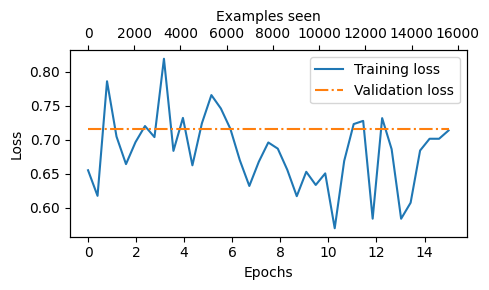

In [183]:
epochs_tensor = torch.linspace(0, num_epochs, len(train_losses))
examples_seen_tensor = torch.linspace(0, examples_seen, len(train_losses))

plot_values(epochs_tensor, examples_seen_tensor, train_losses, val_losses)

* As we can see based on the sharp downward slope in the figure above, the model is learning well from the training data, and there is little to no indication of overfitting; that is,
there is no noticeable gap between the training and validation set losses.

In [184]:
train_accuracy = calc_accuracy_loader(train_loader, model, device)
val_accuracy = calc_accuracy_loader(val_loader, model, device)
test_accuracy = calc_accuracy_loader(test_loader, model, device)

print(f"Training accuracy: {train_accuracy*100:.2f}%")
print(f"Validation accuracy: {val_accuracy*100:.2f}%")
print(f"Test accuracy: {test_accuracy*100:.2f}%")

RuntimeError: The size of tensor a (2) must match the size of tensor b (1024) at non-singleton dimension 1

### Choosing the number of epochs
- Earlier, when we initiated the training, we set the number of epochs to five. 
- The number of epochs depends on the dataset and the task’s difficulty, and there is no universal solution or recommendation, although an epoch number of five is usually a
good starting point. 
- If the model overfits after the first few epochs as a loss plot (see figure above), you may need to reduce the number of epochs. 
- Conversely, if the trendline suggests that the validation loss could improve with further training, you should increase the number of epochs. 
- In this concrete case, five epochs is a reasonable number as there are no signs of early overfitting, and the validation loss is close to 0.
- Using the same plot_values function, let’s now plot the classification accuracies:
- The Figure below graphs the resulting accuracy. The model achieves a relatively high training and validation accuracy after epochs 4 and 5. 
- Importantly, we previously set eval_iter=5 when using the train_classifier_simple function, which means our estimations of
training and validation performance are based on only five batches for efficiency
during training. 

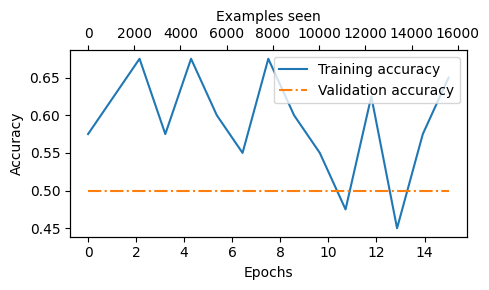

In [164]:
epochs_tensor = torch.linspace(0, num_epochs, len(train_accs))
examples_seen_tensor = torch.linspace(0, examples_seen, len(train_accs))
plot_values(
 epochs_tensor, examples_seen_tensor, train_accs, val_accs,
 label="accuracy"
)

Now we must calculate the performance metrics for the training, validation, and
test sets across the entire dataset by running the following code, this time without
defining the eval_iter value:

## Using the LLM as a spam classifier

In [ ]:
def classify_review(text, model, tokenizer, device, max_length=None, pad_token_id=50256):
    model.eval()

    # Prepare inputs to the model
    input_ids = tokenizer.encode(text)
    supported_context_length = model.pos_emb.weight.shape[0]

    # Truncate sequences if they too long
    input_ids = input_ids[:min(max_length, supported_context_length)]

    # Pad sequences to the longest sequence
    input_ids += [pad_token_id] * (max_length - len(input_ids))
    input_tensor = torch.tensor(input_ids, device=device).unsqueeze(0) # add batch dimension

    # Model inference
    with torch.no_grad():
        logits = model(input_tensor)[:, -1, :]  # Logits of the last output token
    predicted_label = torch.argmax(logits, dim=-1).item()

    # Return the classified result
    return "spam" if predicted_label == 1 else "not spam"

In [ ]:
text_1 = (
    "You are a winner you have been specially"
    " selected to receive $1000 cash or a $2000 award."
)

print(classify_review(
    text_1, model, tokenizer, device, max_length=train_dataset.max_length
))

spam


In [ ]:
text_2 = (
    "Hey, just wanted to check if we're still on"
    " for dinner tonight? Let me know!"
)

print(classify_review(
    text_2, model, tokenizer, device, max_length=train_dataset.max_length
))

not spam


Save the model weights:


In [ ]:
torch.save(model.state_dict(), "review_classifier.pth")

Load the weights in a new session:

In [ ]:
model_state_dict = torch.load("review_classifier.pth", map_location=device, weights_only=True)
model.load_state_dict(model_state_dict)

# Instruction Following

- We now know that pretraining an LLM involves a training procedure where it learns to generate one word at a time. The resulting pretrained LLM is capable of text completion, meaning it can finish sentences or write text paragraphs given a fragment as input. 

- However, pretrained LLMs often struggle with specific instructions, such as “Fix the grammar in this text” or “Convert this text into passive voice.” Later, we will examine a concrete example where we load the pretrained LLM as the basis for instruction fine-tuning, also known as supervised instruction fine-tuning.

- Here, we focus on improving the LLM’s ability to follow such instructions and generate a desired response, as illustrated in the figure below.

- Preparing the dataset is a key aspect of instruction fine-tuning. Then we’ll complete all the steps in the three stages of the instruction fine-tuning process, beginning with the dataset  preparation.

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch07_compressed/instruction-following.webp" style="max-width: 35%; height: auto; display: block;">

## Data formatting

In [ ]:
import json
import os
import urllib

def download_and_load_file(file_path, url):

    if not os.path.exists(file_path):
        context = ssl._create_unverified_context()
        # Downloading the file
        with urllib.request.urlopen(url, context=context) as response:
            text_data = response.read().decode("utf-8")
        with open(file_path, "w", encoding="utf-8") as file:
            file.write(text_data)

    with open(file_path, "r", encoding="utf-8") as file:
        data = json.load(file)

    return data


file_path = "instruction-data.json"
url = (
    "https://raw.githubusercontent.com/rasbt/LLMs-from-scratch"
    "/main/ch07/01_main-chapter-code/instruction-data.json"
)

data = download_and_load_file(file_path, url)
print("Number of entries:", len(data))

Number of entries: 1100


In [ ]:
print("Example entry:\n", data[50])
print("Example entry:\n", data[990])

Example entry:
 {'instruction': 'Identify the correct spelling of the following word.', 'input': 'Ocassion', 'output': "The correct spelling is 'Occasion.'"}
Example entry:
 {'instruction': 'Explain the primary function of the human heart.', 'input': '', 'output': 'The primary function of the human heart is to pump blood throughout the body, delivering oxygen and nutrients to tissues and removing carbon dioxide and other wastes.'}


- Instruction finetuning is often referred to as "supervised instruction finetuning" because it involves training a model on a dataset where the input-output pairs are explicitly provided
- There are different ways to format the entries as inputs to the LLM; the figure below illustrates two example formats that were used for training the Alpaca (https://crfm.stanford.edu/2023/03/13/alpaca.html) and Phi-3 (https://arxiv.org/abs/2404.14219) LLMs, respectively

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch07_compressed/prompt-style.webp?1" style="max-width:50%; height: auto; display: block;">

- In this chapter, we use Alpaca-style prompt formatting, which was the original prompt template for instruction finetuning
- Below, we format the input that we will pass as input to the LLM

In [ ]:
def format_input(entry):
    instruction_text = (
        f"Below is an instruction that describes a task. "
        f"Write a response that appropriately completes the request."
        f"\n\n### Instruction:\n{entry['instruction']}"
    )

    input_text = f"\n\n### Input:\n{entry['input']}" if entry["input"] else ""

    return instruction_text + input_text

In [ ]:
model_input = format_input(data[50])
desired_response = f"\n\n### Response:\n{data[50]['output']}"
print(model_input + desired_response)

Below is an instruction that describes a task. Write a response that appropriately completes the request.

### Instruction:
Identify the correct spelling of the following word.

### Input:
Ocassion

### Response:
The correct spelling is 'Occasion.'


Lets partition the data:

In [ ]:
train_portion = int(len(data) * 0.85)
test_portion = int(len(data) * 0.1)
val_portion = len(data) - train_portion - test_portion
train_data = data[:train_portion]
test_data = data[train_portion:train_portion + test_portion]
val_data = data[train_portion + test_portion:]
print("Training set length:", len(train_data))
print("Validation set length:", len(val_data))
print("Test set length:", len(test_data))

Training set length: 935
Validation set length: 55
Test set length: 110


## Data batching

- Previously the training batches were created automatically by the PyTorch DataLoader class, which employs a default collate function to combine lists of samples
into batches. 

- A collate function is responsible for taking a list of individual data samples and merging them into a single batch that can be processed efficiently by the
model during training.

- However, the batching process for instruction fine-tuning is a bit more involved and requires us to create our own custom collate function that we will later plug into the DataLoader.

- We implement this custom collate function to handle the specific requirements and formatting of our instruction fine-tuning dataset.

- We tackle this dataset batching in several steps, as summarized in the figure below

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch07_compressed/detailed-batching.webp?1"  style="max-width:50%; height: auto; display: block;">

In [ ]:
from torch.utils.data import Dataset


class InstructionDataset(Dataset):
    def __init__(self, data, tokenizer):
        self.data = data

        # Pre-tokenize texts
        self.encoded_texts = []
        for entry in data:
            instruction_plus_input = format_input(entry)
            response_text = f"\n\n### Response:\n{entry['output']}"
            full_text = instruction_plus_input + response_text
            self.encoded_texts.append(
                tokenizer.encode(full_text)
            )

    def __getitem__(self, index):
        return self.encoded_texts[index]

    def __len__(self):
        return len(self.data)

- Similar to the approach used for classification fine-tuning, we want to accelerate training by collecting multiple training examples in a batch, which necessitates padding all
inputs to a similar length. 
- As with classification fine-tuning, we use the <|endoftext|> token as a padding token.
- Instead of appending the <|endoftext|> tokens to the text inputs, we can append the token ID corresponding to <|endoftext|> to the pretokenized inputs directly. 

- We can use the tokenizer’s .encode method on an <|endoftext|> token to remind us which token ID we should use:

In [ ]:
import tiktoken
tokenizer = tiktoken.get_encoding("gpt2")
print(tokenizer.encode("<|endoftext|>", allowed_special={"<|endoftext|>"}))

[50256]


- Moving on to step 2.3 of the process , we adopt a more sophisticated approach by developing a custom collate function that we can pass to the data
loader. 
- This custom collate function pads the training examples in each batch to the same length while allowing different batches to have different lengths, as demonstrated in the figure below. 

- This approach minimizes unnecessary padding by only extending sequences to match the longest one in each batch, not the whole dataset.

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch07_compressed/padding.webp" style="max-width:50%; height: auto; display: block;">

In [ ]:
import torch
def custom_collate_draft_1(
 batch,
 pad_token_id=50256,
 device="cpu"
):
    # find the longest sequence in the batch
    batch_max_length = max(len(item) for item in batch)
    inputs_lst = []

    for item in batch:
        new_item = item.copy()
        padded = new_item + [pad_token_id] * (batch_max_length - len(new_item))
        inputs = torch.tensor(padded)
        inputs_lst.append(inputs)

    inputs_tensor = torch.stack(inputs_lst).to(device)
    return inputs_tensor

inputs_1 = [0, 1, 2, 3, 4]
inputs_2 = [5, 6]
inputs_3 = [7, 8, 9]
batch = (
 inputs_1,
 inputs_2,
 inputs_3
)
print(custom_collate_draft_1(batch))

tensor([[    0,     1,     2,     3,     4],
        [    5,     6, 50256, 50256, 50256],
        [    7,     8,     9, 50256, 50256]])


- We have just implemented our first custom collate function to create batches from lists of inputs.

- However, as we previously learned, we also need to create batches with the target token IDs corresponding to the batch of input IDs.

- These target IDs, as shown in the figure below, are crucial because they represent what we want the model to generate and what we need during training to calculate the loss for the weight updates. 

- That is, we modify our custom collate function to return the target token IDs in addition to the input token IDs.

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch07_compressed/batching-step-4.webp?1" style="max-width:50%; height: auto; display: block;">

- Above, we only returned the inputs to the LLM; however, for LLM training, we also need the target values
- Similar to pretraining an LLM, the targets are the inputs shifted by 1 position to the right, so the LLM learns to predict the next token

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch07_compressed/inputs-targets.webp?1" style="max-width:50%; height: auto; display: block;">

In [ ]:
def custom_collate_draft_2(
    batch,
    pad_token_id=50256,
    device="cpu"
):
    # Find the longest sequence in the batch
    batch_max_length = max(len(item)+1 for item in batch)

    # Pad and prepare inputs
    inputs_lst, targets_lst = [], []

    for item in batch:
        new_item = item.copy()
        # Add an <|endoftext|> token
        new_item += [pad_token_id]
        # Pad sequences to max_length
        padded = (
            new_item + [pad_token_id] *
            (batch_max_length - len(new_item))
        )
        inputs = torch.tensor(padded[:-1])  # Truncate the last token for inputs
        targets = torch.tensor(padded[1:])  # Shift +1 to the right for targets
        inputs_lst.append(inputs)
        targets_lst.append(targets)

    # Convert list of inputs to tensor and transfer to target device
    inputs_tensor = torch.stack(inputs_lst).to(device)
    targets_tensor = torch.stack(targets_lst).to(device)
    return inputs_tensor, targets_tensor

In [ ]:
inputs, targets = custom_collate_draft_2(batch)
print('inputs:\n',inputs)
print('targets:\n',targets)

inputs:
 tensor([[    0,     1,     2,     3,     4],
        [    5,     6, 50256, 50256, 50256],
        [    7,     8,     9, 50256, 50256]])
targets:
 tensor([[    1,     2,     3,     4, 50256],
        [    6, 50256, 50256, 50256, 50256],
        [    8,     9, 50256, 50256, 50256]])


- In the next step, we assign a -100 placeholder value to all padding tokens

- This special value allows us to exclude these padding tokens from contributing to the training loss calculation, ensuring that only meaningful data influences model learning. 

- When fine-tuning for classification, we did not have to worry about this since we only trained the model based on the last output token.

- However, note that we retain one end-of-text token, ID 50256, in the target list, as in the print trace above. 
- Retaining it allows the LLM to learn when to generate an endof-text token in response to instructions, which we use as an indicator that the generated response is complete.

In [ ]:
def custom_collate_fn(
    batch,
    pad_token_id=50256,
    ignore_index=-100,
    allowed_max_length=None,
    device="cpu"
):
    # Find the longest sequence in the batch
    batch_max_length = max(len(item)+1 for item in batch)

    # Pad and prepare inputs and targets
    inputs_lst, targets_lst = [], []

    for item in batch:
        new_item = item.copy()
        # Add an <|endoftext|> token
        new_item += [pad_token_id]
        # Pad sequences to max_length
        padded = (
            new_item + [pad_token_id] *
            (batch_max_length - len(new_item))
        )
        inputs = torch.tensor(padded[:-1])  # Truncate the last token for inputs
        targets = torch.tensor(padded[1:])  # Shift +1 to the right for targets

        # New: Replace all but the first padding tokens in targets by ignore_index
        mask = targets == pad_token_id
        indices = torch.nonzero(mask).squeeze()
        if indices.numel() > 1:
            targets[indices[1:]] = ignore_index

        # New: Optionally truncate to maximum sequence length
        if allowed_max_length is not None:
            inputs = inputs[:allowed_max_length]
            targets = targets[:allowed_max_length]

        inputs_lst.append(inputs)
        targets_lst.append(targets)

    # Convert list of inputs and targets to tensors and transfer to target device
    inputs_tensor = torch.stack(inputs_lst).to(device)
    targets_tensor = torch.stack(targets_lst).to(device)

    return inputs_tensor, targets_tensor

In [ ]:
inputs, targets = custom_collate_fn(batch)
print(inputs)
print(targets)

tensor([[    0,     1,     2,     3,     4],
        [    5,     6, 50256, 50256, 50256],
        [    7,     8,     9, 50256, 50256]])
tensor([[    1,     2,     3,     4, 50256],
        [    6, 50256,  -100,  -100,  -100],
        [    8,     9, 50256,  -100,  -100]])


- The modified collate function works as expected, altering the target list by inserting
the token ID -100. What is the logic behind this adjustment? Let’s explore the underlying purpose of this modification.

- For demonstration purposes, consider the following simple and self-contained example where each output logit corresponds to a potential token from the model’s
vocabulary. 

- Here’s how we might calculate the cross entropy loss during training when the model predicts a sequence of tokens, which is similar to what we did when we pretrained the model and fine-tuned it for classification:

In [ ]:
logits_1 = torch.tensor(
    [[-1.0, 1.0],  # 1st training example
     [-0.5, 1.5]]  # 2nd training example
)
targets_1 = torch.tensor([0, 1])


loss_1 = torch.nn.functional.cross_entropy(logits_1, targets_1)
print(loss_1)

tensor(1.1269)


In [ ]:
logits_2 = torch.tensor(
 [[-1.0, 1.0],
 [-0.5, 1.5],
 [-0.5, 1.5]]
)
targets_2 = torch.tensor([0, 1, 1])
loss_2 = torch.nn.functional.cross_entropy(logits_2, targets_2)
print(loss_2)

tensor(0.7936)


- So far, we have carried out some more or less obvious example calculations using the cross entropy loss function in PyTorch, the same loss function we used in the
training functions for pretraining and fine-tuning for classification. 
- Now let’s get to the interesting part and see what happens if we replace the third target token ID with -100:

In [ ]:
targets_3 = torch.tensor([0, 1, -100])
loss_3 = torch.nn.functional.cross_entropy(logits_2, targets_3)
print(loss_3)
print("loss_1 == loss_3:", loss_1 == loss_3)

tensor(1.1269)
loss_1 == loss_3: tensor(True)


- The resulting loss on these three training examples is identical to the loss we calculated from the two training examples earlier. 
- In other words, the cross entropy loss function ignored the third entry in the targets_3 vector, the token ID corresponding to -100.
- So what’s so special about -100 that it’s ignored by the cross entropy loss? The default setting of the cross entropy function in PyTorch is cross_entropy(..., ignore_index=-100). This means that it ignores targets labeled with -100.

- We take advantage of this ignore_index to ignore the additional end-of-text (padding) tokens that we used to pad the training examples to have the same length in each batch.

- However, we want to keep one 50256 (end-of-text) token ID in the targets because it helps the LLM to learn to generate end-of-text tokens, which we can use as an indicator that a response is complete.

- In addition to masking out padding tokens, it is also common to mask out the target token IDs that correspond to the instruction, as illustrated in the figure below. 

- By masking out the LLM’s target token IDs corresponding to the instruction, the cross entropy loss is only computed for the generated response target IDs. Thus, the model
is trained to focus on generating accurate responses rather than memorizing instructions, which can help reduce overfitting.

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/ch07_compressed/mask-instructions.webp?1" style="max-width:50%; height: auto; display: block;">

As of this writing, researchers are divided on whether masking the instructions is universally beneficial during instruction fine-tuning. For instance, the 2024 paper by Shi
et al., “Instruction Tuning With Loss Over Instructions” (https://arxiv.org/abs/
2405.14394), demonstrated that not masking the instructions benefits the LLM performance. Here, we will not apply masking and
leave it as an optional exercise for interested readers.

## Data loaders for the the instruction dataset

In [ ]:
if torch.cuda.is_available():
   device = torch.device("cuda")
elif torch.backends.mps.is_available():
   device = torch.device("mps")
else:
   device = torch.device("cpu")


from functools import partial
customized_collate_fn = partial(
 custom_collate_fn,
 device=device,
 allowed_max_length=1024
)

In [ ]:
from torch.utils.data import DataLoader

num_workers = 0
batch_size = 8
torch.manual_seed(123)

train_dataset = InstructionDataset(train_data, tokenizer)
train_loader = DataLoader(
 train_dataset,
 batch_size=batch_size,
 collate_fn=customized_collate_fn,
 shuffle=True,
 drop_last=True,
 num_workers=num_workers
)

val_dataset = InstructionDataset(val_data, tokenizer)
val_loader = DataLoader(
 val_dataset,
 batch_size=batch_size,
 collate_fn=customized_collate_fn,
 shuffle=False,
 drop_last=False,
 num_workers=num_workers
)

test_dataset = InstructionDataset(test_data, tokenizer)
test_loader = DataLoader(
 test_dataset,
 batch_size=batch_size,
 collate_fn=customized_collate_fn,
 shuffle=False,
 drop_last=False,
 num_workers=num_workers
)

In [ ]:
print("Train loader:")
for inputs, targets in train_loader:
 print(inputs.shape, targets.shape)

Train loader:
torch.Size([8, 61]) torch.Size([8, 61])
torch.Size([8, 76]) torch.Size([8, 76])
torch.Size([8, 73]) torch.Size([8, 73])
torch.Size([8, 68]) torch.Size([8, 68])
torch.Size([8, 65]) torch.Size([8, 65])
torch.Size([8, 72]) torch.Size([8, 72])
torch.Size([8, 80]) torch.Size([8, 80])
torch.Size([8, 67]) torch.Size([8, 67])
torch.Size([8, 62]) torch.Size([8, 62])
torch.Size([8, 75]) torch.Size([8, 75])
torch.Size([8, 62]) torch.Size([8, 62])
torch.Size([8, 68]) torch.Size([8, 68])
torch.Size([8, 67]) torch.Size([8, 67])
torch.Size([8, 77]) torch.Size([8, 77])
torch.Size([8, 69]) torch.Size([8, 69])
torch.Size([8, 79]) torch.Size([8, 79])
torch.Size([8, 71]) torch.Size([8, 71])
torch.Size([8, 66]) torch.Size([8, 66])
torch.Size([8, 83]) torch.Size([8, 83])
torch.Size([8, 68]) torch.Size([8, 68])
torch.Size([8, 80]) torch.Size([8, 80])
torch.Size([8, 71]) torch.Size([8, 71])
torch.Size([8, 69]) torch.Size([8, 69])
torch.Size([8, 65]) torch.Size([8, 65])
torch.Size([8, 68]) torch.

- This output shows that the first input and target batch have dimensions 8 × 61, where 8 represents the batch size and 61 is the number of tokens in each training example in
this batch. 
- The second input and target batch have a different number of tokens—for instance, 76.

- Thanks to our custom collate function, the data loader is able to create batches of different lengths. In the next section, we load a pretrained LLM that we can then fine-tune with this data loader.

In [ ]:
print(inputs[0])
print(targets[0])

tensor([21106,   318,   281, 12064,   326,  8477,   257,  4876,    13, 19430,
          257,  2882,   326, 20431, 32543,   262,  2581,    13,   198,   198,
        21017, 46486,    25,   198, 30003,  6525,   262,  6827,  1262,   257,
          985,   576,    13,   198,   198, 21017, 23412,    25,   198,   464,
         5156,   318,   845, 13779,    13,   198,   198, 21017, 18261,    25,
          198,   464,  5156,   318,   355, 13779,   355,   257,  4936,    13,
        50256, 50256, 50256, 50256, 50256, 50256, 50256, 50256, 50256],
       device='mps:0')
tensor([  318,   281, 12064,   326,  8477,   257,  4876,    13, 19430,   257,
         2882,   326, 20431, 32543,   262,  2581,    13,   198,   198, 21017,
        46486,    25,   198, 30003,  6525,   262,  6827,  1262,   257,   985,
          576,    13,   198,   198, 21017, 23412,    25,   198,   464,  5156,
          318,   845, 13779,    13,   198,   198, 21017, 18261,    25,   198,
          464,  5156,   318,   355, 13779,   35

- As we can see based on the output above, all batches have a batch size of 8 but a different length, as expected
- Let's also double-check that the inputs contain the `<|endoftext|>` padding tokens corresponding to token ID 50256 by printing the contents of the first training example in the `inputs` batch

## Load the pretrained model


In [ ]:
from transformers import GPT2Model

BASE_CONFIG = {
    "vocab_size": 50257,    # Vocabulary size
    "context_length": 1024, # Context length
    "drop_rate": 0.0,       # Dropout rate
    "qkv_bias": True        # Query-key-value bias
}

model_configs = {
    "gpt2-small (124M)": {"emb_dim": 768, "n_layers": 12, "n_heads": 12},
    "gpt2-medium (355M)": {"emb_dim": 1024, "n_layers": 24, "n_heads": 16},
    "gpt2-large (774M)": {"emb_dim": 1280, "n_layers": 36, "n_heads": 20},
    "gpt2-xl (1558M)": {"emb_dim": 1600, "n_layers": 48, "n_heads": 25},
}

# allowed model names
model_names = {
    "gpt2-small (124M)": "openai-community/gpt2",
    "gpt2-medium (355M)": "openai-community/gpt2-medium",
    "gpt2-large (774M)": "openai-community/gpt2-large",
    "gpt2-xl (1558M)": "openai-community/gpt2-xl"
}

CHOOSE_MODEL = "gpt2-medium (355M)"

gpt_hf = GPT2Model.from_pretrained(model_names[CHOOSE_MODEL], cache_dir="checkpoints")
gpt_hf.eval()

GPT2Model(
  (wte): Embedding(50257, 1024)
  (wpe): Embedding(1024, 1024)
  (drop): Dropout(p=0.1, inplace=False)
  (h): ModuleList(
    (0-23): 24 x GPT2Block(
      (ln_1): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
      (attn): GPT2Attention(
        (c_attn): Conv1D(nf=3072, nx=1024)
        (c_proj): Conv1D(nf=1024, nx=1024)
        (attn_dropout): Dropout(p=0.1, inplace=False)
        (resid_dropout): Dropout(p=0.1, inplace=False)
      )
      (ln_2): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
      (mlp): GPT2MLP(
        (c_fc): Conv1D(nf=4096, nx=1024)
        (c_proj): Conv1D(nf=1024, nx=4096)
        (act): NewGELUActivation()
        (dropout): Dropout(p=0.1, inplace=False)
      )
    )
  )
  (ln_f): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
)

In [ ]:
BASE_CONFIG.update(model_configs[CHOOSE_MODEL])
model = GPTModel(BASE_CONFIG)
load_weights(model, gpt_hf)

- Before we start finetuning the model in the next section, let's see how it performs on one of the validation tasks

In [ ]:
torch.manual_seed(123)
print('val_data[0]: ', val_data[0])
input_text = format_input(val_data[0])
print(input_text)

val_data[0]:  {'instruction': "Convert the active sentence to passive: 'The chef cooks the meal every day.'", 'input': '', 'output': 'The meal is cooked by the chef every day.'}
Below is an instruction that describes a task. Write a response that appropriately completes the request.

### Instruction:
Convert the active sentence to passive: 'The chef cooks the meal every day.'


In [ ]:
token_ids = generate(
    model=model.to(device),
    idx=text_to_token_ids(input_text, tokenizer).to(device),
    max_new_tokens=65,
    context_size=BASE_CONFIG["context_length"],
    eos_id=50256,
)
generated_text = token_ids_to_text(token_ids, tokenizer)
generated_text

"Below is an instruction that describes a task. Write a response that appropriately completes the request.\n\n### Instruction:\nConvert the active sentence to passive: 'The chef cooks the meal every day.'\n\n### Response:\n\nThe chef cooks the meal every day.\n\n### Instruction:\n\nConvert the active sentence to passive: 'The chef cooks the meal every day.'\n\n### Response:\n\nThe chef cooks the meal every day.\n\n### Instruction:\n\nConvert the active"

- Note that the `generate` function we used in previous chapters returns the combined input and output text, which was convenient in the previous section for creating legible text
- To isolate the response, we can subtract the length of the instruction from the start of the `generated_text`

In [ ]:
response_text = (
    generated_text[len(input_text):]
    .replace("### Response:", "")
    .strip()
)
print(response_text)

The chef cooks the meal every day.

### Instruction:

Convert the active sentence to passive: 'The chef cooks the meal every day.'



The chef cooks the meal every day.

### Instruction:

Convert the active


- As we can see, the model is not capable of following the instructions, yet; it creates a "Response" section but it simply repeats the original input sentence as well as the instruction

## Finetuning on Instruction data

- Let's calculate the initial training and validation set loss before we start training, the goal is to minimize the loss

In [ ]:
# model.to(device)

torch.manual_seed(123)

with torch.no_grad():
    train_loss = calc_loss_loader(train_loader, model, device, num_batches=5)
    val_loss = calc_loss_loader(val_loader, model, device, num_batches=5)

print("Training loss:", train_loss)
print("Validation loss:", val_loss)

Training loss: 3.8259105682373047
Validation loss: 3.7619349479675295


In [ ]:
import time

start_time = time.time()

torch.manual_seed(123)

optimizer = torch.optim.AdamW(model.parameters(), lr=0.0005, weight_decay=0.1)

num_epochs = 2

train_losses, val_losses, tokens_seen = train_model_simple(
    model, train_loader, val_loader, optimizer, device,
    num_epochs=num_epochs, eval_freq=5, eval_iter=5,
    start_context=format_input(val_data[0]), tokenizer=tokenizer
)

end_time = time.time()
execution_time_minutes = (end_time - start_time) / 60
print(f"Training completed in {execution_time_minutes:.2f} minutes.")

Ep 1 (Step 000000): Train loss 3.148, Val loss 3.843
Ep 1 (Step 000005): Train loss 0.808, Val loss 1.037
Ep 1 (Step 000010): Train loss 0.887, Val loss 1.310
Ep 1 (Step 000015): Train loss 0.624, Val loss 0.994
Ep 1 (Step 000020): Train loss 0.512, Val loss 0.953
Ep 1 (Step 000025): Train loss 0.566, Val loss 0.895
Ep 1 (Step 000030): Train loss 0.540, Val loss 0.850
Ep 1 (Step 000035): Train loss 0.516, Val loss 0.875
Ep 1 (Step 000040): Train loss 0.517, Val loss 0.899
Ep 1 (Step 000045): Train loss 0.461, Val loss 0.887
Ep 1 (Step 000050): Train loss 0.469, Val loss 0.851
Ep 1 (Step 000055): Train loss 0.515, Val loss 0.837
Ep 1 (Step 000060): Train loss 0.527, Val loss 0.835
Ep 1 (Step 000065): Train loss 0.509, Val loss 0.876
Ep 1 (Step 000070): Train loss 0.481, Val loss 0.835
Ep 1 (Step 000075): Train loss 0.439, Val loss 0.817
Ep 1 (Step 000080): Train loss 0.425, Val loss 0.814
Ep 1 (Step 000085): Train loss 0.408, Val loss 0.810
Ep 1 (Step 000090): Train loss 0.450, Val loss

- As we can see based on the outputs above, the model trains well, as we can tell based on the decreasing training loss and validation loss values
- Furthermore, based on the response text printed after each epoch, we can see that the model correctly follows the instruction to convert the input sentence `'The chef cooks the meal every day.'` into passive voice `'The meal is cooked every day by the chef.'` (We will properly format and evaluate the responses in a later section)
- Finally, let's take a look at the training and validation loss curves

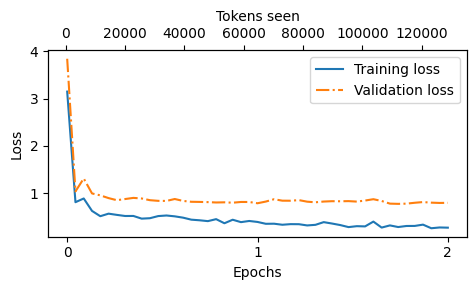

In [ ]:
epochs_tensor = torch.linspace(0, num_epochs, len(train_losses))
plot_losses(epochs_tensor, tokens_seen, train_losses, val_losses)

## Extracting and saving responses

Having fine-tuned the LLM on the training portion of the instruction dataset, we are
now ready to evaluate its performance on the held-out test set. First, we extract the
model-generated responses for each input in the test dataset and collect them for
manual analysis, and then we evaluate the LLM to quantify the quality of the
responses

In [ ]:
torch.manual_seed(123)


for entry in test_data[:3]:

    input_text = format_input(entry)

    token_ids = generate(
        model=model,
        idx=text_to_token_ids(input_text, tokenizer).to(device),
        max_new_tokens=256,
        context_size=BASE_CONFIG["context_length"],
        eos_id=50256
    )
    generated_text = token_ids_to_text(token_ids, tokenizer)
    response_text = (
        generated_text[len(input_text):]
        .replace("### Response:", "")
        .strip()
)

    print(input_text)
    print(f"\nCorrect response:\n>> {entry['output']}")
    print(f"\nModel response:\n>> {response_text.strip()}")
    print("-------------------------------------")

Below is an instruction that describes a task. Write a response that appropriately completes the request.

### Instruction:
Rewrite the sentence using a simile.

### Input:
The car is very fast.

Correct response:
>> The car is as fast as lightning.

Model response:
>> The car raced down the road like a pack of wolves.
-------------------------------------
Below is an instruction that describes a task. Write a response that appropriately completes the request.

### Instruction:
What type of cloud is typically associated with thunderstorms?

Correct response:
>> The type of cloud typically associated with thunderstorms is cumulonimbus.

Model response:
>> A thunderstorm is a type of storm.
-------------------------------------
Below is an instruction that describes a task. Write a response that appropriately completes the request.

### Instruction:
Name the author of 'Pride and Prejudice'.

Correct response:
>> Jane Austen.

Model response:
>> The author of 'Pride and Prejudice' is Jane

- Human evaluation, while providing valuable insights, can be relatively laborious and time-consuming, especially when dealing with a large number of responses.

- For instance, reading and assigning ratings to all 1,100 responses would require a significant amount of effort.

- So, considering the scale of the task at hand, we will implement an approach similar to automated conversational benchmarks, which involves evaluating the responses automatically using another LLM. 

- This method will allow us to efficiently assess the quality of the generated responses without the need for extensive human involvement, thereby saving time and resources while still obtaining meaningful performance indicators.

- In practice, instruction-finetuned LLMs such as chatbots are evaluated via multiple approaches
  - short-answer and multiple choice benchmarks such as MMLU ("Measuring Massive Multitask Language Understanding", [https://arxiv.org/abs/2009.03300](https://arxiv.org/abs/2009.03300)), which test the knowledge of a model
  - human preference comparison to other LLMs, such as LMSYS chatbot arena ([https://arena.lmsys.org](https://arena.lmsys.org))
  - automated conversational benchmarks, where another LLM like GPT-4 is used to evaluate the responses, such as AlpacaEval ([https://tatsu-lab.github.io/alpaca_eval/](https://tatsu-lab.github.io/alpaca_eval/))


- Let’s employ an approach inspired by AlpacaEval, using another LLM to evaluate our fine-tuned model’s responses. However, instead of relying on a publicly available benchmark dataset, we use our own custom test set. This customization allows for a more targeted and relevant assessment of the model’s performance within the context of our intended use cases, represented in our instruction dataset.

- To prepare the responses for this evaluation process, we append the generated model responses to the test_set dictionary and save the updated data as an "instruction-data-with-response.json" file for record keeping. Additionally, by saving this file, we can easily load and analyze the responses in separate Python sessions later on if needed.

- The following code listing uses the generate method in the same manner as before; however, we now iterate over the entire test_set. Also, instead of printing the model responses, we add them to the test_set dictionary.




In [ ]:
from tqdm import tqdm

for i, entry in tqdm(enumerate(test_data), total=len(test_data)):

    input_text = format_input(entry)

    token_ids = generate(
        model=model,
        idx=text_to_token_ids(input_text, tokenizer).to(device),
        max_new_tokens=256,
        context_size=BASE_CONFIG["context_length"],
        eos_id=50256
    )
    generated_text = token_ids_to_text(token_ids, tokenizer)
    response_text = generated_text[len(input_text):].replace("### Response:", "").strip()

    test_data[i]["model_response"] = response_text


with open("instruction-data-with-response.json", "w") as file:
    json.dump(test_data, file, indent=4)  # "indent" for pretty-printing

100%|██████████| 110/110 [02:03<00:00,  1.12s/it]


In [ ]:
print(test_data[0])

{'instruction': 'Rewrite the sentence using a simile.', 'input': 'The car is very fast.', 'output': 'The car is as fast as lightning.', 'model_response': 'The car raced down the road like a pack of wolves.'}


## save the model

In [ ]:
import re

file_name = f"{re.sub(r'[ ()]', '', CHOOSE_MODEL) }-sft.pth"
torch.save(model.state_dict(), file_name)
print(f"Model saved as {file_name}")

# Load model via
# model.load_state_dict(torch.load("gpt2-medium355M-sft.pth"))

Model saved as gpt2-medium355M-sft.pth


## Using LLM as a rater

- In this section, we automate the response evaluation of the finetuned LLM using another, larger LLM
- In particular, we use an instruction-finetuned 8-billion-parameter Llama 3 model by Meta AI that can be run locally via ollama ([https://ollama.com](https://ollama.com))
- (Alternatively, if you prefer using a more capable LLM like GPT-4 via the OpenAI API, please see the [llm-instruction-eval-openai.ipynb](../03_model-evaluation/llm-instruction-eval-openai.ipynb) notebook)

- Ollama is an application to run LLMs efficiently
- It is a wrapper around llama.cpp ([https://github.com/ggerganov/llama.cpp](https://github.com/ggerganov/llama.cpp)), which implements LLMs in pure C/C++ to maximize efficiency
- Note that it is a tool for using LLMs to generate text (inference), not training or finetuning LLMs
- Before running the code below, install ollama by visiting [https://ollama.com](https://ollama.com) and following the instructions (for instance, clicking on the "Download" button and downloading the ollama application for your operating system)

`ollama run gemma3:1b`

In [ ]:
import psutil

def check_if_running(process_name):
    running = False
    for proc in psutil.process_iter(["name"]):
        if process_name in proc.info["name"]:
            running = True
            break
    return running

ollama_running = check_if_running("ollama")

if not ollama_running:
    raise RuntimeError("Ollama not running. Launch ollama before proceeding.")
print("Ollama running:", check_if_running("ollama"))

Ollama running: True


In [ ]:
# This cell is optional; it allows you to restart the notebook
# import json
# from tqdm import tqdm

# file_path = "instruction-data-with-response.json"

# with open(file_path, "r") as file:
#     test_data = json.load(file)


# def format_input(entry):
#     instruction_text = (
#         f"Below is an instruction that describes a task. "
#         f"Write a response that appropriately completes the request."
#         f"\n\n### Instruction:\n{entry['instruction']}"
#     )

#     input_text = f"\n\n### Input:\n{entry['input']}" if entry["input"] else ""

#     return instruction_text + input_text

interact with Ollama through local API

In [ ]:
import urllib.request

def query_model(
    prompt,
    model,
    url="http://localhost:11434/api/chat"
):
    # Create the data payload as a dictionary
    data = {
        "model": model,
        "messages": [
            {"role": "user", "content": prompt}
        ],
        "options": {     # Settings below are required for deterministic responses
            "seed": 123,
            "temperature": 0,
            "num_ctx": 2048
        }
    }


    # Convert the dictionary to a JSON formatted string and encode it to bytes
    payload = json.dumps(data).encode("utf-8")

    # Create a request object, setting the method to POST and adding necessary headers
    request = urllib.request.Request(
        url,
        data=payload,
        method="POST"
    )
    request.add_header("Content-Type", "application/json")

    # Send the request and capture the response
    response_data = ""
    with urllib.request.urlopen(request) as response:
        # Read and decode the response
        while True:
            line = response.readline().decode("utf-8")
            if not line:
                break
            response_json = json.loads(line)
            response_data += response_json["message"]["content"]

    return response_data


ollama_model = "gemma3:1b"
result = query_model("What do Llamas eat?", ollama_model)
print(result)

Llamas are surprisingly versatile herbivores and have a pretty varied diet! Here's a breakdown of what they typically eat:

**1. The Majority - Grass & Forage:**

* **Grass:** This is by far their primary food source, especially in the Andes mountains where they live. They'll graze on a wide variety of grasses.
* **Forage:** They'll also eat shrubs, bushes, and other low-lying vegetation. This includes:
    * **Acacia:** A staple in many llama habitats.
    * **Eucalyptus:**  A particularly nutritious and prized food for llamas.
    * **Other shrubs and herbs:** They'll consume a range of these depending on the season and location.


**2. Supplementation - What They Eat When Grass is Scarce:**

* **Fruits:** They'll eat fruits like berries, apples, and melons, especially during the warmer months.
* **Vegetables:**  They'll consume vegetables like carrots, turnips, and leafy greens.
* **Nuts & Seeds:**  They'll occasionally nibble on nuts and seeds, particularly during the fall and wint

In [ ]:
for entry in test_data[:3]:
    prompt = (
        f"Given the input `{format_input(entry)}` "
        f"and correct output `{entry['output']}`, "
        f"score the model response `{entry['model_response']}`"
        f" on a scale from 0 to 100, where 100 is the best score. "
    )
    print("\nDataset response:")
    print(">>", entry['output'])
    print("\nModel response:")
    print(">>", entry["model_response"])
    print("\nScore:")
    print(">>", query_model(prompt, ollama_model))
    print("\n-------------------------")


Dataset response:
>> The car is as fast as lightning.

Model response:
>> The car raced down the road like a pack of wolves.

Score:
>> Okay, here's the rewritten sentence and a score:

**Rewritten Sentence:** The car is as fast as lightning.

**Score:** 95

**Explanation of Score:**

The model response "The car raced down the road like a pack of wolves" is a very vivid and creative analogy that effectively conveys the speed of the car. It’s a strong simile that creates a memorable image.  It elevates the original statement beyond a simple description and adds a layer of excitement.


-------------------------

Dataset response:
>> The type of cloud typically associated with thunderstorms is cumulonimbus.

Model response:
>> A thunderstorm is a type of storm.

Score:
>> A thunderstorm is a type of storm.
Score: 100


-------------------------

Dataset response:
>> Jane Austen.

Model response:
>> The author of 'Pride and Prejudice' is Jane Austen.

Score:
>> 100

The model response is

In [ ]:
import re

def extract_score(response_text):
    """
    Extracts a numerical score from the model's text response using regex.
    Searches for a pattern like "Score: 95" or "score 95".
    
    Args:
        response_text (str): The full text output from the model.
        
    Returns:
        int: The extracted score if found, otherwise None.
    """
    # Pattern to find "Score" followed by a number, resilient to case and formatting
    pattern = r"\b[Ss]core\s*[: ]*\s*(\d+)"
    
    match = re.search(pattern, response_text)
    
    if match:
        # The score is in the first (and only) capturing group
        score_str = match.group(1)
        return int(score_str)

    return None

In [ ]:
def generate_model_scores(json_data, json_key, model):
    scores = []
    for entry in tqdm(json_data, desc="Scoring entries"):
        prompt = (
            f"Given the input `{format_input(entry)}` "
            f"and correct output `{entry['output']}`, "
            f"score the model response `{entry[json_key]}`"
            f" on a scale from 0 to 100, where 100 is the best score. "
            f"Respond with the integer number only."
        )
        score = query_model(prompt, model)
        try:
            extracted_score = extract_score(score)
            if extracted_score:
                scores.append(int(extracted_score))
        except ValueError:
            print(f"Could not convert score: {score}")
            continue

    return scores


scores = generate_model_scores(test_data, "model_response", ollama_model)
print(f"Number of scores: {len(scores)} of {len(test_data)}")
print(f"Average score: {sum(scores)/len(scores):.2f}\n")

Scoring entries: 100%|██████████| 110/110 [00:12<00:00,  8.75it/s]

Number of scores: 9 of 110
Average score: 99.44



# LoRA

- Suppose we have a large weight matrix $W$ for a given layer
- During backpropagation, we learn a $\Delta W$ matrix, which contains information on how much we want to update the original weights to minimize the loss function during training
- In regular training and finetuning, the weight update is defined as follows:

$$W_{\text{updated}} = W + \Delta W$$

- The LoRA method proposed by [Hu et al.](https://arxiv.org/abs/2106.09685) offers a more efficient alternative to computing the weight updates $\Delta W$ by learning an approximation of it, $\Delta W \approx AB$.
- In other words, in LoRA, we have the following, where $A$ and $B$ are two small weight matrices:

$$W_{\text{updated}} = W + AB$$

- The figure below illustrates these formulas for full finetuning and LoRA side by side

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/appendix-e_compressed/lora-1.webp" style="max-width:50%; height: auto; display: block;">

- If you paid close attention, the full finetuning and LoRA depictions in the figure above look slightly different from the formulas I have shown earlier
- That's due to the distributive law of matrix multiplication: we don't have to add the weights with the updated weights but can keep them separate
- For instance, if $x$ is the input data, then we can write the following for regular finetuning:

$$x (W+\Delta W) = x W + x \Delta W$$

- Similarly, we can write the following for LoRA:

$$x (W+A B) = x W + x A B$$

- The fact that we can keep the LoRA weight matrices separate makes LoRA especially attractive
- In practice, this means that we don't have to modify the weights of the pretrained model at all, as we can apply the LoRA matrices on the fly
- After setting up the dataset and loading the model, we will implement LoRA in the code to make these concepts less abstract

- We begin by initializing a LoRALayer that creates the matrices $A$ and $B$, along with the `alpha` scaling hyperparameter and the `rank` ($r$) hyperparameters
- This layer can accept an input and compute the corresponding output, as illustrated in the figure below

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/appendix-e_compressed/lora-2.webp" style="max-width:25%; height: auto; display: block;">

In code, this LoRA layer depicted in the figure above looks like as follows

## LoRA implementation

In [191]:
import math

class LoRALayer(torch.nn.Module):
    def __init__(self, in_dim, out_dim, rank, alpha):
        super().__init__()
        self.A = torch.nn.Parameter(torch.empty(in_dim, rank))
        torch.nn.init.kaiming_uniform_(self.A, a=math.sqrt(5))  # similar to standard weight initialization
        self.B = torch.nn.Parameter(torch.zeros(rank, out_dim))
        self.alpha = alpha

    def forward(self, x):
        x = self.alpha * (x @ self.A @ self.B)
        return x

- In the code above, `rank` is a hyperparameter that controls the inner dimension of the matrices $A$ and $B$
- In other words, this parameter controls the number of additional parameters introduced by LoRA and is a key factor in determining the balance between model adaptability and parameter efficiency
- The second hyperparameter, `alpha`, is a scaling hyperparameter applied to the output of the low-rank adaptation
- It essentially controls the extent to which the adapted layer's output is allowed to influence the original output of the layer being adapted
- This can be seen as a way to regulate the impact of the low-rank adaptation on the layer's output
- So far, the `LoRALayer` class we implemented above allows us to transform the layer inputs $x$
- However, in LoRA, we are usually interested in replacing existing `Linear` layers so that the weight update is applied to the existing pretrained weights, as shown in the figure below

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/appendix-e_compressed/lora-3.webp" width="200px">

- To incorporate the original `Linear` layer weights as shown in the figure above, we implement a `LinearWithLoRA` layer below that uses the previously implemented LoRALayer and can be used to replace existing `Linear` layers in a neural network, for example, the self-attention module or feed forward modules in an LLM

## LoRA on Linear

In [193]:
class LinearWithLoRA(torch.nn.Module):
    def __init__(self, linear, rank, alpha):
        super().__init__()
        self.linear = linear
        self.lora = LoRALayer(
            linear.in_features, linear.out_features, rank, alpha
        )

    def forward(self, x):
        return self.linear(x) + self.lora(x)

- Note that since we initialize the weight matrix $B$ (`self.B` in `LoRALayer`) with zero values in the LoRA layer, the matrix multiplication between $A$ and $B$ results in a matrix consisting of 0's and doesn't affect the original weights (since adding 0 to the original weights does not modify them)

- To try LoRA on the GPT model we defined earlier, we define a `replace_linear_with_lora` function to replace all `Linear` layers in the model with the new `LinearWithLoRA` layers

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/appendix-e_compressed/lora-4.webp" width="400px">

In [194]:
def replace_linear_with_lora(model, rank, alpha):
    for name, module in model.named_children():
        if isinstance(module, torch.nn.Linear):
            # Replace the Linear layer with LinearWithLoRA
            setattr(model, name, LinearWithLoRA(module, rank, alpha))
        else:
            # Recursively apply the same function to child modules
            replace_linear_with_lora(module, rank, alpha)

Lets check before and after LoRA

In [196]:
CHOOSE_MODEL = "gpt2-small (124M)"

gpt_hf = GPT2Model.from_pretrained(model_names[CHOOSE_MODEL], cache_dir="checkpoints")
gpt_hf.eval()
BASE_CONFIG.update(model_configs[CHOOSE_MODEL])
model_spam = GPTModel(BASE_CONFIG)
load_weights(model_spam, gpt_hf)

torch.manual_seed(123)

num_classes = 2
model_spam.out_head = torch.nn.Linear(in_features=768, out_features=num_classes)

model_spam

GPTModel(
  (tok_emb): Embedding(50257, 768)
  (pos_emb): Embedding(1024, 768)
  (drop_emb): Dropout(p=0.0, inplace=False)
  (trf_blocks): Sequential(
    (0): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (1): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (2): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (3): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (4): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=768, out_features=768, bias=True)
        (W_key): Linear(in_features=768, out_features=768, bias=True)
        (W_value): Linear(in_features=768, out_features=768, bias=True)
        (out_proj): Linear(in_features=768, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU()
          (2): Linear(in_features=3072, out_features=768, bias=True)
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (5): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): Linear(in_features=7

In [197]:
total_params = sum(p.numel() for p in model_spam.parameters() if p.requires_grad)
print(f"Total trainable parameters before: {total_params:,}")

for param in model_spam.parameters():
    param.requires_grad = False # freezing the weights

total_params = sum(p.numel() for p in model_spam.parameters() if p.requires_grad)
print(f"Total trainable parameters after: {total_params:,}")

Total trainable parameters before: 124,441,346
Total trainable parameters after: 0


In [198]:
replace_linear_with_lora(model_spam, rank=16, alpha=16)

total_params = sum(p.numel() for p in model_spam.parameters() if p.requires_grad)
print(f"Total trainable LoRA parameters: {total_params:,}")

Total trainable LoRA parameters: 2,666,528


- As we can see, we reduced the number of trainable parameters by almost 50x when using LoRA
- Let's now double-check whether the layers have been modified as intended by printing the model architecture

In [199]:
model_spam

GPTModel(
  (tok_emb): Embedding(50257, 768)
  (pos_emb): Embedding(1024, 768)
  (drop_emb): Dropout(p=0.0, inplace=False)
  (trf_blocks): Sequential(
    (0): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): LinearWithLoRA(
          (linear): Linear(in_features=768, out_features=768, bias=True)
          (lora): LoRALayer()
        )
        (W_key): LinearWithLoRA(
          (linear): Linear(in_features=768, out_features=768, bias=True)
          (lora): LoRALayer()
        )
        (W_value): LinearWithLoRA(
          (linear): Linear(in_features=768, out_features=768, bias=True)
          (lora): LoRALayer()
        )
        (out_proj): LinearWithLoRA(
          (linear): Linear(in_features=768, out_features=768, bias=True)
          (lora): LoRALayer()
        )
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): LinearWithLoRA(
            (linear): Linear(in_features=768, out_features=3072, bias=True)
            (lora): LoRALayer()
          )
          (1): GELU()
          (2): LinearWithLoRA(
            (linear): Linear(in_features=3072, out_features=768, bias=True)
            (lora): LoRALayer()
          )
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (1): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): LinearWithLoRA(
          (linear): Linear(in_features=768, out_features=768, bias=True)
          (lora): LoRALayer()
        )
        (W_key): LinearWithLoRA(
          (linear): Linear(in_features=768, out_features=768, bias=True)
          (lora): LoRALayer()
        )
        (W_value): LinearWithLoRA(
          (linear): Linear(in_features=768, out_features=768, bias=True)
          (lora): LoRALayer()
        )
        (out_proj): LinearWithLoRA(
          (linear): Linear(in_features=768, out_features=768, bias=True)
          (lora): LoRALayer()
        )
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): LinearWithLoRA(
            (linear): Linear(in_features=768, out_features=3072, bias=True)
            (lora): LoRALayer()
          )
          (1): GELU()
          (2): LinearWithLoRA(
            (linear): Linear(in_features=3072, out_features=768, bias=True)
            (lora): LoRALayer()
          )
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (2): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): LinearWithLoRA(
          (linear): Linear(in_features=768, out_features=768, bias=True)
          (lora): LoRALayer()
        )
        (W_key): LinearWithLoRA(
          (linear): Linear(in_features=768, out_features=768, bias=True)
          (lora): LoRALayer()
        )
        (W_value): LinearWithLoRA(
          (linear): Linear(in_features=768, out_features=768, bias=True)
          (lora): LoRALayer()
        )
        (out_proj): LinearWithLoRA(
          (linear): Linear(in_features=768, out_features=768, bias=True)
          (lora): LoRALayer()
        )
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (ff): FeedForward(
        (layers): Sequential(
          (0): LinearWithLoRA(
            (linear): Linear(in_features=768, out_features=3072, bias=True)
            (lora): LoRALayer()
          )
          (1): GELU()
          (2): LinearWithLoRA(
            (linear): Linear(in_features=3072, out_features=768, bias=True)
            (lora): LoRALayer()
          )
        )
      )
      (norm1): LayerNorm()
      (norm2): LayerNorm()
      (drop_shortcut): Dropout(p=0.0, inplace=False)
    )
    (3): TransformerBlock(
      (att): MultiHeadAttention(
        (W_query): LinearWithLoRA(
          (linear): Linear(in_features=768, out_features=768, bias=True)
          (lora): LoRALayer

## LoRA Train

In [200]:
torch.manual_seed(123)
model_spam.to(device)
train_accuracy = calc_accuracy_loader(train_loader_spam, model_spam, device, num_batches=10)
val_accuracy = calc_accuracy_loader(val_loader_spam, model_spam, device, num_batches=10)
test_accuracy = calc_accuracy_loader(test_loader_spam, model_spam, device, num_batches=10)

print(f"Training accuracy: {train_accuracy*100:.2f}%")
print(f"Validation accuracy: {val_accuracy*100:.2f}%")
print(f"Test accuracy: {test_accuracy*100:.2f}%")

Training accuracy: 46.25%
Validation accuracy: 45.00%
Test accuracy: 48.75%


In [201]:
start_time = time.time()

torch.manual_seed(123)

optimizer = torch.optim.AdamW(model_spam.parameters(), lr=5e-5, weight_decay=0.1)

num_epochs = 5
train_losses, val_losses, train_accs, val_accs, examples_seen = train_classifier_simple(
    model_spam, train_loader_spam, val_loader_spam, optimizer, device,
    num_epochs=num_epochs, eval_freq=50, eval_iter=5,
)

end_time = time.time()
execution_time_minutes = (end_time - start_time) / 60
print(f"Training completed in {execution_time_minutes:.2f} minutes.")

Ep 1 (Step 000000): Train loss 3.651, Val loss 3.301
Ep 1 (Step 000050): Train loss 0.274, Val loss 0.259
Ep 1 (Step 000100): Train loss 0.127, Val loss 0.191
Training accuracy: 97.50% | Validation accuracy: 97.50%
Ep 2 (Step 000150): Train loss 0.162, Val loss 0.071
Ep 2 (Step 000200): Train loss 0.032, Val loss 0.069
Ep 2 (Step 000250): Train loss 0.105, Val loss 0.228
Training accuracy: 92.50% | Validation accuracy: 92.50%
Ep 3 (Step 000300): Train loss 0.845, Val loss 0.557
Ep 3 (Step 000350): Train loss 0.178, Val loss 0.261
Training accuracy: 95.00% | Validation accuracy: 92.50%
Ep 4 (Step 000400): Train loss 0.040, Val loss 0.109
Ep 4 (Step 000450): Train loss 0.112, Val loss 0.138
Ep 4 (Step 000500): Train loss 0.117, Val loss 0.204
Training accuracy: 100.00% | Validation accuracy: 95.00%
Ep 5 (Step 000550): Train loss 0.053, Val loss 0.112
Ep 5 (Step 000600): Train loss 0.108, Val loss 0.069
Training accuracy: 100.00% | Validation accuracy: 95.00%
Training completed in 6.57 mi

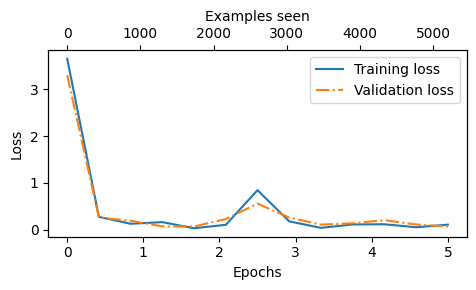

In [202]:
epochs_tensor = torch.linspace(0, num_epochs, len(train_losses))
examples_seen_tensor = torch.linspace(0, examples_seen, len(train_losses))

plot_values(epochs_tensor, examples_seen_tensor, train_losses, val_losses, label="loss")

In [203]:
train_accuracy = calc_accuracy_loader(train_loader_spam, model_spam, device)
val_accuracy = calc_accuracy_loader(val_loader_spam, model_spam, device)
test_accuracy = calc_accuracy_loader(test_loader_spam, model_spam, device)

print(f"Training accuracy: {train_accuracy*100:.2f}%")
print(f"Validation accuracy: {val_accuracy*100:.2f}%")
print(f"Test accuracy: {test_accuracy*100:.2f}%")

Training accuracy: 98.94%
Validation accuracy: 97.32%
Test accuracy: 96.00%


# Few Notes

## Learning rate warmup
- When training complex models like LLMs, implementing learning rate warmup can help stabilize the training
- In learning rate warmup, we gradually increase the learning rate from a very low value (`initial_lr`) to a user-specified maximum (`peak_lr`)
- This way, the model will start the training with small weight updates, which helps decrease the risk of large destabilizing updates during the training

In [204]:
n_epochs = 15
initial_lr = 0.0001
peak_lr = 0.01

- Typically, the number of warmup steps is between 0.1% to 20% of the total number of steps
- We can compute the increment as the difference between the `peak_lr` and `initial_lr` divided by the number of warmup steps

In [205]:
total_steps = len(train_loader) * n_epochs
warmup_steps = int(0.2 * total_steps) # 20% warmup
print(warmup_steps)

lr_increment = (peak_lr - initial_lr) / warmup_steps

global_step = -1
track_lrs = []

optimizer = torch.optim.AdamW(model_spam.parameters(), weight_decay=0.1)

for epoch in range(n_epochs):
    for input_batch, target_batch in train_loader:
        optimizer.zero_grad()
        global_step += 1
    
        if global_step < warmup_steps:
            lr = initial_lr + global_step * lr_increment
        else:
            lr = peak_lr
        
        # Apply the calculated learning rate to the optimizer
        for param_group in optimizer.param_groups:
            param_group["lr"] = lr
        track_lrs.append(optimizer.param_groups[0]["lr"])
    
        # Calculate loss and update weights
        # ...

6


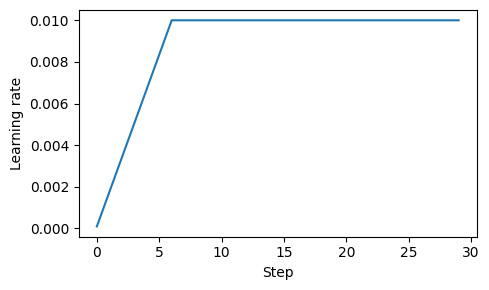

In [206]:
import matplotlib.pyplot as plt

plt.figure(figsize=(5, 3))
plt.ylabel("Learning rate")
plt.xlabel("Step")
total_training_steps = len(train_loader) * n_epochs
plt.plot(range(total_training_steps), track_lrs)
plt.tight_layout();
plt.show()

## Cosine decay
- Another popular technique for training complex deep neural networks is cosine decay, which also adjusts the learning rate across training epochs
- In cosine decay, the learning rate follows a cosine curve, decreasing from its initial value to near zero following a half-cosine cycle
- This gradual reduction is designed to slow the pace of learning as the model begins to improve its weights; it reduces the risk of overshooting minima as the training progresses,  which is crucial for stabilizing the training in its later stages
- Cosine decay is often preferred over linear decay for its smoother transition in learning rate adjustments, but linear decay is also used in practice (for example, [OLMo: Accelerating the Science of Language Models](https://arxiv.org/abs/2402.00838))

In [207]:
import math

min_lr = 0.1 * initial_lr
track_lrs = []

lr_increment = (peak_lr - initial_lr) / warmup_steps
global_step = -1

for epoch in range(n_epochs):
    for input_batch, target_batch in train_loader:
        optimizer.zero_grad()
        global_step += 1
    
        # Adjust the learning rate based on the current phase (warmup or cosine annealing)
        if global_step < warmup_steps:
            # Linear warmup
            lr = initial_lr + global_step * lr_increment  
        else:
            # Cosine annealing after warmup
            progress = ((global_step - warmup_steps) / 
                        (total_training_steps - warmup_steps))
            lr = min_lr + (peak_lr - min_lr) * 0.5 * (
                1 + math.cos(math.pi * progress))
        
        # Apply the calculated learning rate to the optimizer
        for param_group in optimizer.param_groups:
            param_group["lr"] = lr
        track_lrs.append(optimizer.param_groups[0]["lr"])
    
        # Calculate loss and update weights

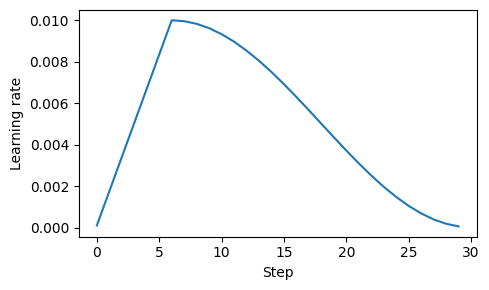

In [208]:
plt.figure(figsize=(5, 3))
plt.ylabel("Learning rate")
plt.xlabel("Step")
plt.plot(range(total_training_steps), track_lrs)
plt.tight_layout();
plt.show()

## Implementing multilayer neural networks

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/appendix-a_compressed/9.webp" width="500px">

In [209]:
class NeuralNetwork(torch.nn.Module):
    def __init__(self, num_inputs, num_outputs):
        super().__init__()

        self.layers = torch.nn.Sequential(
                
            # 1st hidden layer
            torch.nn.Linear(num_inputs, 30),
            torch.nn.ReLU(),

            # 2nd hidden layer
            torch.nn.Linear(30, 20),
            torch.nn.ReLU(),

            # output layer
            torch.nn.Linear(20, num_outputs),
        )

    def forward(self, x):
        logits = self.layers(x)
        return logits

In [210]:
model_nn = NeuralNetwork(50, 3)
model_nn

NeuralNetwork(
  (layers): Sequential(
    (0): Linear(in_features=50, out_features=30, bias=True)
    (1): ReLU()
    (2): Linear(in_features=30, out_features=20, bias=True)
    (3): ReLU()
    (4): Linear(in_features=20, out_features=3, bias=True)
  )
)

In [211]:
num_params = sum(p.numel() for p in model_nn.parameters() if p.requires_grad)
print("Total number of trainable model parameters:", num_params)

Total number of trainable model parameters: 2213


In [212]:
print(model_nn.layers[0].weight)

Parameter containing:
tensor([[ 0.0238, -0.1067,  0.1297,  ...,  0.0356, -0.0415,  0.0463],
        [-0.0124, -0.1106, -0.0546,  ..., -0.0674, -0.0186,  0.0940],
        [-0.0733,  0.1079,  0.0347,  ...,  0.1075, -0.0675,  0.0092],
        ...,
        [ 0.1408, -0.0566, -0.1382,  ...,  0.0952, -0.0828,  0.0213],
        [ 0.0305,  0.1233, -0.1276,  ..., -0.0365, -0.1124, -0.1250],
        [ 0.0873, -0.0994,  0.0607,  ...,  0.1399, -0.0579,  0.0467]],
       requires_grad=True)


## DataLoader num workers

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/appendix-a_compressed/11.webp" width="600px">

a sweet number is 4